In [1]:
pip install igraph

Note: you may need to restart the kernel to use updated packages.


In [ ]:
# use this code in the anaconda prompt, not in jupyter notebook
#conda install -c conda-forge python-annoy
#pip install bbknn

^C


In [2]:
pip install gseapy

     |████████████████████████████████| 1.5 MB 1.7 MB/s eta 0:00:01
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
     |████████████████████████████████| 964 kB 3.4 MB/s eta 0:00:01
  Using cached grequests-0.6.0-py3-none-any.whl (5.2 kB)
     |████████████████████████████████| 47 kB 5.2 MB/s eta 0:00:01
  Using cached easydev-0.12.0-py3-none-any.whl
     |████████████████████████████████| 4.6 MB 4.0 MB/s eta 0:00:01
     |████████████████████████████████| 144 kB 4.9 MB/s eta 0:00:01
  Using cached appdirs-1.4.4-py2.py3-none-any.whl (9.6 kB)
  Using cached gevent-21.12.0-cp38-cp38-macosx_10_14_x86_64.whl (1.9 MB)
  Using cached zope.interface-5.4.0-cp38-cp38-macosx_10_14_x86_64.whl (208 kB)
     |████████████████████████████████| 93 kB 2.1 MB/s eta 0:00:011
  Using cached zope.event-4.5.0-py2.py3-none-any.whl (6.8 kB)
  Using cached url_normalize-1.4.3-py2.py3-none-any.whl (6.8 kB)
  ERROR: Command errored 

Note: you may need to restart the kernel to use updated packages.


In [1]:
import bbknn

In [2]:
import pandas as pd
import scanpy as sc
import numpy as np
from numpy import linalg as la
from scipy.sparse import issparse
import loompy
import anndata
import scvelo as scv
scv.logging.print_version()

Running scvelo 0.2.5 (python 3.8.16) on 2023-05-24 11:33.


In [3]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80,dpi_save=300, facecolor='white')

scanpy==1.9.3 anndata==0.9.1 umap==0.5.3 numpy==1.23.5 scipy==1.10.1 pandas==1.3.5 scikit-learn==1.0.2 statsmodels==0.13.5 python-igraph==0.10.4 louvain==0.8.0 pynndescent==0.5.5


In [4]:
import os
os.chdir('F:/Ko/PD-1_responders')

In [5]:
import scanpy.external as sce

In [6]:
adata_d1 = anndata.read_text('PD1-D1.expression_matrix.txt.gz', delimiter=None, dtype='float32')
adata_d1

AnnData object with n_obs × n_vars = 14660 × 5351

In [7]:
adata_d1.to_df()

,CTTGCCGTCGGA,CGAGTCACACAT,GAGCGACTGGCT,CCTTCACGATTC,TACATCATATTG,GTCTAAATGCCC,AACGATCTCCAG,CATTGATCCAGT,CATTCCGTCAGG,CTGACCAGCGCC,...,CAAACGCCTCAA,CTATTGGATTGT,GCCGCGAACACA,GGCCACTTAAAG,GTATTAGTAAGG,GTCCCCGGAACA,TAGGGCCCATTA,TATCCTCTCACG,TATTAGACCAGC,TTAGATCGCCAC
SAT1,2.503166,3.848997,3.460139,3.912258,2.844834,3.602161,3.909920,2.752659,3.966013,4.191538,...,4.289671,2.905324,4.483744,4.249703,4.473410,3.564034,3.560706,4.808338,4.259973,4.482014
G0S2,2.259767,2.280726,2.797933,2.364776,1.308274,2.246005,1.591599,1.084481,2.264775,1.365075,...,5.726051,4.650401,2.918480,3.570724,2.908595,2.898817,3.956653,0.000000,0.000000,3.582547
NFKBIA,3.235632,3.118906,3.977743,3.928195,3.788647,3.158408,3.561798,2.813205,3.569978,2.277068,...,3.610140,5.052675,2.918480,4.469989,4.653828,4.643582,5.042432,4.475125,4.480288,5.169490
ARHGDIB,2.447642,2.132085,2.699321,2.364776,2.674074,2.649312,2.687207,1.927705,2.159890,1.586788,...,2.943681,3.570724,2.918480,2.905324,0.000000,2.898817,0.000000,3.575773,2.915173,0.000000
UBA52,2.111512,2.280726,1.197433,2.005225,3.230728,2.506876,2.282494,2.060853,2.600023,2.917561,...,0.000000,0.000000,0.000000,2.905324,0.000000,0.000000,2.895581,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CYP51A1P1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
RPL12P1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
AC066613.2,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
AC092809.3,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [8]:
adata_d1 = anndata.AnnData.transpose(adata_d1)

In [9]:
adata_d1.to_df()

,SAT1,G0S2,NFKBIA,ARHGDIB,UBA52,RAC1,S100A9,S100A11,PNPLA8,ATP2A3,...,VDAC1P6,RPL5P32,RPL7P26,RPS27P21,ABHD17AP4,CYP51A1P1,RPL12P1,AC066613.2,AC092809.3,AC097523.1
CTTGCCGTCGGA,2.503166,2.259767,3.235632,2.447642,2.111512,0.506857,4.463706,2.698766,0.000000,0.000000,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
CGAGTCACACAT,3.848997,2.280726,3.118906,2.132085,2.280726,1.857142,5.303305,3.231765,0.516216,0.516216,...,0.0,0.0,0.516216,0.0,0.0,0.0,0.0,0.0,0.0,0.0
GAGCGACTGGCT,3.460139,2.797933,3.977743,2.699321,1.197433,2.163938,5.437422,2.970047,1.579530,0.571282,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
CCTTCACGATTC,3.912258,2.364776,3.928195,2.364776,2.005225,0.589713,5.365601,3.223032,1.226833,0.000000,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
TACATCATATTG,2.844834,1.308274,3.788647,2.674074,3.230728,1.704683,4.707647,3.156924,0.641816,0.000000,...,0.0,0.0,0.641816,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GTCCCCGGAACA,3.564034,2.898817,4.643582,2.898817,0.000000,0.000000,5.889448,3.564034,0.000000,0.000000,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
TAGGGCCCATTA,3.560706,3.956653,5.042432,0.000000,2.895581,0.000000,5.408168,2.895581,0.000000,0.000000,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
TATCCTCTCACG,4.808338,0.000000,4.475125,3.575773,0.000000,0.000000,5.747799,2.910235,0.000000,0.000000,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
TATTAGACCAGC,4.259973,0.000000,4.480288,2.915173,0.000000,0.000000,4.660719,2.915173,0.000000,0.000000,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [10]:
adata_d2 = anndata.read_text('PD1-D2.expression_matrix.txt.gz', delimiter=None, dtype='float32')
adata_d2

AnnData object with n_obs × n_vars = 15901 × 6364

In [11]:
adata_d2.to_df()

,CAATCTATTCTC,CCGTCATACTAC,TCACCGCACCAC,AGTCTTACGATT,TTCCCGAAGCTT,TGCGAGTTCCTG,ACCACTTCAACG,CCTATGTCATTA,CGCATCGTCTAT,GCACTAAGACTT,...,TTCACGGTTGGG,AATTCGTTTCTC,ACCACAAGCACG,ATTCCAGAAGAT,CAAATAGAGGGA,CCAACATAGTGA,CTGCCCACCTCA,CTGGTGGCGGAA,GGCGCCCATTCA,GGTAACGCTGTC
HLA-A,3.185823,3.112112,2.584904,2.474102,2.491155,2.942675,2.553551,1.989282,2.512760,2.862727,...,0.000000,0.000000,3.507431,0.000000,3.904442,2.812377,3.490322,2.828707,3.467481,3.496508
PLCG2,0.000000,0.429644,1.441456,0.518461,0.000000,0.000000,0.648015,0.000000,0.665217,0.000000,...,2.825716,0.000000,0.000000,0.000000,0.000000,0.000000,2.827210,2.828707,0.000000,0.000000
HLA-B,4.068017,3.652469,4.067965,3.062606,3.610768,4.490873,4.290839,3.267329,3.836345,4.232238,...,2.825716,3.906031,5.427314,3.896534,3.904442,4.372573,4.388149,4.169672,3.467481,4.574711
LYZ,5.520401,5.004834,4.902244,2.474102,1.326758,4.969226,5.553392,4.292068,3.728850,5.415174,...,3.488782,3.906031,2.843817,3.896534,2.845343,0.000000,4.568398,2.828707,4.545077,2.833213
MT-RNR2,4.927364,4.650002,4.930608,4.995583,4.584030,5.096907,4.820970,4.667881,4.350766,5.128973,...,6.134087,6.085209,5.922029,4.399201,6.253133,5.971865,5.409749,5.661655,4.364877,4.174387
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
FAM227A,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
RPL13AP3,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
AF279873.2,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
RPL17P26,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [12]:
adata_d2 = anndata.AnnData.transpose(adata_d2)

In [13]:
adata_d2.to_df()

,HLA-A,PLCG2,HLA-B,LYZ,MT-RNR2,LGALS8,HBA2,SPATA5,ZNF106,DOCK5,...,RPL34P3,COL1A1,AC091180.5,EEF1A1P38,NCLP1,FAM227A,RPL13AP3,AF279873.2,RPL17P26,AL078595.1
CAATCTATTCTC,3.185823,0.000000,4.068017,5.520401,4.927364,0.423293,2.723169,0.0,2.399044,1.425969,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
CCGTCATACTAC,3.112112,0.429644,3.652469,5.004834,4.650002,0.000000,3.011684,0.0,1.146400,1.146400,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
TCACCGCACCAC,2.584904,1.441456,4.067965,4.902244,4.930608,0.497965,2.802685,0.0,1.583549,0.497965,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
AGTCTTACGATT,2.474102,0.518461,3.062606,2.474102,4.995583,0.000000,3.062606,0.0,0.518461,0.518461,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
TTCCCGAAGCTT,2.491155,0.000000,3.610768,1.326758,4.584030,0.000000,7.599555,0.0,0.653853,1.045869,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CCAACATAGTGA,2.812377,0.000000,4.372573,0.000000,5.971865,0.000000,3.870125,0.0,0.000000,2.812377,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
CTGCCCACCTCA,3.490322,2.827210,4.388149,4.568398,5.409749,0.000000,2.827210,0.0,2.827210,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
CTGGTGGCGGAA,2.828707,2.828707,4.169672,2.828707,5.661655,0.000000,2.828707,0.0,2.828707,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
GGCGCCCATTCA,3.467481,0.000000,3.467481,4.545077,4.364877,0.000000,5.051646,0.0,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [14]:
adata_s1 = anndata.read_text('PD1-S1.expression_matrix.txt.gz', delimiter=None, dtype='float32')
adata_s1

AnnData object with n_obs × n_vars = 16577 × 5162

In [15]:
adata_s1.to_df()

,GCGGCCATAACT,GTTAGCCGAGCA,AGCATCAGTCGT,GGCCCCGGCACA,TCTGGCCTGATT,GACCAGTCACAC,CTTTCGCTGCAT,CTCTCTTCATGA,GGCGACAGGGAT,AACCCGACCTGA,...,GCGTCCCTGAGT,TCATTGACGGGC,CAACTGGAAGTA,CAAGGCCATCGC,CCAGGCTAACTT,CTCTAGACGTTT,GCGCTAATGGCG,TCCCGGGGTCAG,CGATCCGTTGTG,GATCTGTCGCGC
RPS19,3.259283,3.462391,3.602449,3.660903,3.359546,3.763062,3.471340,3.203846,3.696723,2.805434,...,2.525269,4.233384,2.519998,3.162282,0.000000,3.846289,4.051736,4.052847,0.000000,0.000000
S100A4,3.819370,4.103959,4.034500,3.911500,3.103480,4.041251,3.784830,3.849658,3.573763,3.283362,...,0.000000,4.233384,3.844050,3.553536,2.509553,3.174276,3.832931,2.510592,2.513716,3.838474
EIF2A,0.522227,0.743520,0.448828,0.459336,0.464351,0.000000,1.054587,1.433380,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
B4GALT5,0.707378,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.493824,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,2.509553,0.000000,2.509553,0.000000,0.000000,0.000000
MT-RNR2,4.237504,4.516041,3.632863,4.130634,4.547277,3.791803,3.929622,4.360125,4.042593,4.217517,...,5.219859,4.053959,5.331337,2.510592,5.473481,3.174276,4.515196,4.737269,5.611001,5.379478
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
HLTF-AS1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
KLRC3,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
SRRM5,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
CR391992.1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [16]:
adata_s1 = anndata.AnnData.transpose(adata_s1)

In [17]:
adata_s1.to_df()

,RPS19,S100A4,EIF2A,B4GALT5,MT-RNR2,MALAT1,FTL,MT-ND1,B2M,MT-CYB,...,CIRBP-AS1,RSPH10B,MTATP8P1,GTF2IRD2P1,CCT6P2,HLTF-AS1,KLRC3,SRRM5,CR391992.1,NTS
GCGGCCATAACT,3.259283,3.819370,0.522227,0.707378,4.237504,5.530766,4.354232,3.439590,5.084331,3.285286,...,0.0,0.0,0.0,0.0,0.294823,0.0,0.0,0.0,0.0,0.0
GTTAGCCGAGCA,3.462391,4.103959,0.743520,0.000000,4.516041,5.403654,4.829307,3.444942,5.057014,3.162017,...,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0
AGCATCAGTCGT,3.602449,4.034500,0.448828,0.000000,3.632863,5.010523,4.851175,3.470605,5.010523,3.705081,...,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0
GGCCCCGGCACA,3.660903,3.911500,0.459336,0.000000,4.130634,5.308974,4.392893,3.614893,4.570741,3.838931,...,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0
TCTGGCCTGATT,3.359546,3.103480,0.464351,0.000000,4.547277,4.207523,3.379876,3.773925,4.676343,4.014043,...,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CTCTAGACGTTT,3.846289,3.174276,0.000000,0.000000,3.174276,6.024346,2.522102,3.174276,5.773722,4.065152,...,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0
GCGCTAATGGCG,4.051736,3.832931,0.000000,2.509553,4.515196,6.297796,3.552438,3.552438,5.473481,4.383226,...,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0
TCCCGGGGTCAG,4.052847,2.510592,0.000000,0.000000,4.737269,6.165656,4.052847,3.162282,5.139810,2.510592,...,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0
CGATCCGTTGTG,0.000000,2.513716,0.000000,0.000000,5.611001,6.015246,4.921504,2.513716,5.324537,2.513716,...,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0


In [18]:
adata_s2 = anndata.read_text('PD1-S2.expression_matrix.txt.gz', delimiter=None, dtype='float32')
adata_s2

AnnData object with n_obs × n_vars = 13982 × 4391

In [19]:
adata_s2.to_df()

,CCGTTAGAACTC,AAGGAATGGGAA,CCTTACTCCGTT,AGATTCCGAAGA,ACTGTATCTAAT,CCGAATAGAGTC,AGAGGCTGCACA,GGTCTCCAGACG,GTTTGAGCGAGC,GGGTGTACGTAA,...,AATAAGGCTAGC,CGTTCTGCAAAT,TACCGGCCTTGG,AAAGCGATTGCC,ACTCCAAGCTAG,ATGGTATGATAA,GCTGGGACTGCT,GTTGACTGCTCG,TAGAAGGTCTGC,TAGCGTTATGGT
HBA2,2.930993,2.699493,7.300694,7.685555,3.073552,2.298980,2.885575,2.961255,3.119644,2.846998,...,0.000000,4.270931,3.204398,0.000000,0.000000,3.858701,3.220413,3.215809,3.206669,4.268613
MCTP1,0.000000,0.000000,0.000000,0.000000,0.794284,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
YTHDC1,1.375664,0.654829,0.767235,0.000000,1.534406,1.577270,0.000000,1.594565,0.000000,1.309951,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.215809,3.206669,3.197619
HBB,3.031004,2.413495,7.056667,7.604440,3.276011,3.416191,2.885575,3.146236,3.510276,2.922568,...,3.865539,0.000000,3.204398,3.213516,0.000000,0.000000,3.220413,4.287308,0.000000,4.552789
RPL28,0.686073,2.566684,2.205701,2.271807,2.819421,3.328342,2.955688,2.020706,2.800687,2.470129,...,0.000000,0.000000,3.877045,3.213516,3.229691,0.000000,0.000000,3.215809,4.277916,3.197619
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
RPL12P12,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
AC133435.1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
RPL12P33,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
AL354861.1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [20]:
adata_s2 = anndata.AnnData.transpose(adata_s2)

In [21]:
adata_s2.to_df()

,HBA2,MCTP1,YTHDC1,HBB,RPL28,NEAT1,MT-RNR1,RSRP1,CSTF1,MALAT1,...,AC009088.2,AL008726.1,SRP9P1,ELOCP2,SIK1B,RPL12P12,AC133435.1,RPL12P33,AL354861.1,EEF1B2P2
CCGTTAGAACTC,2.930993,0.000000,1.375664,3.031004,0.686073,0.686073,1.933752,1.375664,0.0,5.546538,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
AAGGAATGGGAA,2.699493,0.000000,0.654829,2.413495,2.566684,1.547403,3.966313,2.011389,0.0,5.040317,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
CCTTACTCCGTT,7.300694,0.000000,0.767235,7.056667,2.205701,1.912355,3.080461,0.767235,0.0,5.836346,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
AGATTCCGAAGA,7.685555,0.000000,0.000000,7.604440,2.271807,1.676808,2.109901,0.000000,0.0,5.244036,...,0.895878,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
ACTGTATCTAAT,3.073552,0.794284,1.534406,3.276011,2.819421,0.794284,3.179897,0.000000,0.0,6.493442,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ATGGTATGATAA,3.858701,0.000000,0.000000,0.000000,0.000000,3.186429,3.858701,0.000000,0.0,6.546865,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
GCTGGGACTGCT,3.220413,0.000000,0.000000,3.220413,0.000000,3.220413,3.220413,0.000000,0.0,6.707238,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
GTTGACTGCTCG,3.215809,0.000000,3.215809,4.287308,3.215809,5.259512,0.000000,0.000000,0.0,7.438128,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
TAGAAGGTCTGC,3.206669,0.000000,3.206669,0.000000,4.277916,0.000000,3.206669,0.000000,0.0,6.163175,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [22]:
adata_s3 = anndata.read_text('PD1-S3.expression_matrix.txt.gz', delimiter=None, dtype='float32')
adata_s3

AnnData object with n_obs × n_vars = 17309 × 4033

In [23]:
adata_s3.to_df()

,TGGAGTGCAGTC,TCCTCCCTCTAA,TTGTTCTGGGCC,CCAGACATCATA,GTCGCAGGTCCT,TGCCGACTTTTG,GACTGCGCGGCC,ACGGTGCTCGCA,CCATTCCAGAGT,GTGCCGCAAACT,...,CGATCCTACGTC,AGCACATTGAAT,GCAAGACGGCAC,TAACGAATCCTG,TTTGTGGCATGC,AAAGCTGCGCGC,GCTCACGGCAGG,GTAAATTAGCCA,TCCCCCGTAAAA,TTGCCTTCGAAT
RPS12,2.104436,2.824538,2.519959,2.339520,2.325428,3.127029,2.093007,2.723366,2.714194,2.715142,...,0.000000,0.000000,0.000000,2.351918,0.000000,2.361434,2.361434,3.669720,0.000000,2.357095
OSBPL9,0.613752,0.348675,0.000000,0.638151,1.045989,0.000000,0.436231,0.423366,0.754899,0.990586,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
PNRC1,0.991287,2.278390,0.613306,1.302622,1.442407,2.032958,1.317569,1.991308,1.598556,2.553319,...,3.383135,3.673454,2.354503,0.000000,0.000000,2.361434,0.000000,0.000000,2.365796,2.357095
MAP10,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
TMSB4X,3.789061,4.246150,3.575361,4.205890,3.706069,4.552414,3.776331,4.314724,3.793346,4.179403,...,2.994498,4.470179,4.827734,4.659306,3.662296,4.223075,4.835329,4.066654,3.679083,4.664971
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
IGLV8-61,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
H3F3AP3,0.353242,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
AL669831.3,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
TRBV7-2,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [24]:
adata_s3 = anndata.AnnData.transpose(adata_s3)

In [25]:
adata_s3.to_df()

,RPS12,OSBPL9,PNRC1,MAP10,TMSB4X,PTPRC,ATP6V0E1,NAB1,FTH1,TMPO,...,AL354872.1,SUMO2P1,ERP29P1,PLGLB1,CCDC75P1,IGLV8-61,H3F3AP3,AL669831.3,TRBV7-2,AC015849.6
TGGAGTGCAGTC,2.104436,0.613752,0.991287,0.0,3.789061,1.995397,1.137312,0.000000,2.734689,1.805679,...,0.0,0.353242,0.000000,0.0,0.0,0.0,0.353242,0.0,0.0,0.0
TCCTCCCTCTAA,2.824538,0.348675,2.278390,0.0,4.246150,2.941228,1.366173,0.348675,4.228066,0.348675,...,0.0,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0
TTGTTCTGGGCC,2.519959,0.000000,0.613306,0.0,3.575361,1.935236,0.000000,0.352952,3.117347,1.872173,...,0.0,0.352952,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0
CCAGACATCATA,2.339520,0.638151,1.302622,0.0,4.205890,1.417168,1.302622,0.000000,3.090358,1.776878,...,0.0,0.000000,0.369139,0.0,0.0,0.0,0.000000,0.0,0.0,0.0
GTCGCAGGTCCT,2.325428,1.045989,1.442407,0.0,3.706069,2.786938,1.045989,0.653941,3.659639,0.379499,...,0.0,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
AAAGCTGCGCGC,2.361434,0.000000,2.361434,0.0,4.223075,0.000000,0.000000,0.000000,3.395127,0.000000,...,0.0,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0
GCTCACGGCAGG,2.361434,0.000000,0.000000,0.0,4.835329,3.006291,0.000000,0.000000,2.361434,0.000000,...,0.0,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0
GTAAATTAGCCA,3.669720,0.000000,0.000000,0.0,4.066654,3.001737,0.000000,0.000000,3.001737,0.000000,...,0.0,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0
TCCCCCGTAAAA,0.000000,0.000000,2.365796,0.0,3.679083,2.365796,0.000000,0.000000,4.076097,0.000000,...,0.0,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0


In [26]:
adata_d3 = anndata.read_text('ESCC-D2.expression_matrix.txt.gz', delimiter=None, dtype='float32')
adata_d3

AnnData object with n_obs × n_vars = 12706 × 3767

In [27]:
adata_d3.to_df()

,TCTCGCTGGGCA,CCCTAATACACA,TGTAAGAACAAC,ATATGTTTAGGT,GCTAATTGGACC,GCCTACGCAGCC,AGAGTGAGTAGA,CACCCGTTGCCG,CATGAATTTAGT,TCTCCTCAATTC,...,CTACGCCGGTCC,CTTCGTGGATAG,TAGACAAGCTTC,TGGCTTTCAAAG,TTGACTTTAGAA,ATTTCTTCTGAA,CCCACCAAGCAA,CCTGAACGTGGC,CGGGTTTCCCGC,TCAAACACGGGG
MT-ND5,3.553347,3.475215,3.212842,4.105968,4.151202,3.471627,3.790183,3.305565,3.658196,2.141170,...,0.000000,4.430669,0.000000,4.414405,0.000000,3.664146,3.709678,3.733287,3.667859,3.812154
PTPRE,0.000000,1.559528,0.000000,1.382556,0.000000,2.174442,1.087406,1.159602,2.240504,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
RPS11,2.785629,2.399488,3.212842,2.857499,2.025517,3.409158,3.647140,2.648440,2.240504,3.584735,...,0.000000,0.000000,0.000000,0.000000,0.000000,4.344398,0.000000,0.000000,0.000000,0.000000
MT-CO3,3.816834,4.744492,4.765946,4.700073,4.012506,4.463261,4.656131,4.058808,4.310572,4.026580,...,4.472554,4.430669,3.709678,5.323408,4.374893,3.664146,4.390507,3.733287,4.348158,3.812154
PPP6C,0.000000,0.000000,0.876684,0.913301,0.000000,0.000000,0.000000,0.000000,0.000000,1.253657,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
AC091685.2,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
PTPN2P2,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
SUB1P1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
AL353637.1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [28]:
adata_d3 = anndata.AnnData.transpose(adata_d3)

In [29]:
adata_d3.to_df()

,MT-ND5,PTPRE,RPS11,MT-CO3,PPP6C,RPLP1,RPS4X,BIN1,LYZ,MT-RNR2,...,CTAGE11P,MTCO3P31,AL139156.2,ENSG00000274452,PSMA6P2,AC091685.2,PTPN2P2,SUB1P1,AL353637.1,AL353726.1
TCTCGCTGGGCA,3.553347,0.000000,2.785629,3.816834,0.000000,4.359526,2.081939,0.0,5.075924,5.000047,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
CCCTAATACACA,3.475215,1.559528,2.399488,4.744492,0.000000,4.210143,1.559528,0.0,5.815130,4.876935,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
TGTAAGAACAAC,3.212842,0.000000,3.212842,4.765946,0.876684,4.069363,2.503348,0.0,1.650341,5.340571,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
ATATGTTTAGGT,4.105968,1.382556,2.857499,4.700073,0.913301,3.917085,2.437794,0.0,5.435285,5.764910,...,0.913301,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
GCTAATTGGACC,4.151202,0.000000,2.025517,4.012506,0.000000,4.295656,1.780871,0.0,5.058001,5.036860,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ATTTCTTCTGAA,3.664146,0.000000,4.344398,3.664146,0.000000,4.344398,0.000000,0.0,5.252871,5.031034,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
CCCACCAAGCAA,3.709678,0.000000,0.000000,4.390507,0.000000,5.299333,4.390507,0.0,0.000000,5.077437,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
CCTGAACGTGGC,3.733287,0.000000,0.000000,3.733287,0.000000,0.000000,0.000000,0.0,0.000000,5.504917,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
CGGGTTTCCCGC,3.667859,0.000000,0.000000,4.348158,0.000000,4.348158,0.000000,0.0,5.438113,5.724707,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [30]:
adata_d1.var

""
SAT1
G0S2
NFKBIA
ARHGDIB
UBA52
...
CYP51A1P1
RPL12P1
AC066613.2
AC092809.3


In [31]:
adata_d1

AnnData object with n_obs × n_vars = 5351 × 14660

In [32]:
adata_d1.var_names_make_unique()
adata_d2.var_names_make_unique()
adata_d3.var_names_make_unique()
adata_s1.var_names_make_unique()
adata_s2.var_names_make_unique()
adata_s3.var_names_make_unique()

In [33]:
adata_d1.var['gene_ids'] = adata_d1.var_names
adata_d2.var['gene_ids'] = adata_d2.var_names
adata_d3.var['gene_ids'] = adata_d3.var_names
adata_s1.var['gene_ids'] = adata_s1.var_names
adata_s2.var['gene_ids'] = adata_s2.var_names
adata_s3.var['gene_ids'] = adata_s3.var_names


In [34]:
adata_d1

AnnData object with n_obs × n_vars = 5351 × 14660
    var: 'gene_ids'

In [35]:
adata_d1.var

,gene_ids
SAT1,SAT1
G0S2,G0S2
NFKBIA,NFKBIA
ARHGDIB,ARHGDIB
UBA52,UBA52
...,...
CYP51A1P1,CYP51A1P1
RPL12P1,RPL12P1
AC066613.2,AC066613.2
AC092809.3,AC092809.3


In [36]:
#adata_pd1_d1.var['gene_ids'] = adata_pd1_d1.var
#adata_pd1_d2.var['gene_ids'] = adata_pd1_d2.var
#adata_pd1_s1.var['gene_ids'] = adata_pd1_s1.var
#adata_pd1_s2.var['gene_ids'] = adata_pd1_s2.var
#adata_pd1_s3.var['gene_ids'] = adata_pd1_s3.var
#adata_ESCC_d1.var['gene_ids'] = adata_ESCC_d1_1.var

normalizing counts per cell
    finished (0:00:00)


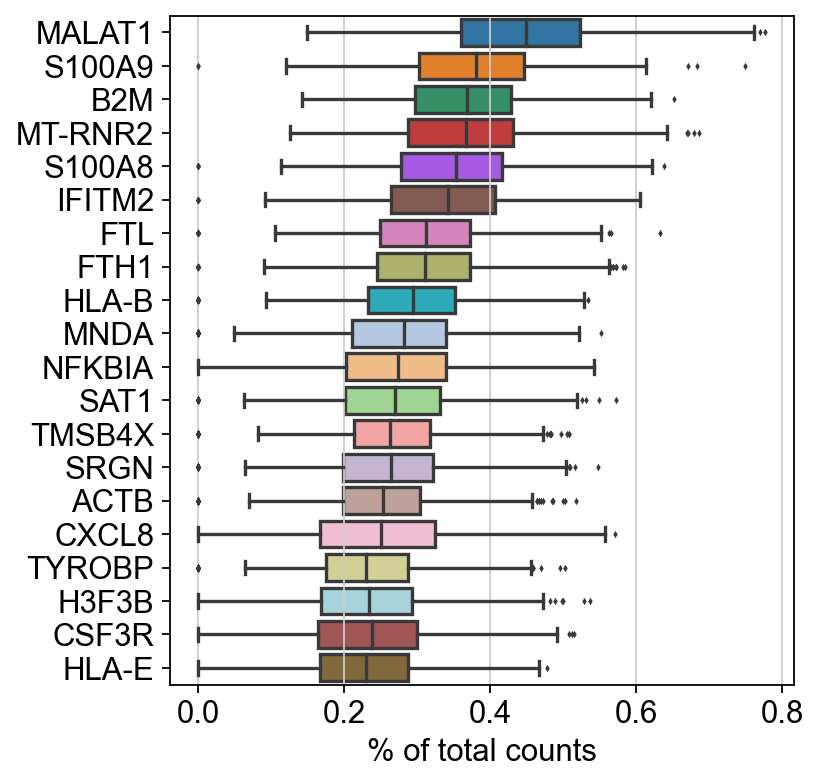

In [37]:
sc.pl.highest_expr_genes(adata_d1, n_top=20, )

In [38]:
adata_d1

AnnData object with n_obs × n_vars = 5351 × 14660
    var: 'gene_ids'

In [39]:
sc.pp.filter_cells(adata_d1, min_genes=200)
sc.pp.filter_genes(adata_d1, min_cells=3)

sc.pp.filter_cells(adata_d2, min_genes=200)
sc.pp.filter_genes(adata_d2, min_cells=3)

sc.pp.filter_cells(adata_d3, min_genes=200)
sc.pp.filter_genes(adata_d3, min_cells=3)


sc.pp.filter_cells(adata_s1, min_genes=200)
sc.pp.filter_genes(adata_s1, min_cells=3)

sc.pp.filter_cells(adata_s2, min_genes=200)
sc.pp.filter_genes(adata_s2, min_cells=3)

sc.pp.filter_cells(adata_s3, min_genes=200)
sc.pp.filter_genes(adata_s3, min_cells=3)

filtered out 54 cells that have less than 200 genes expressed
filtered out 392 cells that have less than 200 genes expressed
filtered out 1 genes that are detected in less than 3 cells
filtered out 6 cells that have less than 200 genes expressed
filtered out 61 cells that have less than 200 genes expressed
filtered out 25 cells that have less than 200 genes expressed


In [40]:
adata_d1.var['mt'] = adata_d1.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata_d1, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)
adata_d2.var['mt'] = adata_d2.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata_d2, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)
adata_d3.var['mt'] = adata_d3.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata_d3, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)
adata_s1.var['mt'] = adata_s1.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata_s1, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)
adata_s2.var['mt'] = adata_s2.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata_s2, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)
adata_s3.var['mt'] = adata_s3.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata_s3, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

In [41]:
sc.pp.normalize_total(adata_d1)
sc.pp.normalize_total(adata_d2)
sc.pp.normalize_total(adata_d3)
sc.pp.normalize_total(adata_s1)
sc.pp.normalize_total(adata_s2)
sc.pp.normalize_total(adata_s3)

# already logged vlues
#sc.pp.log1p(adata_pd1_d1)

normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)


In [42]:
adata_d1

AnnData object with n_obs × n_vars = 5351 × 14660
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

In [43]:
adata_d1.obs

,n_genes,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt
CTTGCCGTCGGA,3741,3741,3360.646729,44.863873,1.334977
CGAGTCACACAT,3563,3563,3402.571045,56.462261,1.659400
GAGCGACTGGCT,3339,3339,3401.329102,52.447132,1.541960
CCTTCACGATTC,3410,3410,3446.554199,49.902946,1.447908
TACATCATATTG,3188,3188,3365.079346,50.517418,1.501225
...,...,...,...,...,...
GTCCCCGGAACA,360,360,1126.969849,33.035980,2.931399
TAGGGCCCATTA,368,368,1144.256226,25.455864,2.224665
TATCCTCTCACG,344,344,1081.942627,18.805998,1.738170
TATTAGACCAGC,305,305,968.649170,23.485634,2.424576


In [44]:
adata_d1.var['gene_ids']

SAT1                SAT1
G0S2                G0S2
NFKBIA            NFKBIA
ARHGDIB          ARHGDIB
UBA52              UBA52
                 ...    
CYP51A1P1      CYP51A1P1
RPL12P1          RPL12P1
AC066613.2    AC066613.2
AC092809.3    AC092809.3
AC097523.1    AC097523.1
Name: gene_ids, Length: 14660, dtype: object

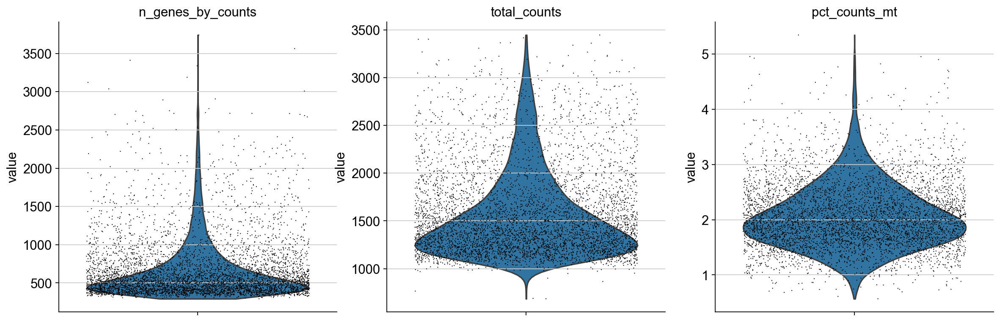

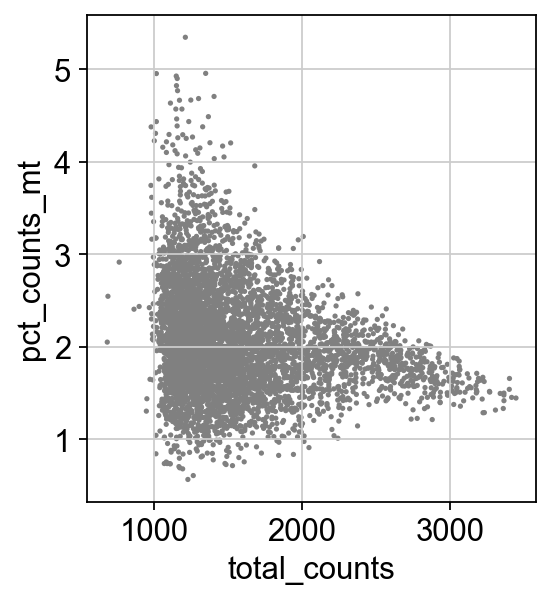

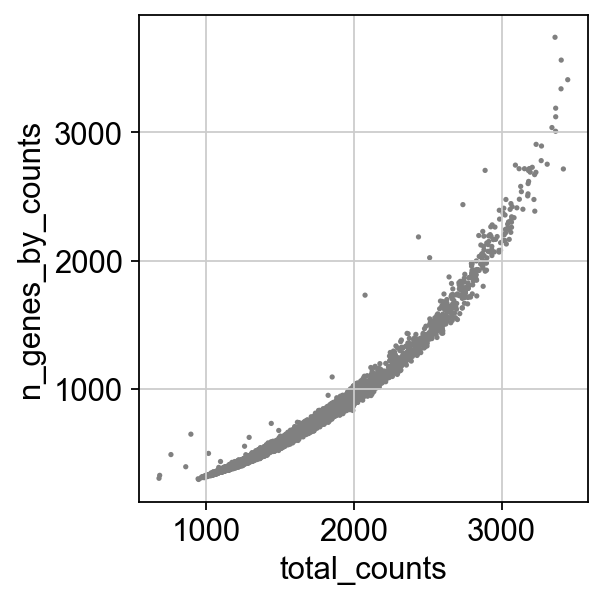

In [45]:
sc.pl.violin(adata_d1, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True)
sc.pl.scatter(adata_d1, x='total_counts', y='pct_counts_mt')
sc.pl.scatter(adata_d1, x='total_counts', y='n_genes_by_counts')

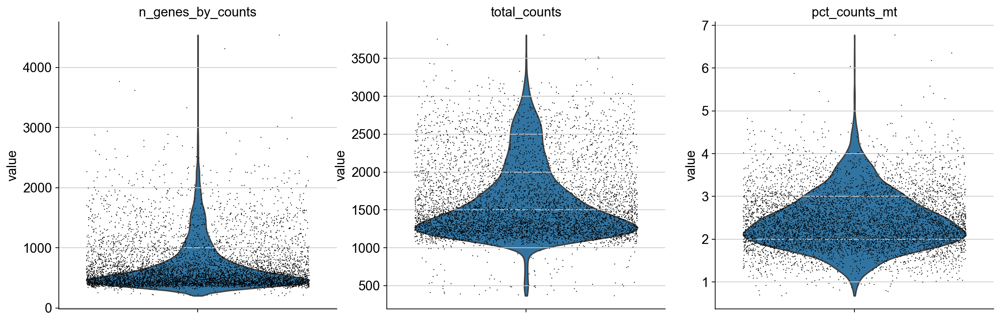

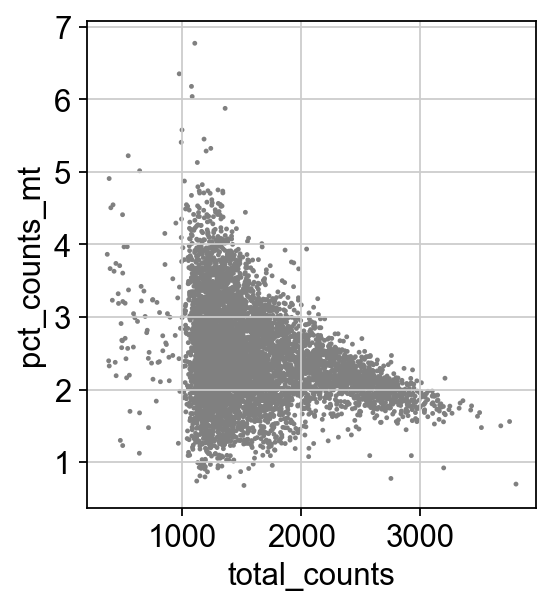

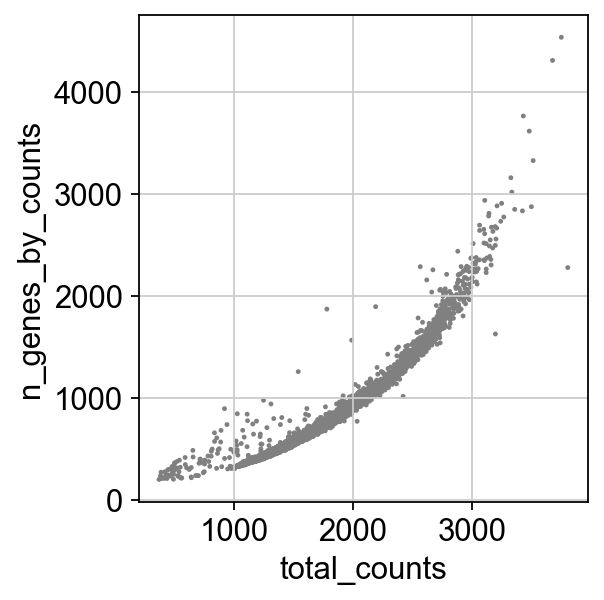

In [46]:
sc.pl.violin(adata_d2, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True)
sc.pl.scatter(adata_d2, x='total_counts', y='pct_counts_mt')
sc.pl.scatter(adata_d2, x='total_counts', y='n_genes_by_counts')

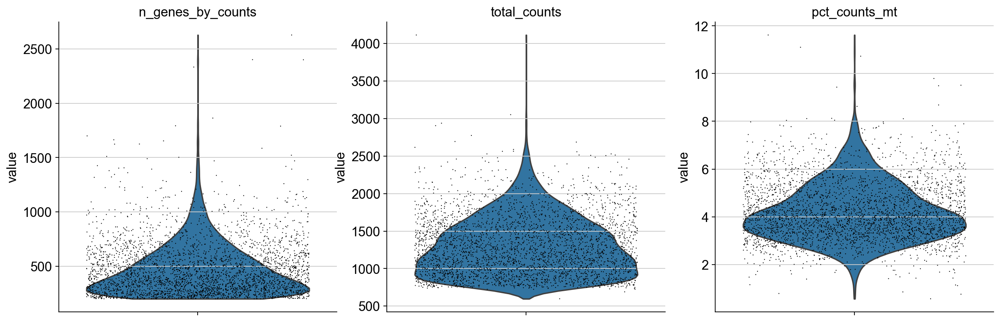

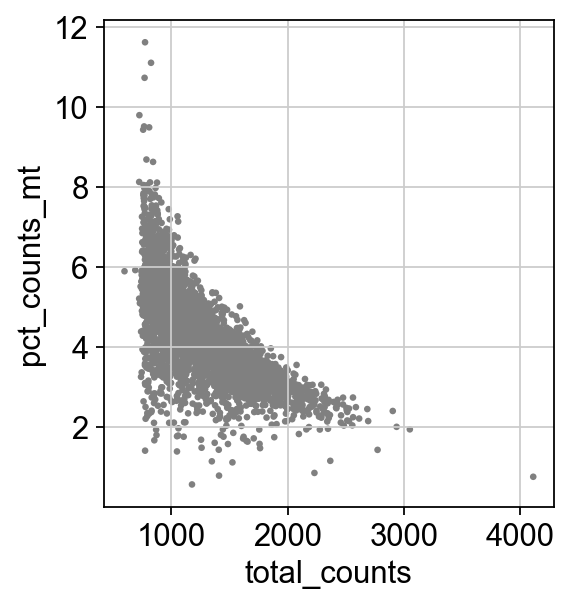

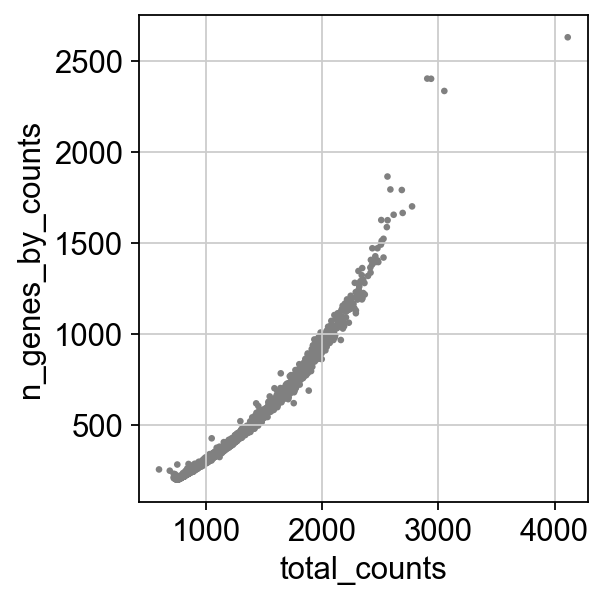

In [47]:
sc.pl.violin(adata_d3, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True)
sc.pl.scatter(adata_d3, x='total_counts', y='pct_counts_mt')
sc.pl.scatter(adata_d3, x='total_counts', y='n_genes_by_counts')

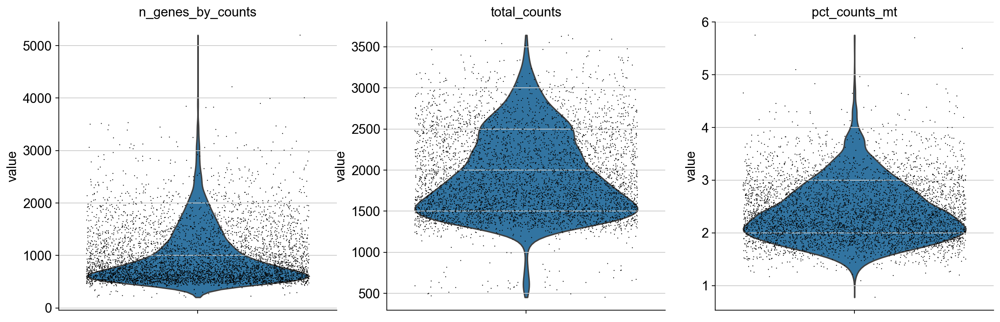

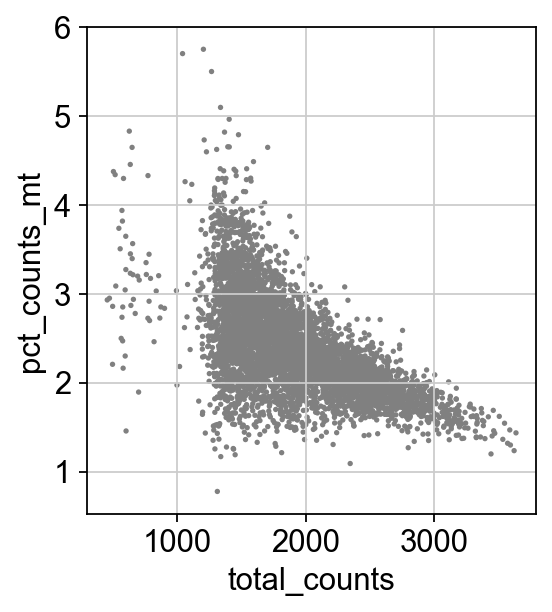

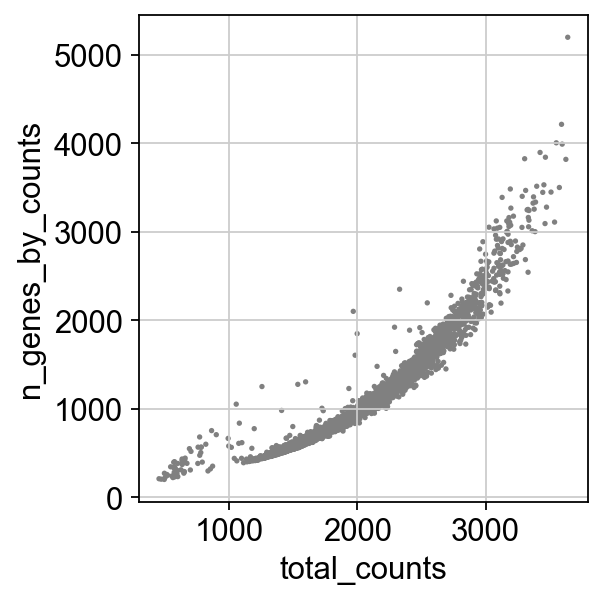

In [48]:
sc.pl.violin(adata_s1, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True)
sc.pl.scatter(adata_s1, x='total_counts', y='pct_counts_mt')
sc.pl.scatter(adata_s1, x='total_counts', y='n_genes_by_counts')

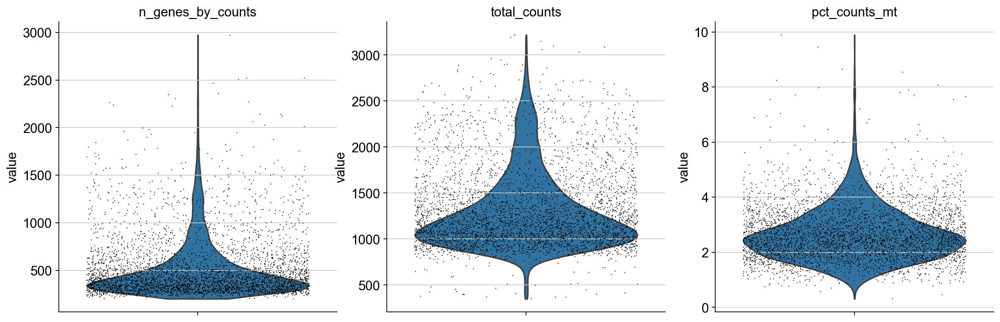

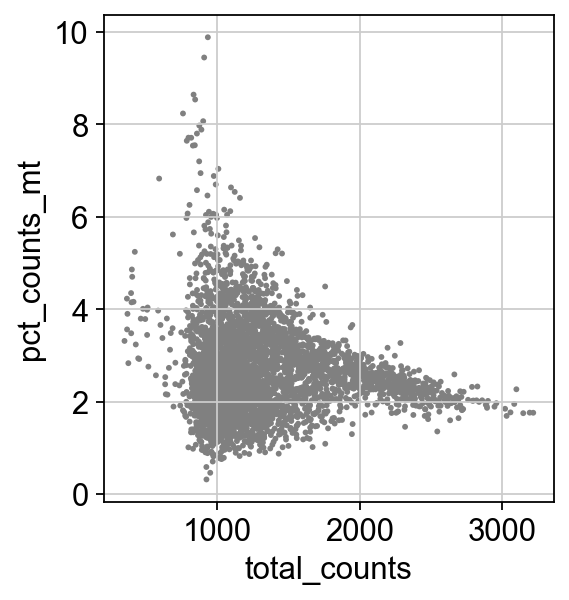

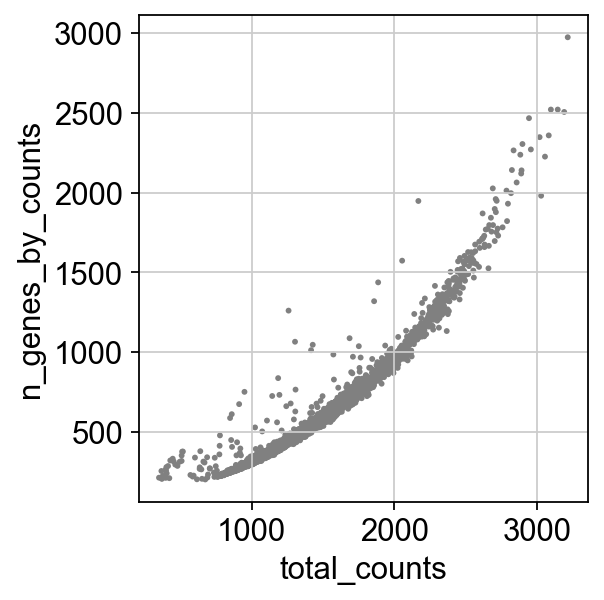

In [49]:
sc.pl.violin(adata_s2, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True)
sc.pl.scatter(adata_s2, x='total_counts', y='pct_counts_mt')
sc.pl.scatter(adata_s2, x='total_counts', y='n_genes_by_counts')

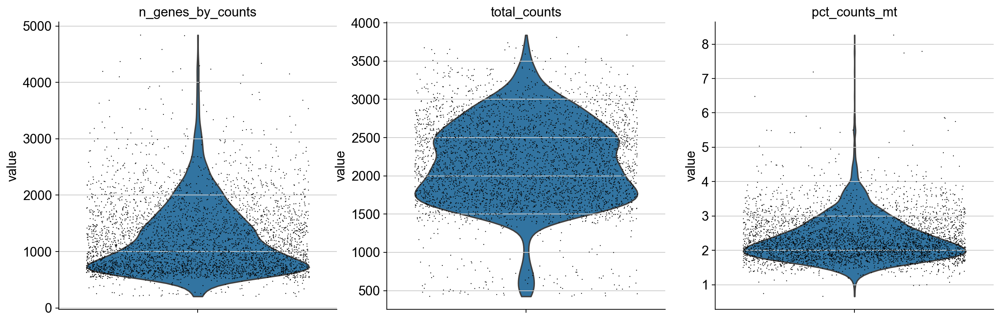

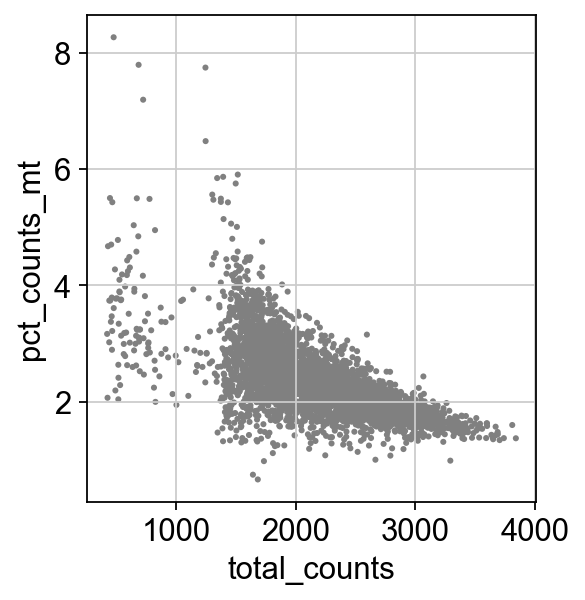

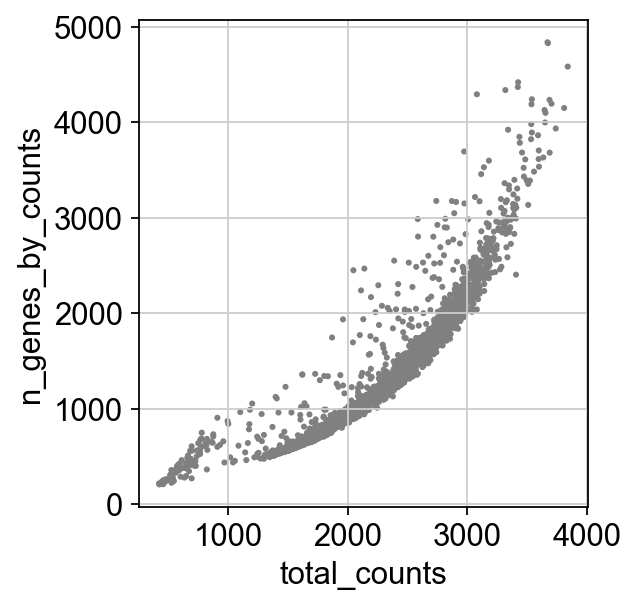

In [50]:
sc.pl.violin(adata_s3, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True)
sc.pl.scatter(adata_s3, x='total_counts', y='pct_counts_mt')
sc.pl.scatter(adata_s3, x='total_counts', y='n_genes_by_counts')

In [51]:
adata_d1 = adata_d1[adata_d1.obs.n_genes_by_counts < 8000, :]
adata_d1 = adata_d1[adata_d1.obs.pct_counts_mt < 20, :]
adata_d2 = adata_d2[adata_d2.obs.n_genes_by_counts < 8000, :]
adata_d2 = adata_d2[adata_d2.obs.pct_counts_mt < 20, :]


adata_d3 = adata_d3[adata_d3.obs.n_genes_by_counts < 8000, :]
adata_d3 = adata_d3[adata_d3.obs.pct_counts_mt < 20, :]
adata_s1 = adata_s1[adata_s1.obs.n_genes_by_counts < 8000, :]
adata_s1 = adata_s1[adata_s1.obs.pct_counts_mt < 20, :]
adata_s2 = adata_s2[adata_s2.obs.n_genes_by_counts < 8000, :]
adata_s2 = adata_s2[adata_s2.obs.pct_counts_mt < 20, :]


adata_s3 = adata_s3[adata_s3.obs.n_genes_by_counts < 8000, :]
adata_s3 = adata_s3[adata_s3.obs.pct_counts_mt < 20, :]



In [52]:
# do it after concatenate
#sc.pp.highly_variable_genes(adata_2, min_mean=0.0125, max_mean=3, min_disp=0.5)
#sc.pp.highly_variable_genes(adata_3, min_mean=0.0125, max_mean=3, min_disp=0.5)
#sc.pp.highly_variable_genes(adata_4, min_mean=0.0125, max_mean=3, min_disp=0.5)
#sc.pp.highly_variable_genes(adata_5, min_mean=0.0125, max_mean=3, min_disp=0.5)
#sc.pp.highly_variable_genes(adata_6, min_mean=0.0125, max_mean=3, min_disp=0.5)
#sc.pp.highly_variable_genes(adata_7, min_mean=0.0125, max_mean=3, min_disp=0.5)
#sc.pp.highly_variable_genes(adata_8, min_mean=0.0125, max_mean=3, min_disp=0.5)
#sc.pp.highly_variable_genes(adata_9, min_mean=0.0125, max_mean=3, min_disp=0.5)
#sc.pp.highly_variable_genes(adata_10, min_mean=0.0125, max_mean=3, min_disp=0.5)

#sc.pp.highly_variable_genes(adata_11, min_mean=0.0125, max_mean=3, min_disp=0.5)
#sc.pp.highly_variable_genes(adata_12, min_mean=0.0125, max_mean=3, min_disp=0.5)
#sc.pp.highly_variable_genes(adata_13, min_mean=0.0125, max_mean=3, min_disp=0.5)
#sc.pp.highly_variable_genes(adata_14, min_mean=0.0125, max_mean=3, min_disp=0.5)
#sc.pp.highly_variable_genes(adata_15, min_mean=0.0125, max_mean=3, min_disp=0.5)
#sc.pp.highly_variable_genes(adata_16, min_mean=0.0125, max_mean=3, min_disp=0.5)
#sc.pp.highly_variable_genes(adata_17, min_mean=0.0125, max_mean=3, min_disp=0.5)
#sc.pp.highly_variable_genes(adata_18, min_mean=0.0125, max_mean=3, min_disp=0.5)
#sc.pp.highly_variable_genes(adata_19, min_mean=0.0125, max_mean=3, min_disp=0.5)
#sc.pp.highly_variable_genes(adata_20, min_mean=0.0125, max_mean=3, min_disp=0.5)

#sc.pp.highly_variable_genes(adata_21, min_mean=0.0125, max_mean=3, min_disp=0.5)
#sc.pp.highly_variable_genes(adata_22, min_mean=0.0125, max_mean=3, min_disp=0.5)
#sc.pp.highly_variable_genes(adata_23, min_mean=0.0125, max_mean=3, min_disp=0.5)
#sc.pp.highly_variable_genes(adata_24, min_mean=0.0125, max_mean=3, min_disp=0.5)
#sc.pp.highly_variable_genes(adata_25, min_mean=0.0125, max_mean=3, min_disp=0.5)
#sc.pp.highly_variable_genes(adata_26, min_mean=0.0125, max_mean=3, min_disp=0.5)
##sc.pp.highly_variable_genes(adata_27, min_mean=0.0125, max_mean=3, min_disp=0.5)
##sc.pp.highly_variable_genes(adata_28, min_mean=0.0125, max_mean=3, min_disp=0.5)
##sc.pp.highly_variable_genes(adata_29, min_mean=0.0125, max_mean=3, min_disp=0.5)
##sc.pp.highly_variable_genes(adata_30, min_mean=0.0125, max_mean=3, min_disp=0.5)


In [53]:
adata_d1.obs['patient'] = 'nonresponder_1'
adata_d2.obs['patient'] = 'nonresponder_2'
adata_d3.obs['patient'] = 'nonresponder_3'
adata_s1.obs['patient'] = 'responder_1'
adata_s2.obs['patient'] = 'responder_2'
adata_s3.obs['patient'] = 'responder_3'


In [54]:
adata_d1.obs['file_name'] = 'PD1-D1'
adata_d2.obs['file_name'] = 'PD1-D2'
adata_d3.obs['file_name'] = 'ESCC-D2'
adata_s1.obs['file_name'] = 'PD1-S1'
adata_s2.obs['file_name'] = 'PD1-S2'
adata_s3.obs['file_name'] = 'PD1-S3'


In [55]:
adata_d1.obs.patient = adata_d1.obs.patient.astype('category')
adata_d2.obs.patient = adata_d2.obs.patient.astype('category')
adata_d3.obs.patient = adata_d3.obs.patient.astype('category')

adata_s1.obs.patient = adata_s1.obs.patient.astype('category')
adata_s2.obs.patient = adata_s2.obs.patient.astype('category')
adata_s3.obs.patient = adata_s3.obs.patient.astype('category')


In [56]:
adata_d1.obs.file_name = adata_d1.obs.file_name.astype('category')
adata_d2.obs.file_name = adata_d2.obs.file_name.astype('category')
adata_d3.obs.file_name = adata_d3.obs.file_name.astype('category')

adata_s1.obs.file_name = adata_s1.obs.file_name.astype('category')
adata_s2.obs.file_name = adata_s2.obs.file_name.astype('category')
adata_s3.obs.file_name = adata_s3.obs.file_name.astype('category')


In [57]:
adata_d1

AnnData object with n_obs × n_vars = 5351 × 14660
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'patient', 'file_name'
    var: 'gene_ids', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

In [58]:
adata_d1.obs['patient']

CTTGCCGTCGGA    nonresponder_1
CGAGTCACACAT    nonresponder_1
GAGCGACTGGCT    nonresponder_1
CCTTCACGATTC    nonresponder_1
TACATCATATTG    nonresponder_1
                     ...      
GTCCCCGGAACA    nonresponder_1
TAGGGCCCATTA    nonresponder_1
TATCCTCTCACG    nonresponder_1
TATTAGACCAGC    nonresponder_1
TTAGATCGCCAC    nonresponder_1
Name: patient, Length: 5351, dtype: category
Categories (1, object): ['nonresponder_1']

In [59]:
adata_d2

AnnData object with n_obs × n_vars = 6310 × 15901
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'patient', 'file_name'
    var: 'gene_ids', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

In [60]:
adata_d3

AnnData object with n_obs × n_vars = 3375 × 12705
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'patient', 'file_name'
    var: 'gene_ids', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

In [61]:
adata_s1

AnnData object with n_obs × n_vars = 5156 × 16577
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'patient', 'file_name'
    var: 'gene_ids', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

In [62]:
adata_s2

AnnData object with n_obs × n_vars = 4330 × 13982
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'patient', 'file_name'
    var: 'gene_ids', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

In [63]:
adata_s3

AnnData object with n_obs × n_vars = 4008 × 17309
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'patient', 'file_name'
    var: 'gene_ids', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

In [64]:
adata_d1.write('PD1-D1_from_scanpy.h5ad', compression='gzip')
adata_d2.write('PD1-D2_from_scanpy.h5ad', compression='gzip')
adata_d3.write('PD1-D3_from_scanpy.h5ad', compression='gzip')
adata_s1.write('PD1-S1_from_scanpy.h5ad', compression='gzip')
adata_s2.write('PD1-S1_from_scanpy.h5ad', compression='gzip')
adata_s3.write('PD1-S1_from_scanpy.h5ad', compression='gzip')

In [65]:
sc.pp.pca(adata_d1)
sc.pp.neighbors(adata_d1)
sc.tl.umap(adata_d1)
sc.tl.pca(adata_d1)
sc.tl.leiden(adata_d1)

computing PCA
    with n_comps=50
    finished (0:00:06)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:04)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:12)
computing PCA
    with n_comps=50
    finished (0:00:06)
running Leiden clustering
    finished: found 8 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


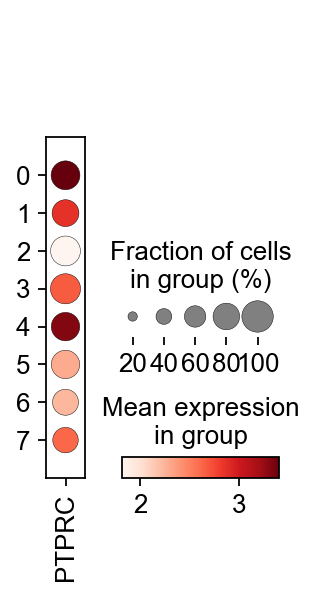

In [68]:
sc.pl.dotplot(adata_d1, ['PTPRC'#,'EPCAM','CDH1'
                        ], groupby='leiden', use_raw=False)

In [50]:
#adata_d1_imn = adata_d1[adata_d1.obs['louvain'].isin(['1','2','3','5','7','11'])]
#adata_d1_imn

View of AnnData object with n_obs × n_vars = 2745 × 19002
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'tissue', 'patient', 'louvain'
    var: 'gene_ids', 'feature_types', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'log1p', 'pca', 'neighbors', 'umap', 'louvain'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [71]:
sc.pp.pca(adata_d2)
sc.pp.neighbors(adata_d2)
sc.tl.umap(adata_d2)
sc.tl.pca(adata_d2)
sc.tl.leiden(adata_d2)


computing PCA
    with n_comps=50
    finished (0:00:08)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:14)
computing PCA
    with n_comps=50
    finished (0:00:08)
running Leiden clustering
    finished: found 14 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


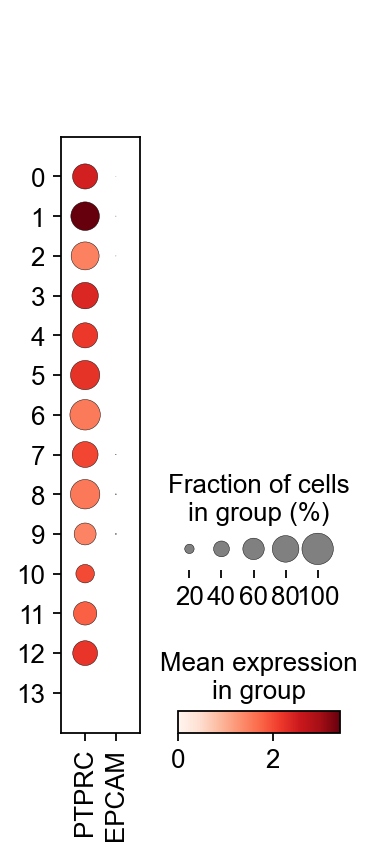

In [73]:
sc.pl.dotplot(adata_d2, ['PTPRC','EPCAM'#,'CDH1'
                        ], groupby='leiden')

In [52]:
#adata_d2_imn = adata_d2[adata_d2.obs['louvain'].isin(['1','2','3','5','6','8','9','14','15'])]
#adata_d2_imn

View of AnnData object with n_obs × n_vars = 2189 × 20840
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'tissue', 'patient', 'louvain'
    var: 'gene_ids', 'feature_types', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'log1p', 'pca', 'neighbors', 'umap', 'louvain'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [74]:
sc.pp.pca(adata_d3)
sc.pp.neighbors(adata_d3)
sc.tl.umap(adata_d3)
sc.tl.pca(adata_d3)
sc.tl.leiden(adata_d3)


computing PCA
    with n_comps=50
    finished (0:00:03)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:08)
computing PCA
    with n_comps=50
    finished (0:00:03)
running Leiden clustering
    finished: found 8 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


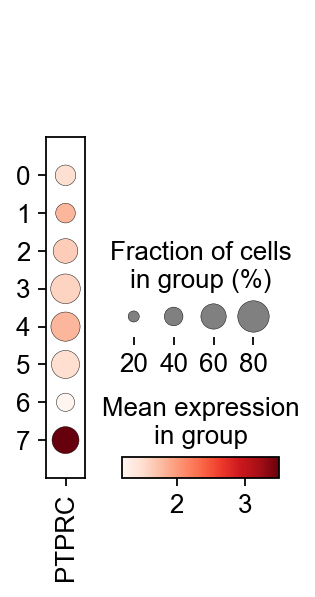

In [76]:
sc.pl.dotplot(adata_d3, ['PTPRC'#,'CDH1','EPCAM'
                        ], groupby='leiden')

In [54]:
#adata_d3_imn = adata_d3[adata_d3.obs['louvain'].isin(['0','1','2','3','5','7','11','13'])]
#adata_d3_imn

View of AnnData object with n_obs × n_vars = 1831 × 19784
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'tissue', 'patient', 'louvain'
    var: 'gene_ids', 'feature_types', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'log1p', 'pca', 'neighbors', 'umap', 'louvain'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [77]:
sc.pp.pca(adata_s1)
sc.pp.neighbors(adata_s1)
sc.tl.umap(adata_s1)
sc.tl.pca(adata_s1)
sc.tl.leiden(adata_s1)


computing PCA
    with n_comps=50
    finished (0:00:06)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:11)
computing PCA
    with n_comps=50
    finished (0:00:06)
running Leiden clustering
    finished: found 15 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


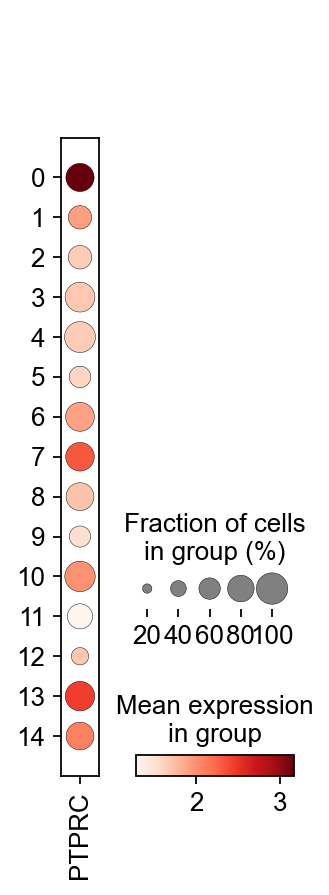

In [79]:
sc.pl.dotplot(adata_s1, ['PTPRC'#,'CDH1','EPCAM'
                        ], groupby='leiden')

In [56]:
#adata_s1_imn = adata_s1[adata_s1.obs['louvain'].isin(['0','1','2','6','7','8'])]
#adata_s1_imn

View of AnnData object with n_obs × n_vars = 803 × 16346
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'tissue', 'patient', 'louvain'
    var: 'gene_ids', 'feature_types', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'log1p', 'pca', 'neighbors', 'umap', 'louvain'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [80]:
sc.pp.pca(adata_s2)
sc.pp.neighbors(adata_s2)
sc.tl.umap(adata_s2)
sc.tl.pca(adata_s2)
sc.tl.leiden(adata_s2)


computing PCA
    with n_comps=50
    finished (0:00:04)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:10)
computing PCA
    with n_comps=50
    finished (0:00:04)
running Leiden clustering
    finished: found 12 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


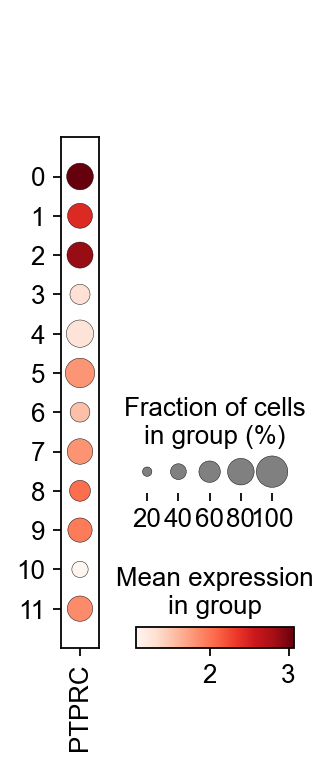

In [82]:
sc.pl.dotplot(adata_s2, ['PTPRC'#,'CDH1','EPCAM'
                        ], groupby='leiden')

In [ ]:
#adata_s2_imn = adata_s2[adata_s2.obs['louvain'].isin(['0','1','2','3','4','5','9','12','13','14','16'])]
#adata_s2_imn

In [83]:
sc.pp.pca(adata_s3)
sc.pp.neighbors(adata_s3)
sc.tl.umap(adata_s3)
sc.tl.pca(adata_s3)
sc.tl.leiden(adata_s3)

computing PCA
    with n_comps=50
    finished (0:00:03)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:08)
computing PCA
    with n_comps=50
    finished (0:00:03)
running Leiden clustering
    finished: found 21 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


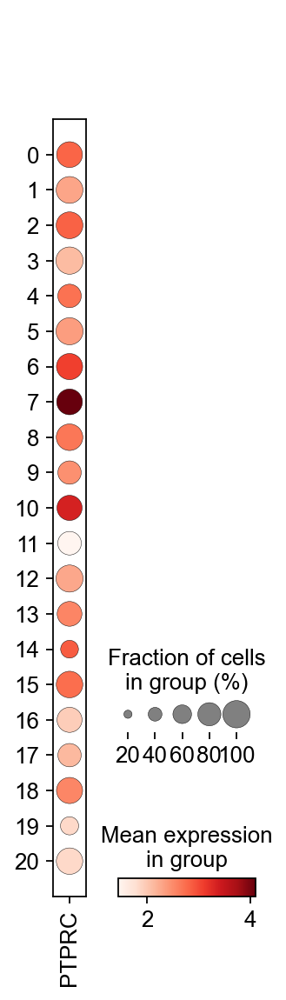

In [85]:
sc.pl.dotplot(adata_s3, ['PTPRC'#,'CDH1','EPCAM'
                        ], groupby='leiden')

In [ ]:
#adata_s3_imn = adata_s3[adata_s3.obs['louvain'].isin(['2','4','8'])]
#adata_s3_imn

In [86]:
adata = adata_d1.concatenate(adata_d2,adata_d3, adata_s1, adata_s2, adata_s3,
                               batch_key='batch')



In [87]:
adata.raw = adata

In [88]:
adata.obs['patient']

CTTGCCGTCGGA-0    nonresponder_1
CGAGTCACACAT-0    nonresponder_1
GAGCGACTGGCT-0    nonresponder_1
CCTTCACGATTC-0    nonresponder_1
TACATCATATTG-0    nonresponder_1
                       ...      
AAAGCTGCGCGC-5       responder_3
GCTCACGGCAGG-5       responder_3
GTAAATTAGCCA-5       responder_3
TCCCCCGTAAAA-5       responder_3
TTGCCTTCGAAT-5       responder_3
Name: patient, Length: 28530, dtype: object

In [89]:
adata.obs.patient = adata.obs.patient.astype('category')

In [90]:
adata.obs['patient']

CTTGCCGTCGGA-0    nonresponder_1
CGAGTCACACAT-0    nonresponder_1
GAGCGACTGGCT-0    nonresponder_1
CCTTCACGATTC-0    nonresponder_1
TACATCATATTG-0    nonresponder_1
                       ...      
AAAGCTGCGCGC-5       responder_3
GCTCACGGCAGG-5       responder_3
GTAAATTAGCCA-5       responder_3
TCCCCCGTAAAA-5       responder_3
TTGCCTTCGAAT-5       responder_3
Name: patient, Length: 28530, dtype: category
Categories (6, object): ['nonresponder_1', 'nonresponder_2', 'nonresponder_3', 'responder_1', 'responder_2', 'responder_3']

In [91]:
adata

AnnData object with n_obs × n_vars = 28530 × 11699
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'patient', 'file_name', 'leiden', 'batch'
    var: 'gene_ids', 'mt', 'n_cells-0', 'n_cells_by_counts-0', 'mean_counts-0', 'pct_dropout_by_counts-0', 'total_counts-0', 'n_cells-1', 'n_cells_by_counts-1', 'mean_counts-1', 'pct_dropout_by_counts-1', 'total_counts-1', 'n_cells-2', 'n_cells_by_counts-2', 'mean_counts-2', 'pct_dropout_by_counts-2', 'total_counts-2', 'n_cells-3', 'n_cells_by_counts-3', 'mean_counts-3', 'pct_dropout_by_counts-3', 'total_counts-3', 'n_cells-4', 'n_cells_by_counts-4', 'mean_counts-4', 'pct_dropout_by_counts-4', 'total_counts-4', 'n_cells-5', 'n_cells_by_counts-5', 'mean_counts-5', 'pct_dropout_by_counts-5', 'total_counts-5'
    obsm: 'X_pca', 'X_umap'

In [92]:
adata.write('all_patients_concatenated.h5ad', compression='gzip')

In [101]:
adata = sc.read('all_patients_concatenated.h5ad')

In [102]:
adata.obs.leiden = adata.obs.leiden.astype('category')
adata.obs.patient = adata.obs.patient.astype('category')

In [103]:
# mitochondrial genes
adata.var['mt'] = adata.var_names.str.startswith('MT-') 
# ribosomal genes
adata.var['ribo'] = adata.var_names.str.startswith(("RPS","RPL"))
# hemoglobin genes.
adata.var['hb'] = adata.var_names.str.contains(("^HB[^(P)]"))

adata.var

,gene_ids,mt,n_cells-0,n_cells_by_counts-0,mean_counts-0,pct_dropout_by_counts-0,total_counts-0,n_cells-1,n_cells_by_counts-1,mean_counts-1,...,mean_counts-4,pct_dropout_by_counts-4,total_counts-4,n_cells-5,n_cells_by_counts-5,mean_counts-5,pct_dropout_by_counts-5,total_counts-5,ribo,hb
SAT1,SAT1,False,5199,5199,3.869703,2.840591,20706.781250,5017,5017,2.530860,...,3.359556,12.725173,14546.879883,3680,3680,2.975745,8.183633,11926.788086,False,False
G0S2,G0S2,False,4638,4638,2.894943,13.324612,15490.837891,933,933,0.363134,...,1.368615,55.750577,5926.104004,448,448,0.220240,88.822355,882.722351,False,False
NFKBIA,NFKBIA,False,5196,5196,3.891202,2.896655,20821.820312,4333,4333,1.968553,...,3.482780,10.415704,15080.439453,3568,3568,2.870520,10.978044,11505.045898,False,False
ARHGDIB,ARHGDIB,False,3592,3592,1.840833,32.872360,9850.297852,4311,4311,1.865880,...,1.342431,50.993072,5812.724609,3190,3190,1.830707,20.409182,7337.475586,False,False
UBA52,UBA52,False,2759,2759,1.326091,48.439544,7095.914062,3621,3621,1.525365,...,1.209000,56.004619,5234.969727,3195,3195,1.923048,20.284431,7707.575684,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
AC138761.1,AC138761.1,False,9,9,0.002873,99.831807,15.375413,17,17,0.004149,...,0.004959,99.745958,21.471735,21,21,0.006103,99.476048,24.459465,False,False
CYP51A1,CYP51A1,False,6,6,0.002009,99.887871,10.751183,23,23,0.006072,...,0.015912,99.237875,68.900070,45,45,0.014425,98.877246,57.813858,False,False
RBMX2P5,RBMX2P5,False,6,6,0.001955,99.887871,10.461478,5,5,0.001372,...,0.003814,99.769053,16.512817,12,12,0.003531,99.700599,14.152875,False,False
RPL12P1,RPL12P1,False,5,5,0.001807,99.906560,9.669780,17,17,0.005085,...,0.004067,99.815242,17.612055,7,7,0.002375,99.825349,9.520783,True,False


# mitochondrial genes are alread removed

In [104]:
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt','ribo','hb'], percent_top=None, log1p=False, inplace=True)

In [105]:
adata

AnnData object with n_obs × n_vars = 28530 × 11699
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'patient', 'file_name', 'leiden', 'batch', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb'
    var: 'gene_ids', 'mt', 'n_cells-0', 'n_cells_by_counts-0', 'mean_counts-0', 'pct_dropout_by_counts-0', 'total_counts-0', 'n_cells-1', 'n_cells_by_counts-1', 'mean_counts-1', 'pct_dropout_by_counts-1', 'total_counts-1', 'n_cells-2', 'n_cells_by_counts-2', 'mean_counts-2', 'pct_dropout_by_counts-2', 'total_counts-2', 'n_cells-3', 'n_cells_by_counts-3', 'mean_counts-3', 'pct_dropout_by_counts-3', 'total_counts-3', 'n_cells-4', 'n_cells_by_counts-4', 'mean_counts-4', 'pct_dropout_by_counts-4', 'total_counts-4', 'n_cells-5', 'n_cells_by_counts-5', 'mean_counts-5', 'pct_dropout_by_counts-5', 'total_counts-5', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    obsm: 'X_pca', 'X_umap'

In [106]:
# filter for percent mito
adata = adata[adata.obs['pct_counts_mt'] < 20, :]

# filter for percent ribo > 0.05
adata = adata[adata.obs['pct_counts_ribo'] > 3, :]

print("Remaining cells %d"%adata.n_obs)

Remaining cells 23513


In [107]:
adata

View of AnnData object with n_obs × n_vars = 23513 × 11699
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'patient', 'file_name', 'leiden', 'batch', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb'
    var: 'gene_ids', 'mt', 'n_cells-0', 'n_cells_by_counts-0', 'mean_counts-0', 'pct_dropout_by_counts-0', 'total_counts-0', 'n_cells-1', 'n_cells_by_counts-1', 'mean_counts-1', 'pct_dropout_by_counts-1', 'total_counts-1', 'n_cells-2', 'n_cells_by_counts-2', 'mean_counts-2', 'pct_dropout_by_counts-2', 'total_counts-2', 'n_cells-3', 'n_cells_by_counts-3', 'mean_counts-3', 'pct_dropout_by_counts-3', 'total_counts-3', 'n_cells-4', 'n_cells_by_counts-4', 'mean_counts-4', 'pct_dropout_by_counts-4', 'total_counts-4', 'n_cells-5', 'n_cells_by_counts-5', 'mean_counts-5', 'pct_dropout_by_counts-5', 'total_counts-5', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    obsm: 'X_pca', 'X_uma

In [108]:
pd.crosstab(adata.obs['patient'], adata.obs['patient'])

patient,nonresponder_1,nonresponder_2,nonresponder_3,responder_1,responder_2,responder_3
patient,,,,,,
nonresponder_1,4555,0,0,0,0,0
nonresponder_2,0,4326,0,0,0,0
nonresponder_3,0,0,3364,0,0,0
responder_1,0,0,0,5154,0,0
responder_2,0,0,0,0,2225,0
responder_3,0,0,0,0,0,3889


In [109]:
malat1 = adata.var_names.str.startswith('MALAT1')
# we need to redefine the mito_genes since they were first 
# calculated on the full object before removing low expressed genes.
mito_genes = adata.var_names.str.startswith('MT-')
ribo_genes_1 = adata.var_names.str.startswith('RPS')
ribo_genes_2 = adata.var_names.str.startswith('RPL')
hb_genes = adata.var_names.str.contains('^HB[^(P)]')

remove = np.add(mito_genes, malat1)
remove = np.add(remove, ribo_genes_1)
remove = np.add(remove, ribo_genes_2)
remove = np.add(remove, hb_genes)
keep = np.invert(remove)

adata = adata[:,keep]

print(adata.n_obs, adata.n_vars)

23513 11409


In [110]:
adata.raw = adata

In [111]:
adata.raw

In [112]:
#sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)
#adata = adata[:, adata.var.highly_variable]
sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt'])
sc.pp.scale(adata, max_value=10)
sc.tl.pca(adata, svd_solver='arpack')
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=20)
sc.tl.leiden(adata)
sc.tl.umap(adata)

regressing out ['total_counts', 'pct_counts_mt']
    finished (0:05:57)
computing PCA
    with n_comps=50
    finished (0:00:29)
computing neighbors
    using 'X_pca' with n_pcs = 20
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:20)
running Leiden clustering
    finished: found 28 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:16)


    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_patient']`


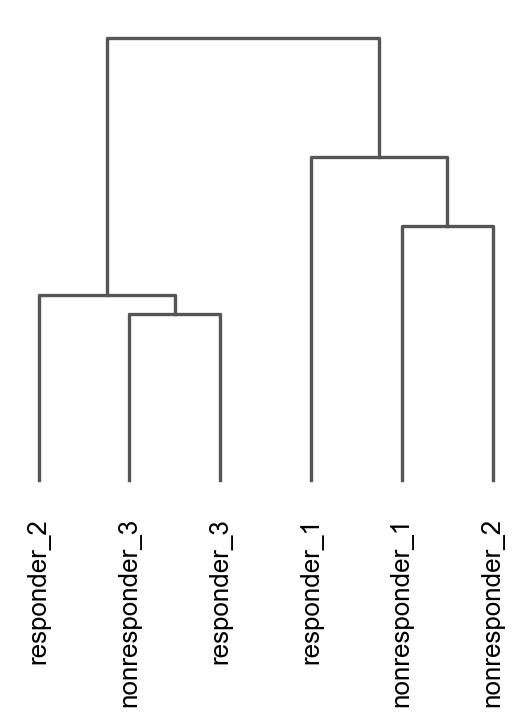

<AxesSubplot:>

In [113]:
# dendrogram after converting mouse gene to human gene
sc.tl.dendrogram(adata, 'patient')
sc.pl.dendrogram(adata, 'patient')

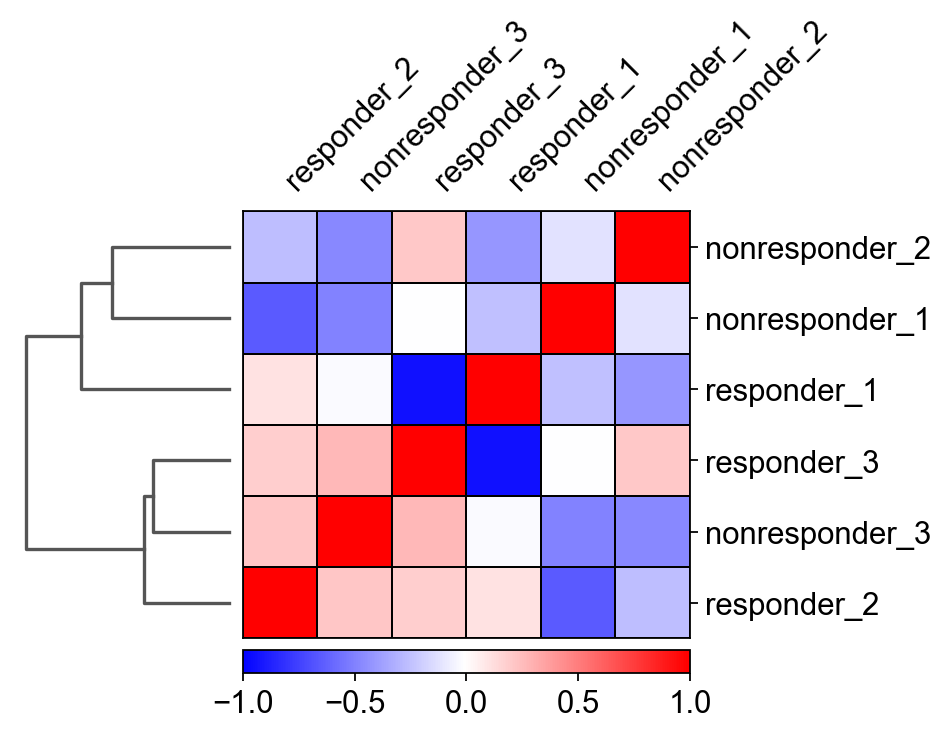

In [114]:
sc.pl.correlation_matrix(adata, groupby='patient')

In [115]:
adata

AnnData object with n_obs × n_vars = 23513 × 11409
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'patient', 'file_name', 'leiden', 'batch', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb'
    var: 'gene_ids', 'mt', 'n_cells-0', 'n_cells_by_counts-0', 'mean_counts-0', 'pct_dropout_by_counts-0', 'total_counts-0', 'n_cells-1', 'n_cells_by_counts-1', 'mean_counts-1', 'pct_dropout_by_counts-1', 'total_counts-1', 'n_cells-2', 'n_cells_by_counts-2', 'mean_counts-2', 'pct_dropout_by_counts-2', 'total_counts-2', 'n_cells-3', 'n_cells_by_counts-3', 'mean_counts-3', 'pct_dropout_by_counts-3', 'total_counts-3', 'n_cells-4', 'n_cells_by_counts-4', 'mean_counts-4', 'pct_dropout_by_counts-4', 'total_counts-4', 'n_cells-5', 'n_cells_by_counts-5', 'mean_counts-5', 'pct_dropout_by_counts-5', 'total_counts-5', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'mean', 'std'
    uns: 'pca', 'n

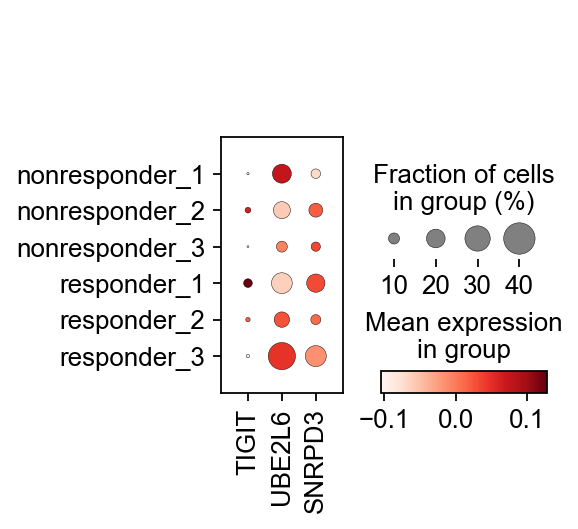

In [116]:
sc.pl.dotplot(adata, ['TIGIT','UBE2L6','SNRPD3'], groupby='patient', use_raw=False)

In [117]:
#############################################################
############ Harmony batch correction #######################
#############################################################

sce.pp.harmony_integrate(adata, 'batch')
'X_pca_harmony' in adata.obsm
True

2023-01-12 15:14:30,161 - harmonypy - INFO - Iteration 1 of 10
2023-01-12 15:14:44,513 - harmonypy - INFO - Iteration 2 of 10
2023-01-12 15:14:58,816 - harmonypy - INFO - Iteration 3 of 10
2023-01-12 15:15:10,726 - harmonypy - INFO - Iteration 4 of 10
2023-01-12 15:15:17,139 - harmonypy - INFO - Iteration 5 of 10
2023-01-12 15:15:23,192 - harmonypy - INFO - Iteration 6 of 10
2023-01-12 15:15:28,458 - harmonypy - INFO - Iteration 7 of 10
2023-01-12 15:15:33,833 - harmonypy - INFO - Iteration 8 of 10
2023-01-12 15:15:39,135 - harmonypy - INFO - Converged after 8 iterations


True

In [207]:
adata.obsm['X_pca'] = adata.obsm['X_pca_harmony']
sc.pp.neighbors(adata)
sc.tl.umap(adata)
sc.tl.leiden(adata)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:03)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:28)
running Leiden clustering
    finished: found 17 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:02)


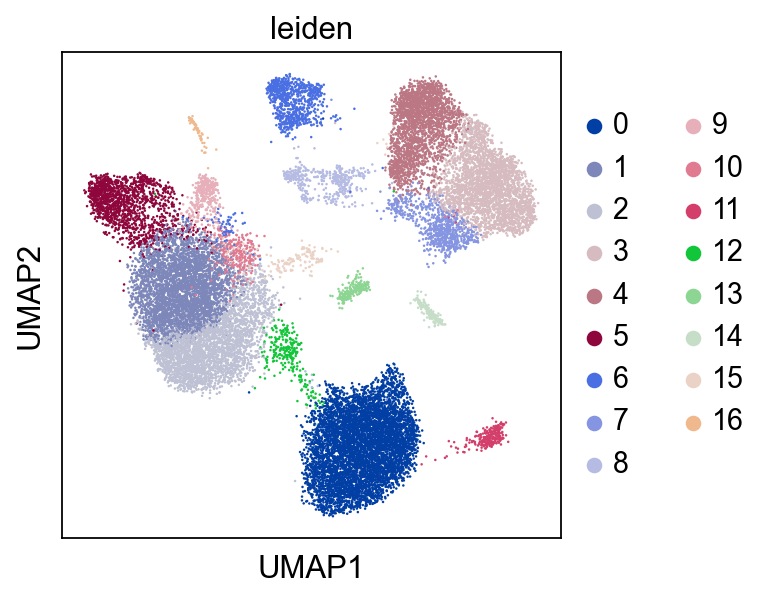

In [208]:
sc.pl.umap(adata, color=['leiden'])

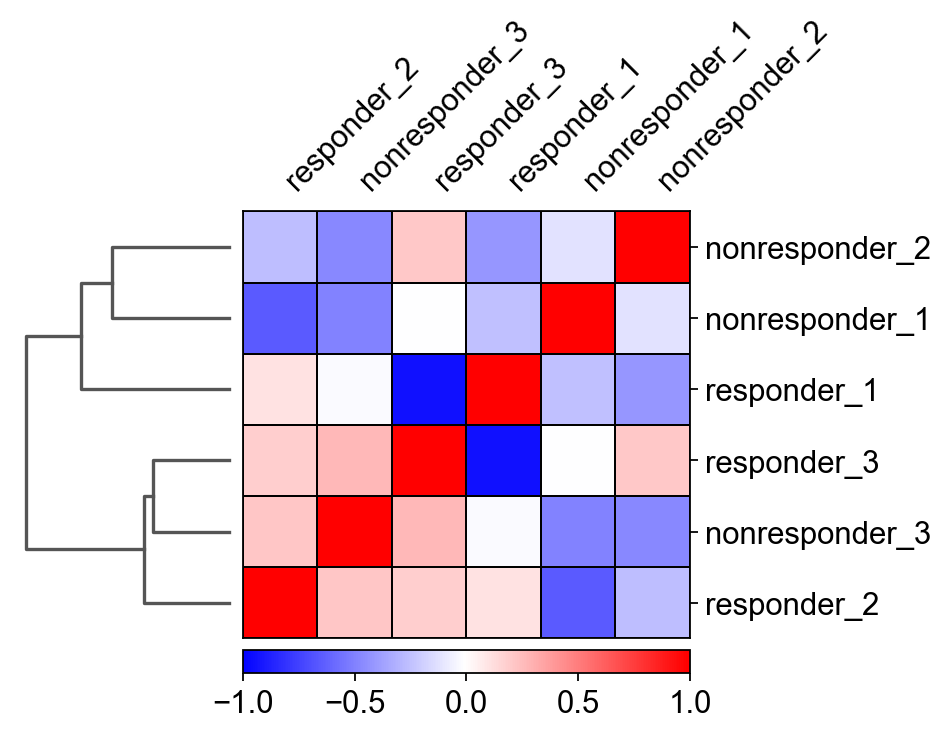

In [209]:
sc.pl.correlation_matrix(adata, groupby='patient')

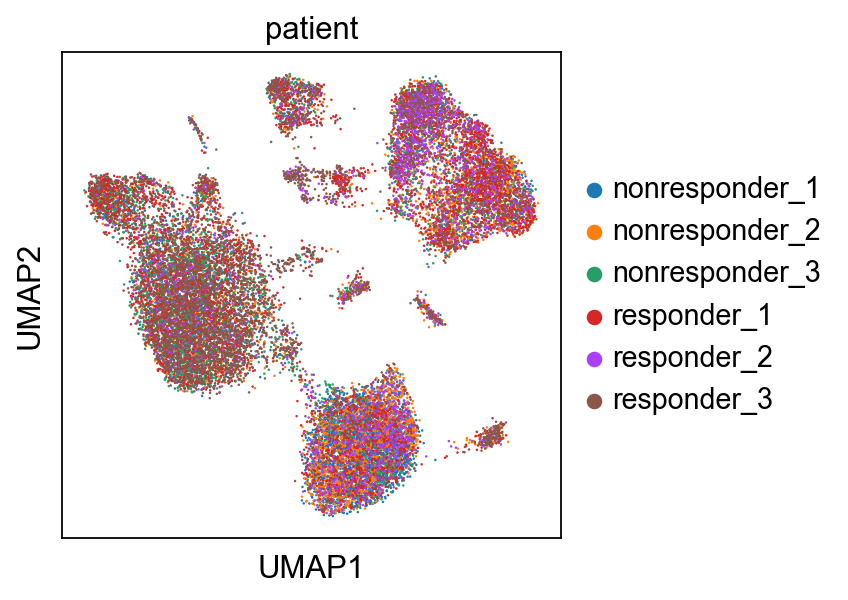

In [210]:
sc.pl.umap(adata, color=['patient'])#, save='umap_Group_A_patient_immune-modified.pdf')

In [211]:
#sc.pl.umap(adata, color=['patient'], save='umap_Group_A_patient_immune.pdf')

In [212]:
adata.write('all_patients_after_harmony.h5ad')

In [213]:
adata.obs

,n_genes,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,patient,file_name,leiden,batch,total_counts_ribo,pct_counts_ribo,total_counts_hb,pct_counts_hb,celltype,crude,celltype_detail,response
CTTGCCGTCGGA-0,3741,3635,1397.243774,19.050234,1.363415,nonresponder_1,PD1-D1,8,0,101.290787,7.249329,1.210672,0.086647,Monocyte,NaN,Monocyte,Nonresponders
CGAGTCACACAT-0,3563,3487,1407.560303,23.679771,1.682327,nonresponder_1,PD1-D1,5,0,105.904358,7.523966,1.038069,0.073750,Monocyte,NaN,Monocyte,Nonresponders
GAGCGACTGGCT-0,3339,3279,1409.313477,22.003889,1.561320,nonresponder_1,PD1-D1,1,0,86.078606,6.107840,0.662683,0.047022,Monocyte,NaN,Monocyte,Nonresponders
CCTTCACGATTC-0,3410,3346,1409.737183,20.661764,1.465647,nonresponder_1,PD1-D1,5,0,83.888268,5.950632,1.622554,0.115096,Monocyte,NaN,Monocyte,Nonresponders
TACATCATATTG-0,3188,3122,1406.716797,21.422604,1.522880,nonresponder_1,PD1-D1,10,0,114.737907,8.156433,1.387298,0.098620,Monocyte,NaN,Monocyte,Nonresponders
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
AAAGCTGCGCGC-5,608,593,2097.263916,75.106140,3.581149,responder_3,PD1-S3,6,5,265.869873,12.676987,4.590319,0.218872,B cell,NaN,B cell,Responders
GCTCACGGCAGG-5,560,541,2078.378662,57.489052,2.766053,responder_3,PD1-S3,3,5,346.141968,16.654423,8.568939,0.412290,T cell,NaN,NK cell,Responders
GTAAATTAGCCA-5,609,599,2114.809326,59.998657,2.837072,responder_3,PD1-S3,2,5,156.074402,7.380070,9.884173,0.467379,Monocyte,NaN,Monocyte,Responders
TCCCCCGTAAAA-5,581,575,2124.718262,27.837864,1.310191,responder_3,PD1-S3,2,5,177.390732,8.348906,0.000000,0.000000,Monocyte,NaN,Monocyte,Responders


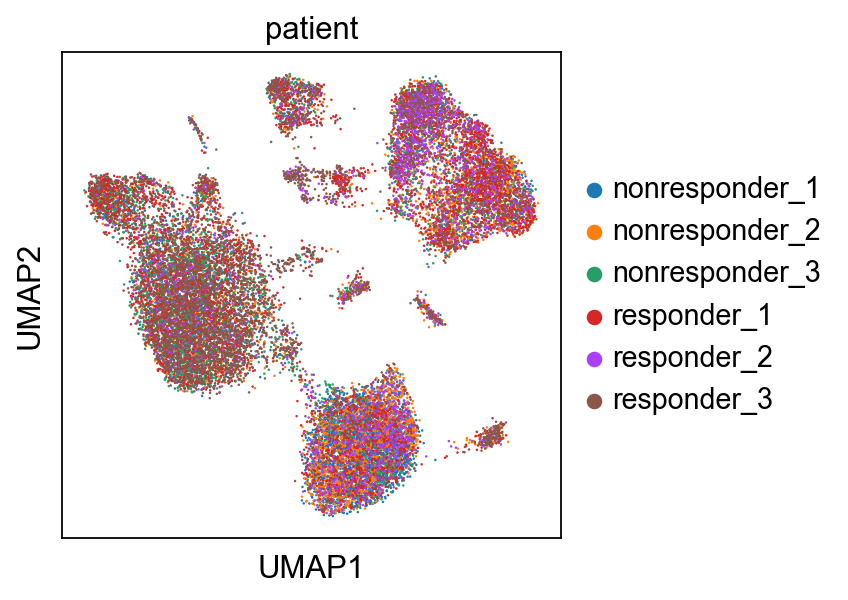

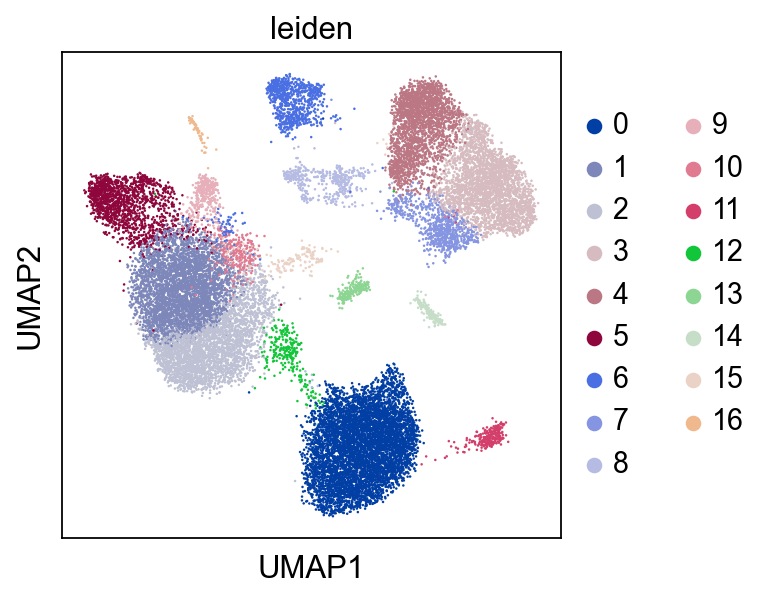

In [214]:
sc.pl.umap(adata, color=['patient'], save='_patient.pdf')
sc.pl.umap(adata, color=['leiden'], save='_leiden.pdf')

In [215]:
#sc.pl.umap(adata, color=['louvain'], save='umap_Group_A_louvain.pdf')

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:01:37)


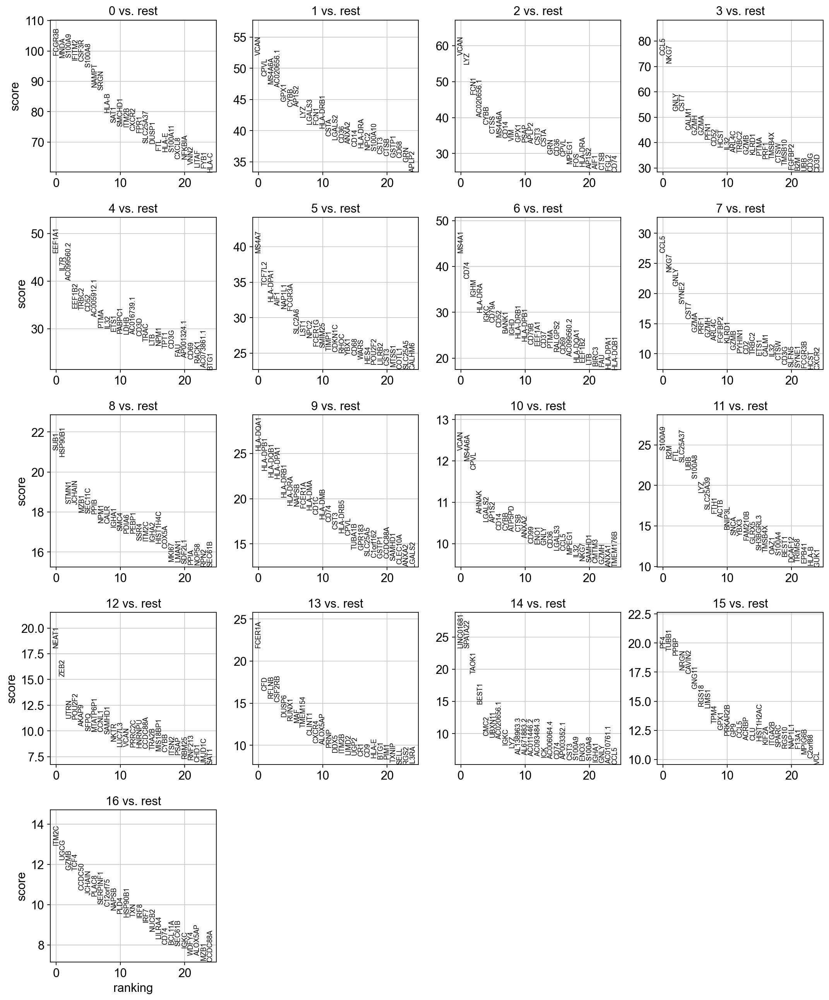

In [216]:
sc.tl.rank_genes_groups(adata, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

In [217]:
df=pd.DataFrame(adata.uns['rank_genes_groups']['names'])
df.to_csv("F:/Ko/PD-1_responders/patient_cluster_markergene_01-12-23.csv",
                 sep=',', na_rep='', float_format=None, columns=None, header=True, 
                 index=True, index_label=None, mode='w', encoding=None, compression='infer', 
                 quoting=None, quotechar='"', line_terminator=None, chunksize=None, date_format=None)

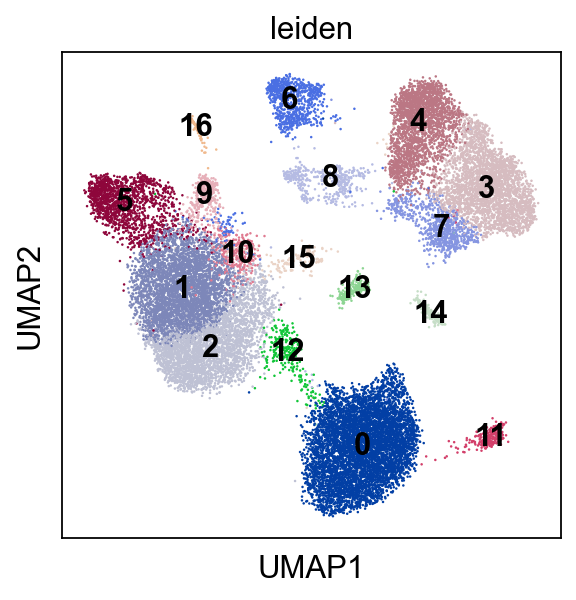

In [218]:
sc.pl.umap(adata, color=['leiden'],legend_loc='on data')

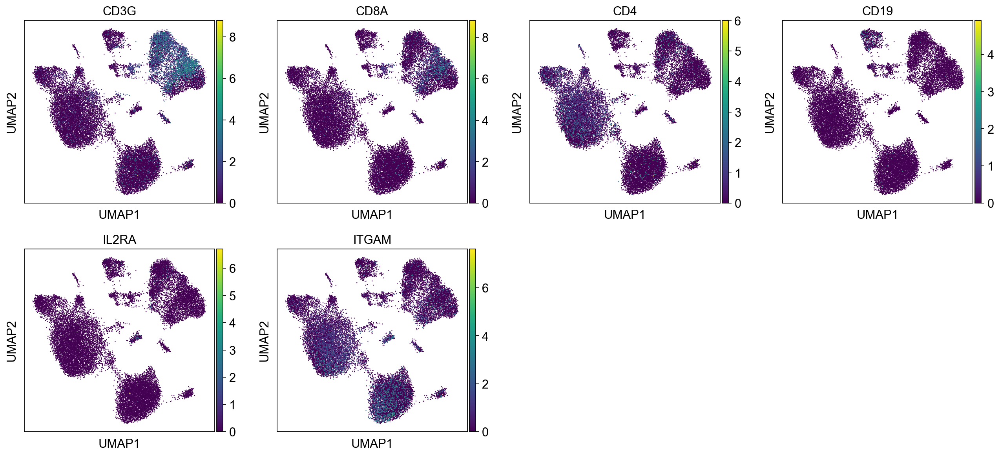

In [220]:
# T cell marker: 'CD3G','CD8A','CD4'
# B cell marker: 'CD19'
# Myeloid cell marker: 'ITGAM','MRC1'
sc.pl.umap(adata, color=['CD3G','CD8A','CD4','CD19','IL2RA','ITGAM'])

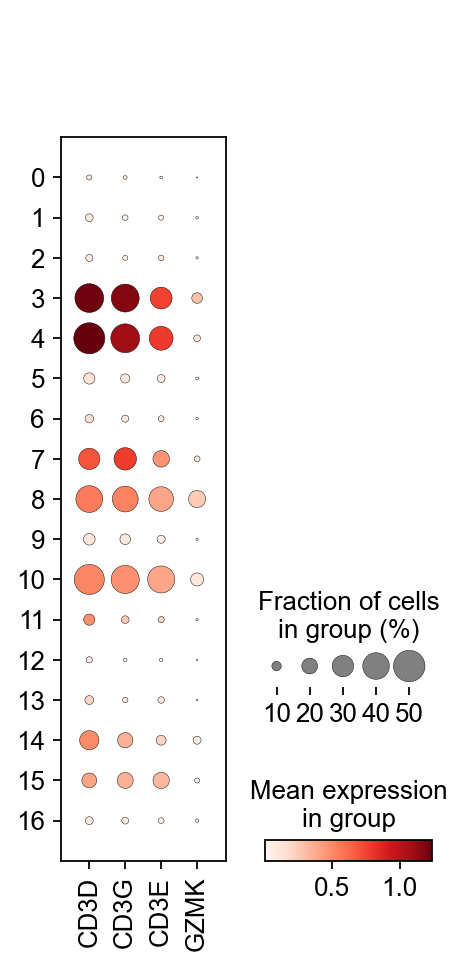

In [222]:
Tcell_geneset = ['CD3D','CD3G','CD3E','GZMK'] # T cell
sc.pl.dotplot(adata, Tcell_geneset , 'leiden')
#T cell '3','4','7','8','10','14','15'

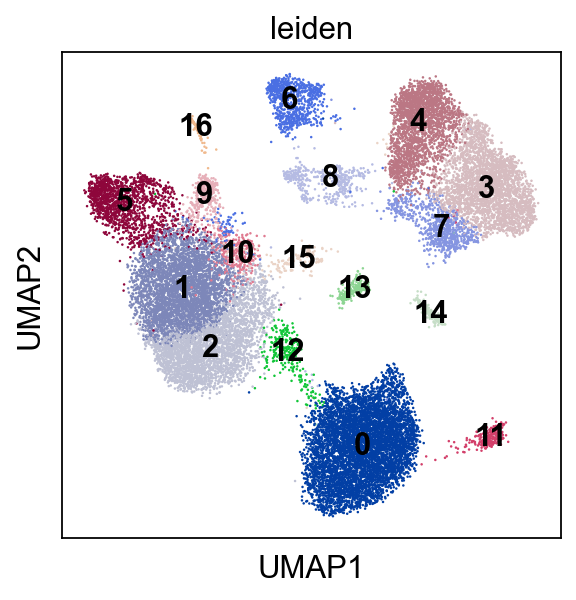

In [223]:
sc.pl.umap(adata, color=['leiden'],legend_loc='on data')

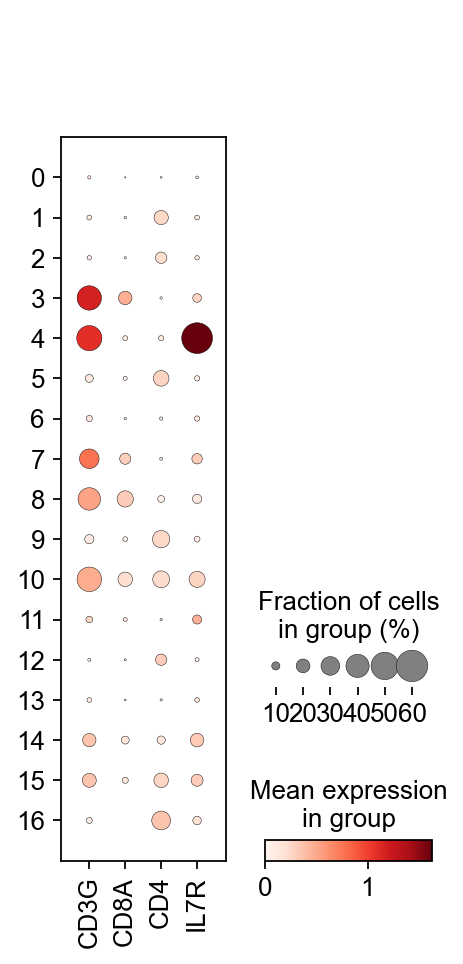

In [224]:
Tcell_geneset_1 = ['CD3G','CD8A','CD4','IL7R'] # T cell
sc.pl.dotplot(adata, Tcell_geneset_1 , 'leiden')
#CD8 T cell '3','8'
#CD4 T cell '4','5','15','16'

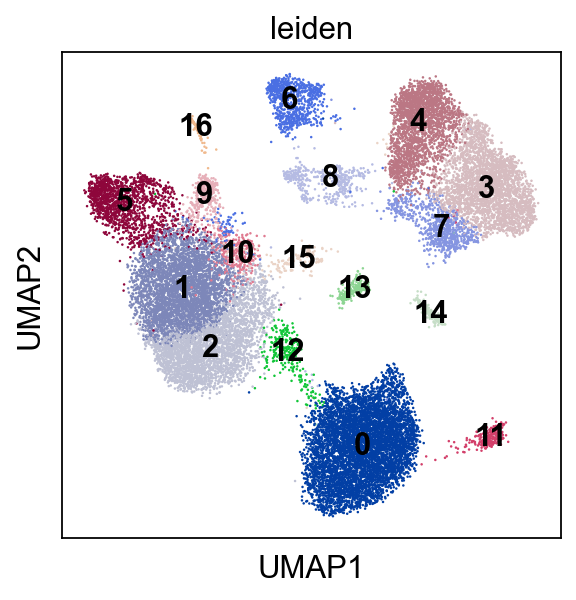

In [225]:
sc.pl.umap(adata, color=['leiden'],legend_loc='on data')

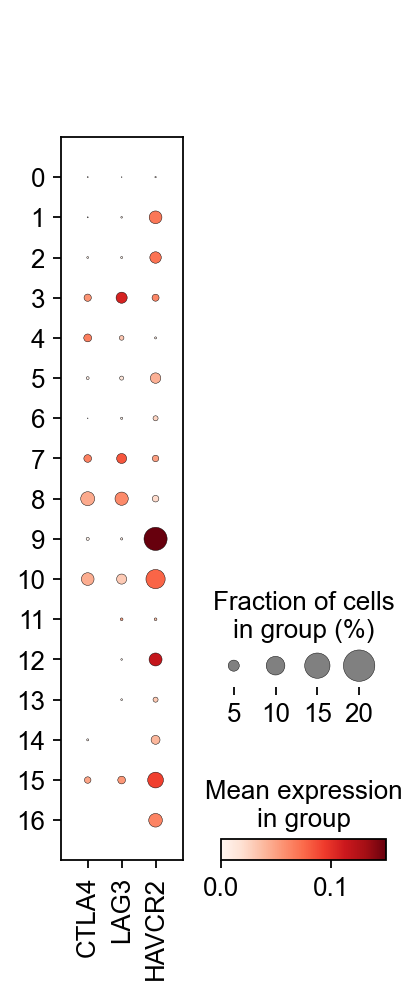

In [232]:
Texcell_geneset = ['CTLA4',#'PDCD1',
                   'LAG3','HAVCR2'] # exhausted T cell
sc.pl.dotplot(adata, Texcell_geneset , 'leiden')
#T exhausted cell '3','7','8','10','15'

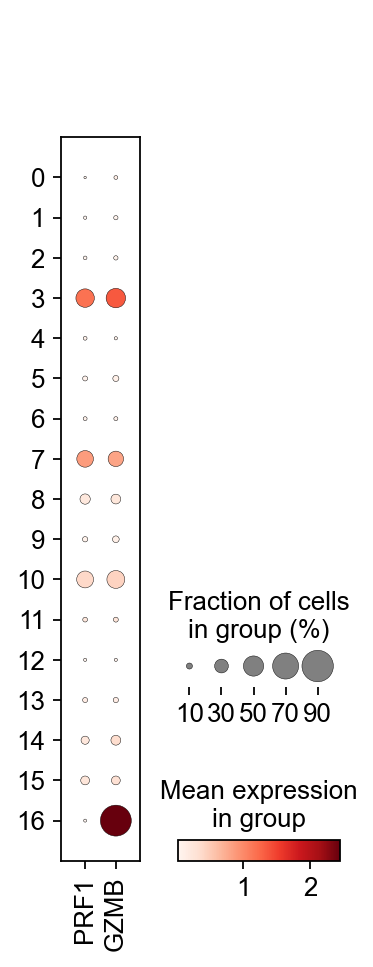

In [227]:
Teffcell_geneset = ['PRF1','GZMB'] # effector T cell
sc.pl.dotplot(adata, Teffcell_geneset , 'leiden')
#T effector cell '3','7','10','15',

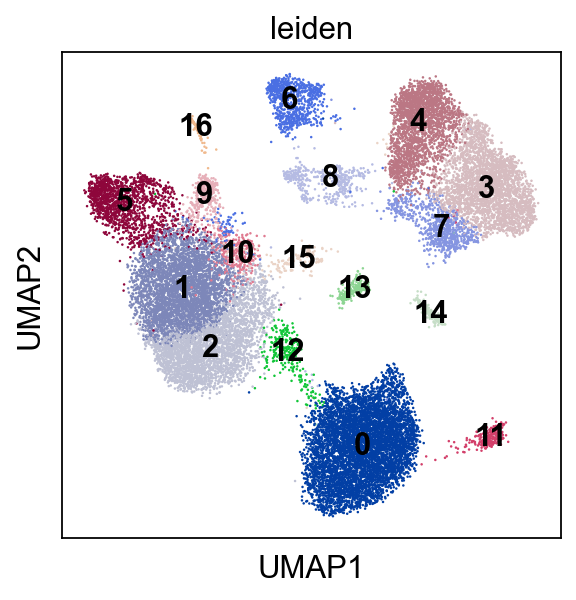

In [228]:
sc.pl.umap(adata, color=['leiden'],legend_loc='on data')

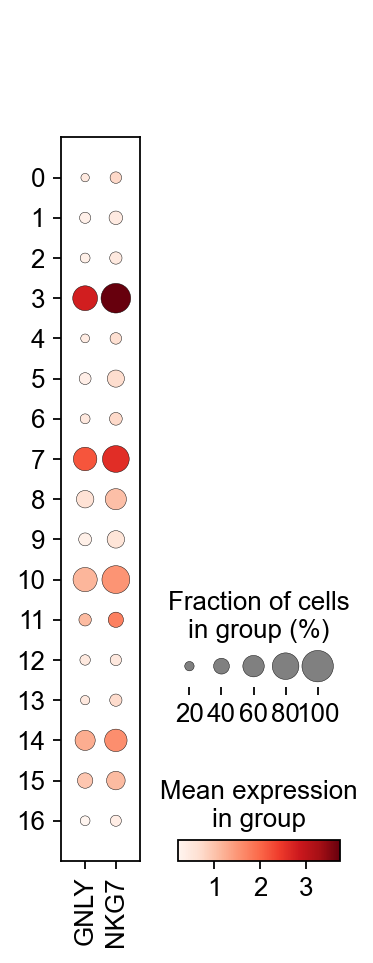

In [229]:
NK_geneset = ['GNLY','NKG7'] # effector T cell
sc.pl.dotplot(adata, NK_geneset , 'leiden')
#NK cell '3','7'

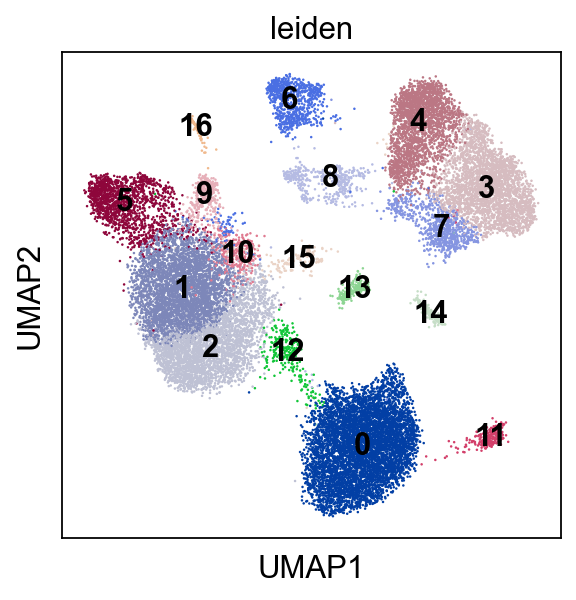

In [230]:
sc.pl.umap(adata, color=['leiden'],legend_loc='on data')

In [ ]:
#T cell               '3','4',         '7','8',        '10',            '14', '15'
#CD8 T cell           '3',                '8'
#CD4 T cell               '4','5',                                           '15','16'
#T exhausted cell '3',                 '7','8',       '10',                   '15'
#T effector cell  '3',                 '7',           '10',                   '15',
#NK cell          '3',                 '7'

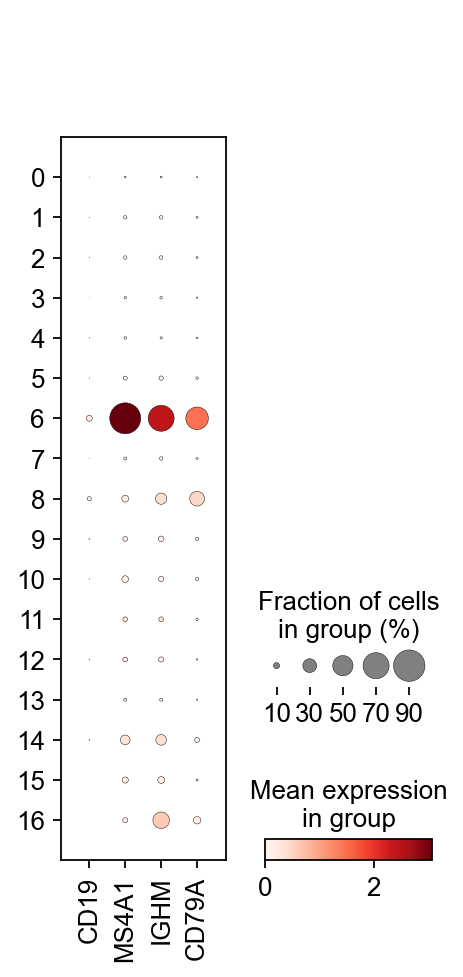

In [233]:
Bcell_geneset =['CD19','MS4A1','IGHM','CD79A'] # B cell
sc.pl.dotplot(adata, Bcell_geneset , 'leiden')
#B cell '6'

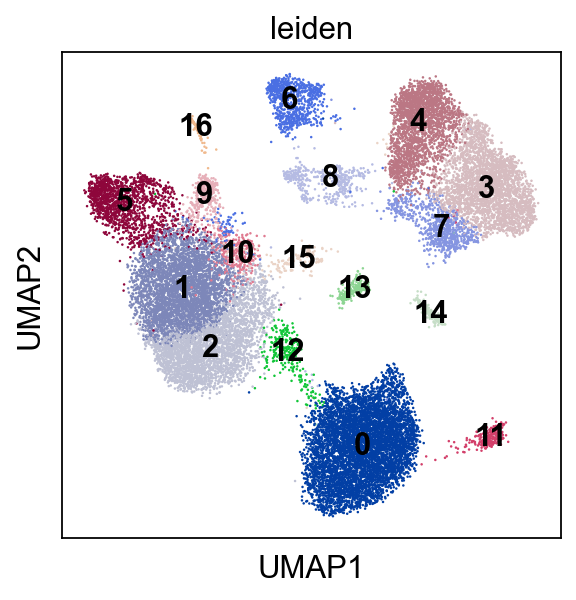

In [234]:
sc.pl.umap(adata, color=['leiden'],legend_loc='on data')

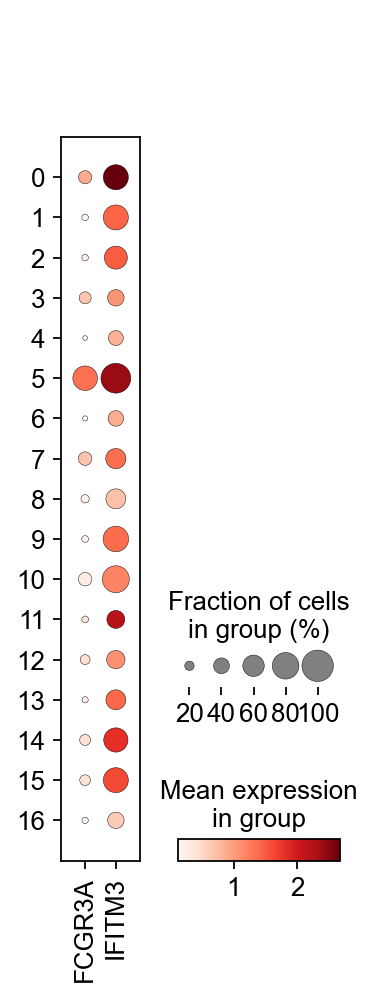

In [235]:
Mono_geneset =['FCGR3A','IFITM3'] #Monocyte
sc.pl.dotplot(adata, Mono_geneset , 'leiden')
#Monocyte 

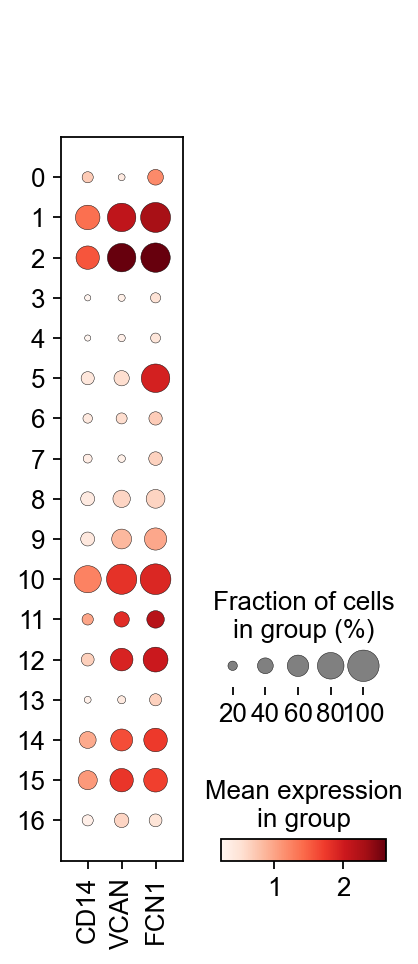

In [236]:
Mono_geneset_2 =['CD14','VCAN','FCN1'] #Monocyte
sc.pl.dotplot(adata, Mono_geneset_2 , 'leiden')
#Monocyte_2 '1','2','5','9','10','11','12','14','15'

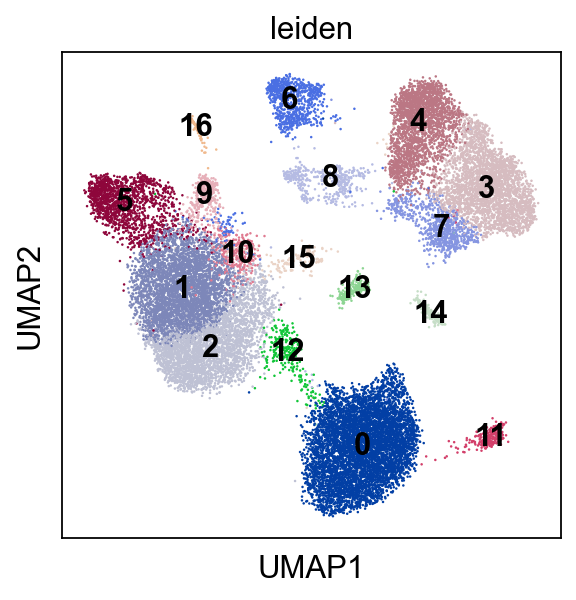

In [237]:
sc.pl.umap(adata, color=['leiden'],legend_loc='on data')

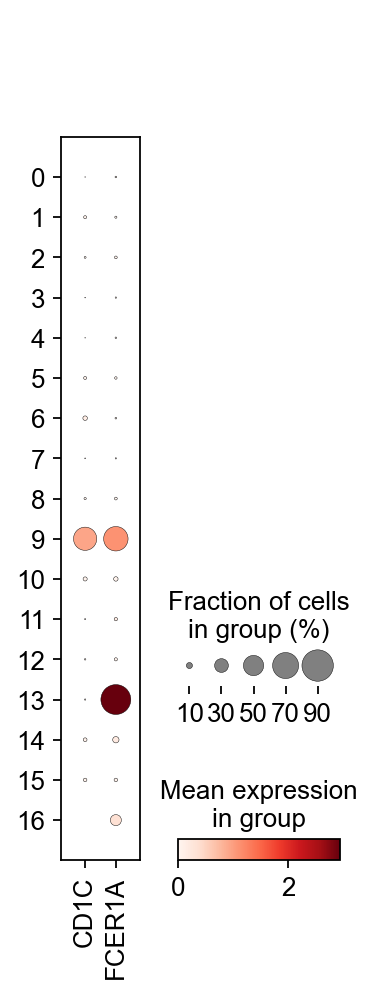

In [238]:
DC_geneset =['CD1C','FCER1A'] #Monocyte
sc.pl.dotplot(adata, DC_geneset , 'leiden')
#DC '9','13'

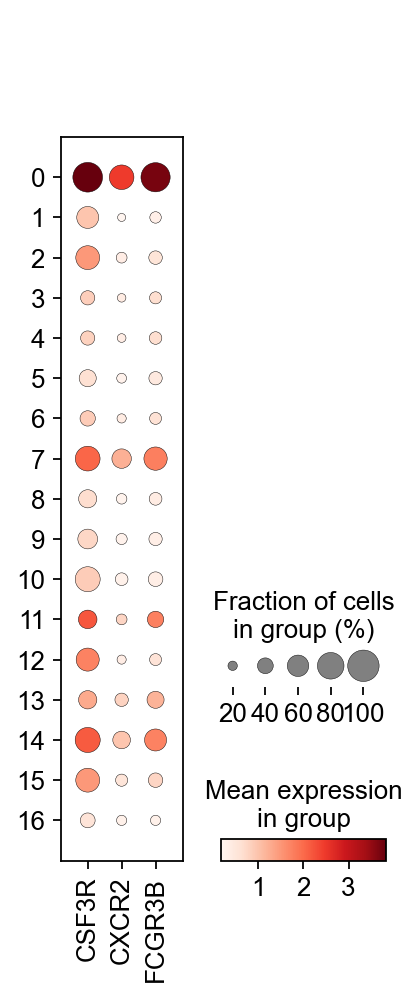

In [239]:
Neutro_geneset =['CSF3R','CXCR2','FCGR3B'] #Monocyte
sc.pl.dotplot(adata, Neutro_geneset , 'leiden')
#Neutorphil '0'

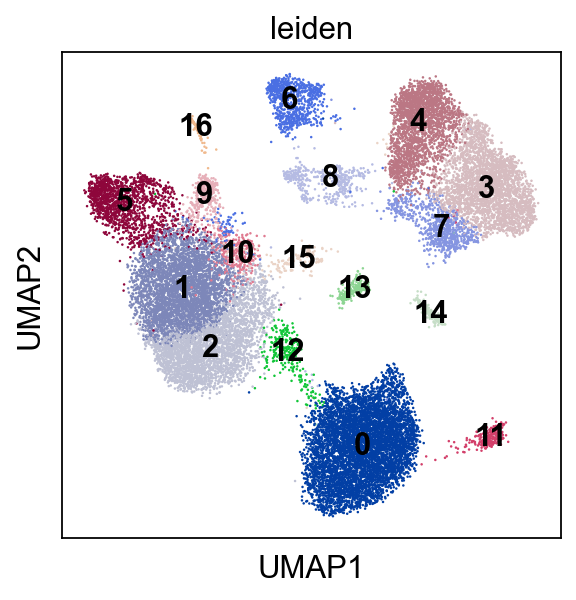

In [240]:
sc.pl.umap(adata, color=['leiden'],legend_loc='on data')

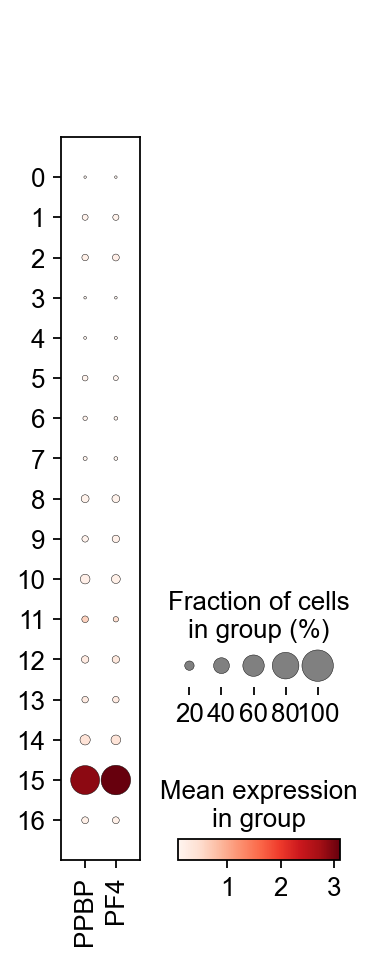

In [241]:
Platelet_geneset =['PPBP','PF4'] #Monocyte
sc.pl.dotplot(adata, Platelet_geneset , 'leiden')
#Platelet '15'

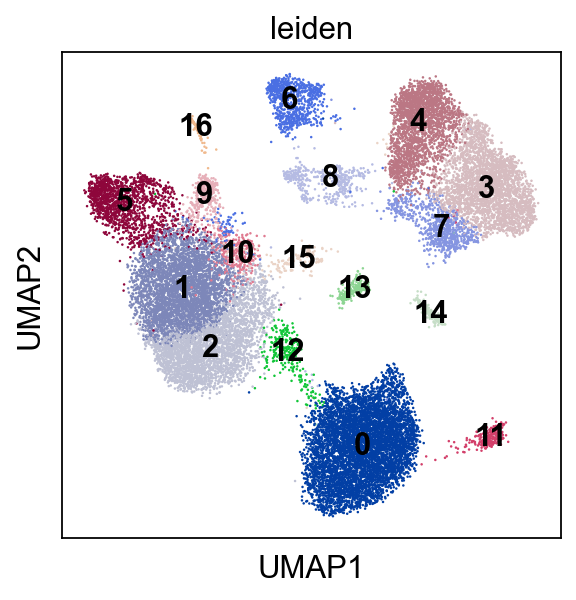

In [242]:
sc.pl.umap(adata, color=['leiden'],legend_loc='on data')

In [166]:
#T cell                      '3','4',         '7','8',        '10',              '14','15'
#CD8 T cell                  '3',                '8'
#CD4 T cell                      '4','5',                                             '15','16'
#T exhausted cell            '3',                 '7','8',    '10',                   '15'
#T effector cell             '3',                 '7',        '10',                   '15',
#NK cell                     '3',                 '7'
#B cell                                  '6'                                                                                          '11'                                            ,'22'                  

#Neutorphil       '0'
#DC                                                       '9',               '13'
#Monocyte_2          '1','2',        '5',                 '9','10','11','12',    '14','15'
#Platelet                                                                             '15'

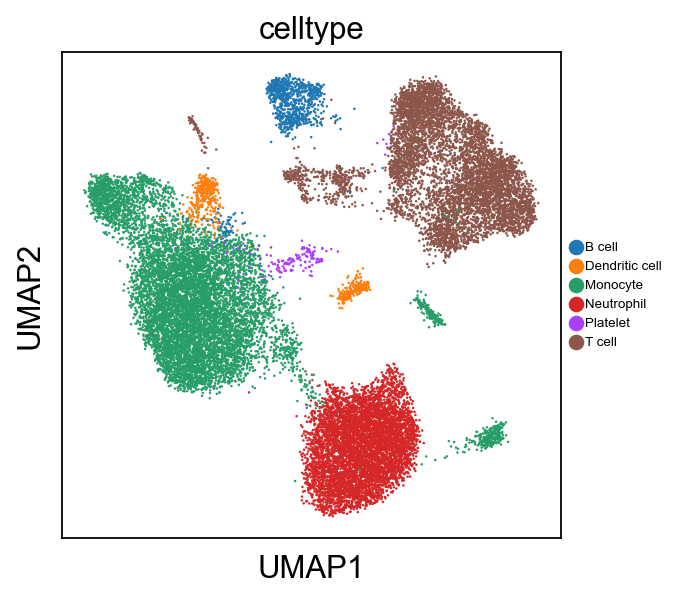

In [36]:
#T cell                      '3','4',         '7','8',        '10',              '14','15'
#CD8 T cell                  '3',                '8'
#CD4 T cell                      '4','5',                                             '15','16'
#T exhausted cell            '3',                 '7','8',    '10',                   '15'
#T effector cell             '3',                 '7',        '10',                   '15',
#NK cell                     '3',                 '7'
#B cell                                  '6'                                                                                          '11'                                            ,'22'                  

#Neutorphil       '0'
#DC                                                       '9',               '13'
#Monocyte_2          '1','2',        '5',                 '9','10','11','12',    '14','15'
#Platelet                                                                             '15'
# Fill in the clusters that belong to each cell type based on each marker in the plot above
cell_dict = {'T cell':         [            '3','4',       '7','8',        '10',                '14',   '16'],
             'B cell':         [                        '6' ],
             'Monocyte':       [    '1','2',        '5',                    '10','11','12',     '14'], 
             'Dendritic cell': [                                         '9',               '13'],
             'Neutrophil':     ['0'],
             'Platelet'  :     [                                                                     '15']
            }

# Initialize empty column in cell metadata
adata.obs['celltype'] = np.nan

# Generate new assignments
for i in cell_dict.keys():
    ind = pd.Series(adata.obs.leiden).isin(cell_dict[i])
    adata.obs.loc[ind,'celltype'] = i

sc.pl.umap(adata, color=['celltype'], legend_loc='right margin', legend_fontsize=6, save='_crude_celltype.pdf')

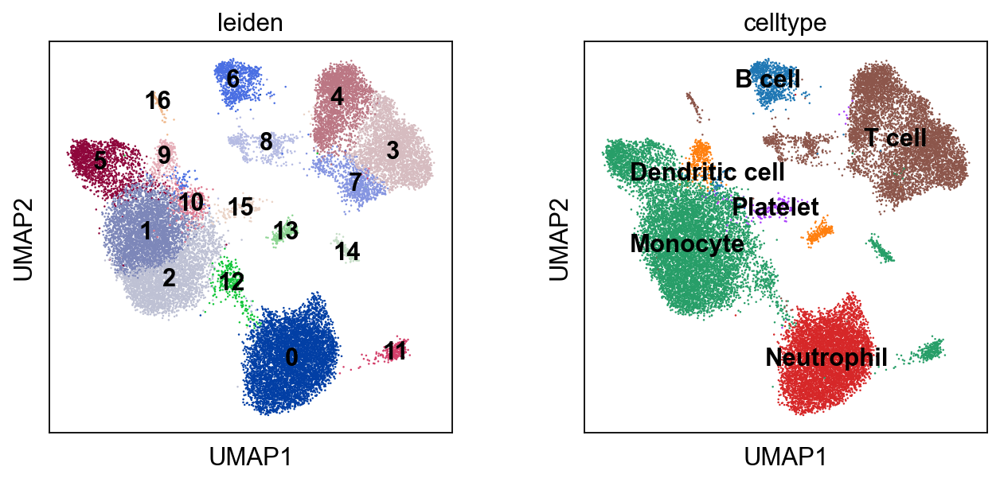

In [245]:
sc.pl.umap(adata, color=['leiden','celltype'],legend_loc='on data')

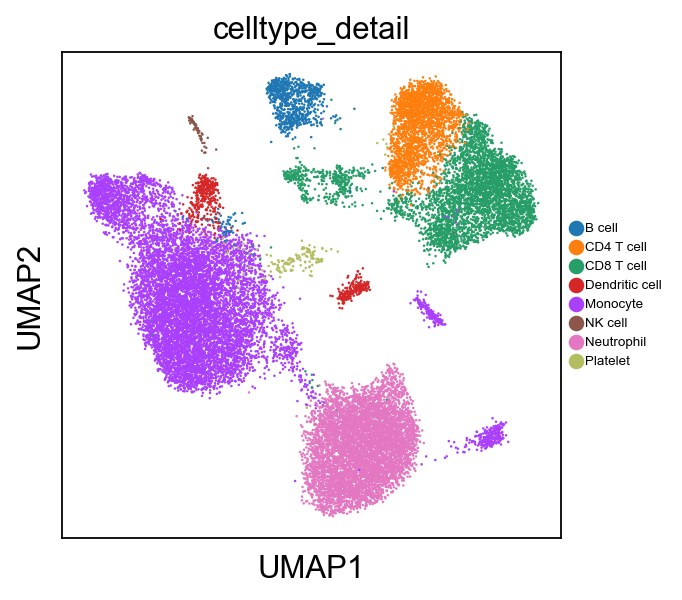

In [37]:
#T cell                      '3','4',              '7','8',        '10',              '14','15'
#CD8 T cell                  '3',                      '8'
#CD4 T cell                      '4','5',                                             '15','16'
#T exhausted cell            '3',                  '7','8',    '10',                   '15'
#T effector cell             '3',                  '7',        '10',                   '15',
#NK cell                     '3',                  '7'
#B cell                                  '6'                                                                                          '11'                                            ,'22'                  

#Neutorphil       '0'
#DC                                                       '9',               '13'
#Monocyte_2          '1','2',        '5',                 '9','10','11','12',    '14','15'
#Platelet                                                                             '15'
# Fill in the clusters that belong to each cell type based on each marker in the plot above
cell_dict = {'CD8 T cell':      [           '3'                 ,'7'   ,'8'],
             'CD4 T cell':      [              '4'                                                        ],
             'NK cell':         [                                                                         '16'],
            
             'B cell':         [                        '6' ],
             'Monocyte':       [    '1','2',        '5',                    '10','11','12',     '14'], 
             'Dendritic cell': [                                         '9',               '13'],
             'Neutrophil':     ['0'],
             'Platelet'  :     [                                                                     '15']
            }

# Initialize empty column in cell metadata
adata.obs['celltype_detail'] = np.nan

# Generate new assignments
for i in cell_dict.keys():
    ind = pd.Series(adata.obs.leiden).isin(cell_dict[i])
    adata.obs.loc[ind,'celltype_detail'] = i

sc.pl.umap(adata, color=['celltype_detail'], legend_loc='right margin', legend_fontsize=6, save='_detail_celltype.pdf')



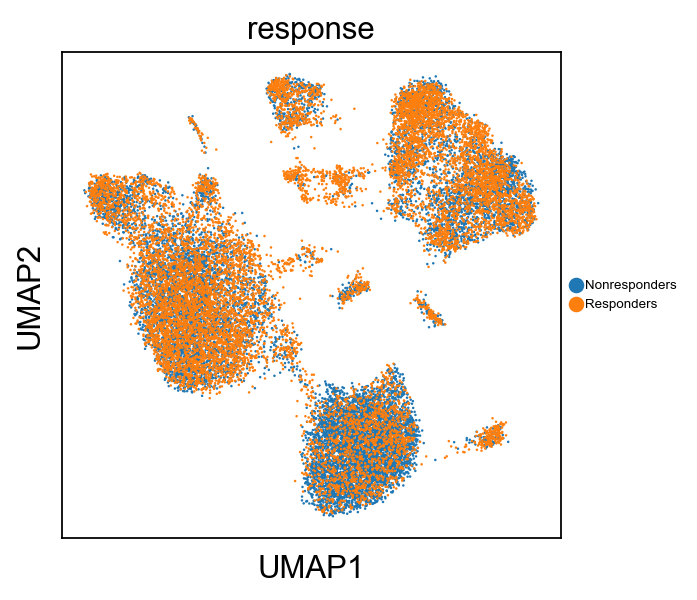

In [248]:
cell_dict = {'Responders':      ['responder_1','responder_2','responder_3'],
             'Nonresponders'  : ['nonresponder_1','nonresponder_2','nonresponder_3']
            }

# Initialize empty column in cell metadata
adata.obs['response'] = np.nan

# Generate new assignments
for i in cell_dict.keys():
    ind = pd.Series(adata.obs.patient).isin(cell_dict[i])
    adata.obs.loc[ind,'response'] = i

sc.pl.umap(adata, color=['response'], legend_loc='right margin', legend_fontsize=6, save='_response.pdf')


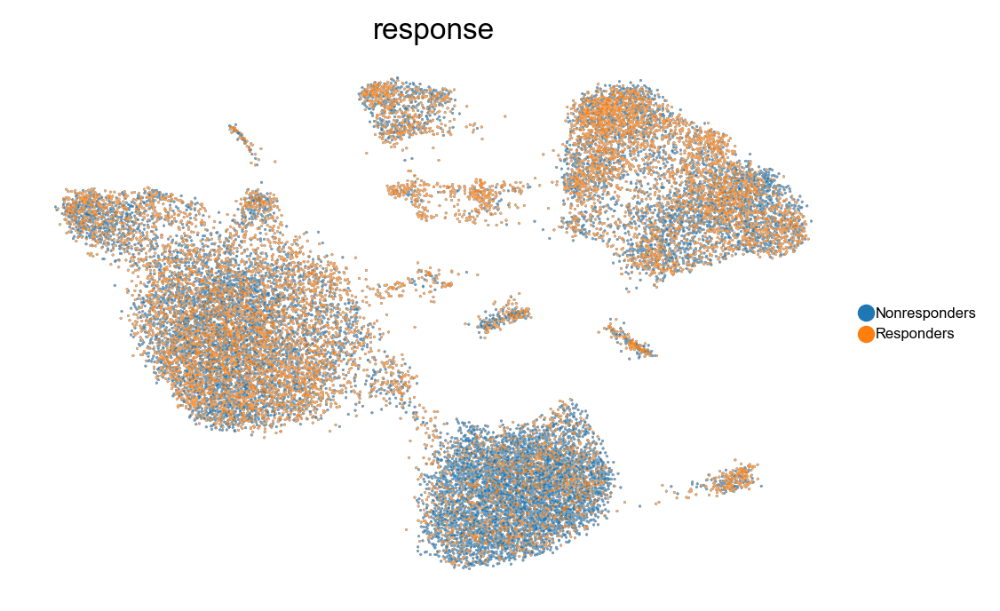

In [9]:
sc.pl.umap(adata, color=['response'], legend_loc='right margin', legend_fontsize=6,frameon=False,add_outline=True, outline_width=(0.05,0.05), size=3, use_raw=True, save='_response.pdf')

In [7]:
scv.set_figure_params(style='scvelo', dpi=100, dpi_save=300, frameon=None)

saving figure to file ./figures/scvelo__scatterplot_by_response.pdf


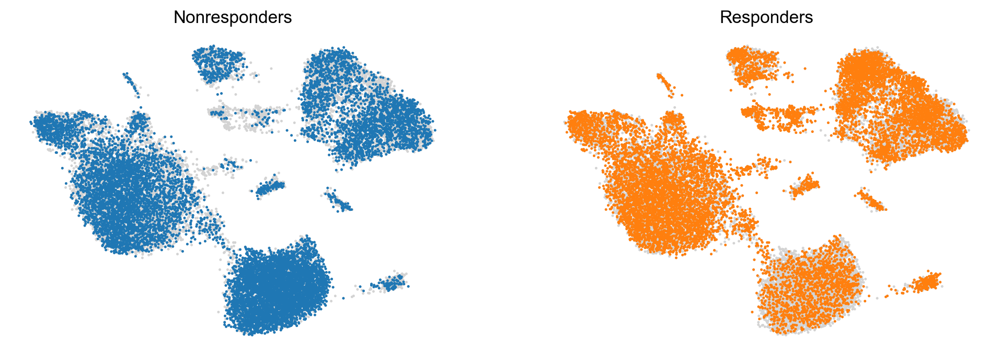

In [8]:
scv.pl.scatter(adata, groups=[[c] for c in adata.obs['response'].cat.categories], color='response', ncols=4, save="_scatterplot_by_response.pdf")

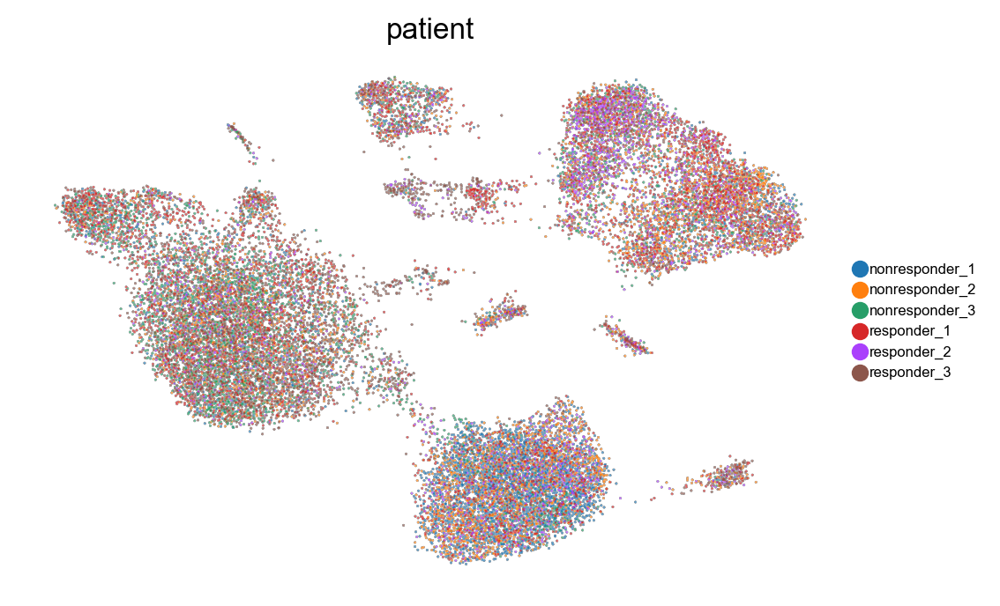

In [10]:
sc.pl.umap(adata, color=['patient'], legend_loc='right margin', legend_fontsize=6,frameon=False,add_outline=True, outline_width=(0.05,0.05), size=3, use_raw=True, save='_patient.pdf')

In [11]:
scv.set_figure_params(style='scvelo', dpi=100, dpi_save=300, frameon=None)

saving figure to file ./figures/scvelo__scatterplot_by_patient.pdf


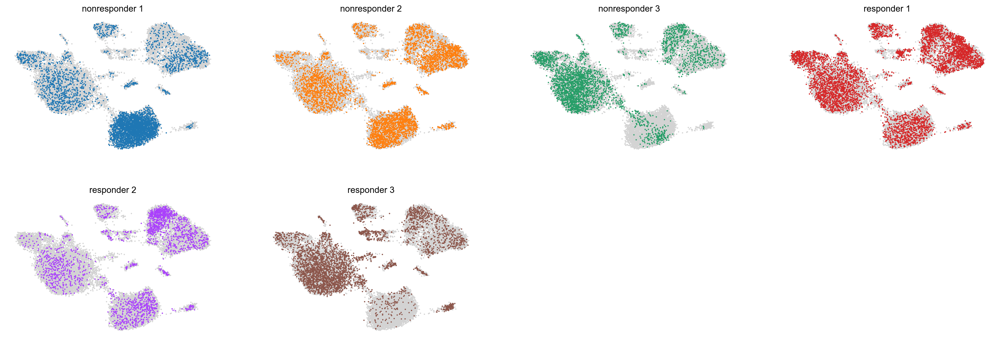

In [12]:
scv.pl.scatter(adata, groups=[[c] for c in adata.obs['patient'].cat.categories], color='patient', ncols=4, save="_scatterplot_by_patient.pdf")

In [ ]:
sc.pl.umap(adata, color=['patient'], save='_patient.pdf')

In [39]:
adata.write('all_patients_final.h5ad', compression='gzip')

In [32]:
adata = sc.read('all_patients_final.h5ad')

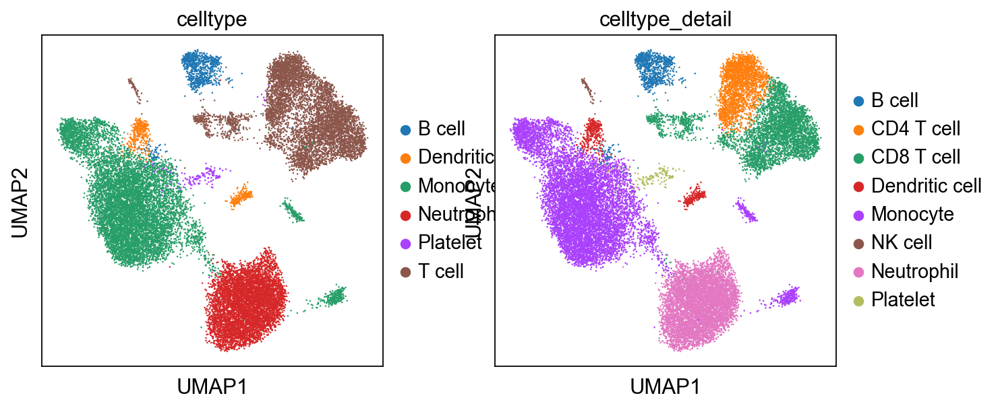

In [38]:
sc.pl.umap(adata, color=['celltype','celltype_detail'])

In [250]:
adata_nonr = adata[adata.obs['response']=='Nonresponders']
adata_nonr

View of AnnData object with n_obs × n_vars = 12245 × 11409
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'patient', 'file_name', 'leiden', 'batch', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'celltype', 'crude', 'celltype_detail', 'response'
    var: 'gene_ids', 'mt', 'n_cells-0', 'n_cells_by_counts-0', 'mean_counts-0', 'pct_dropout_by_counts-0', 'total_counts-0', 'n_cells-1', 'n_cells_by_counts-1', 'mean_counts-1', 'pct_dropout_by_counts-1', 'total_counts-1', 'n_cells-2', 'n_cells_by_counts-2', 'mean_counts-2', 'pct_dropout_by_counts-2', 'total_counts-2', 'n_cells-3', 'n_cells_by_counts-3', 'mean_counts-3', 'pct_dropout_by_counts-3', 'total_counts-3', 'n_cells-4', 'n_cells_by_counts-4', 'mean_counts-4', 'pct_dropout_by_counts-4', 'total_counts-4', 'n_cells-5', 'n_cells_by_counts-5', 'mean_counts-5', 'pct_dropout_by_counts-5', 'total_counts-5', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_

In [251]:
adata_r = adata[adata.obs['response']=='Responders']
adata_r

View of AnnData object with n_obs × n_vars = 11268 × 11409
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'patient', 'file_name', 'leiden', 'batch', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'celltype', 'crude', 'celltype_detail', 'response'
    var: 'gene_ids', 'mt', 'n_cells-0', 'n_cells_by_counts-0', 'mean_counts-0', 'pct_dropout_by_counts-0', 'total_counts-0', 'n_cells-1', 'n_cells_by_counts-1', 'mean_counts-1', 'pct_dropout_by_counts-1', 'total_counts-1', 'n_cells-2', 'n_cells_by_counts-2', 'mean_counts-2', 'pct_dropout_by_counts-2', 'total_counts-2', 'n_cells-3', 'n_cells_by_counts-3', 'mean_counts-3', 'pct_dropout_by_counts-3', 'total_counts-3', 'n_cells-4', 'n_cells_by_counts-4', 'mean_counts-4', 'pct_dropout_by_counts-4', 'total_counts-4', 'n_cells-5', 'n_cells_by_counts-5', 'mean_counts-5', 'pct_dropout_by_counts-5', 'total_counts-5', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_

In [252]:
adata_nonr.write('Nonresponders.h5ad', compression='gzip')
adata_r.write('Responders.h5ad', compression='gzip')

In [273]:
adata.obs

,n_genes,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,patient,file_name,leiden,batch,total_counts_ribo,pct_counts_ribo,total_counts_hb,pct_counts_hb,celltype,crude,celltype_detail,response
CTTGCCGTCGGA-0,3741,3635,1397.243774,19.050234,1.363415,nonresponder_1,PD1-D1,8,0,101.290787,7.249329,1.210672,0.086647,T cell,NaN,Monocyte,Nonresponders
CGAGTCACACAT-0,3563,3487,1407.560303,23.679771,1.682327,nonresponder_1,PD1-D1,5,0,105.904358,7.523966,1.038069,0.073750,Monocyte,NaN,Monocyte,Nonresponders
GAGCGACTGGCT-0,3339,3279,1409.313477,22.003889,1.561320,nonresponder_1,PD1-D1,1,0,86.078606,6.107840,0.662683,0.047022,Monocyte,NaN,Monocyte,Nonresponders
CCTTCACGATTC-0,3410,3346,1409.737183,20.661764,1.465647,nonresponder_1,PD1-D1,5,0,83.888268,5.950632,1.622554,0.115096,Monocyte,NaN,Monocyte,Nonresponders
TACATCATATTG-0,3188,3122,1406.716797,21.422604,1.522880,nonresponder_1,PD1-D1,10,0,114.737907,8.156433,1.387298,0.098620,Monocyte,NaN,Monocyte,Nonresponders
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
AAAGCTGCGCGC-5,608,593,2097.263916,75.106140,3.581149,responder_3,PD1-S3,6,5,265.869873,12.676987,4.590319,0.218872,B cell,NaN,B cell,Responders
GCTCACGGCAGG-5,560,541,2078.378662,57.489052,2.766053,responder_3,PD1-S3,3,5,346.141968,16.654423,8.568939,0.412290,T cell,NaN,NK cell,Responders
GTAAATTAGCCA-5,609,599,2114.809326,59.998657,2.837072,responder_3,PD1-S3,2,5,156.074402,7.380070,9.884173,0.467379,Monocyte,NaN,Monocyte,Responders
TCCCCCGTAAAA-5,581,575,2124.718262,27.837864,1.310191,responder_3,PD1-S3,2,5,177.390732,8.348906,0.000000,0.000000,Monocyte,NaN,Monocyte,Responders


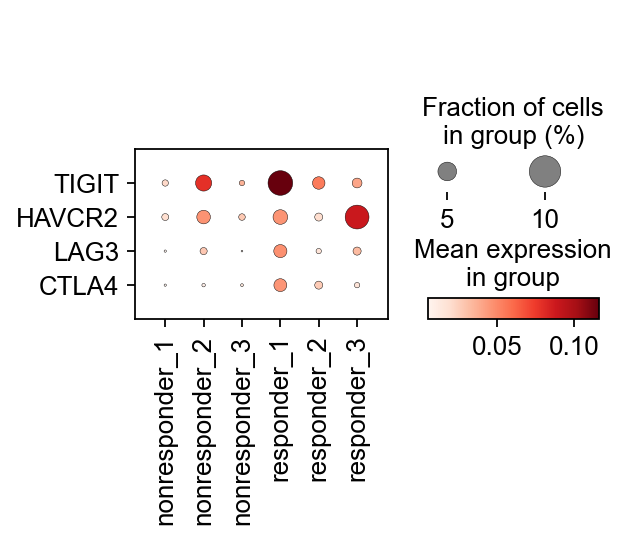

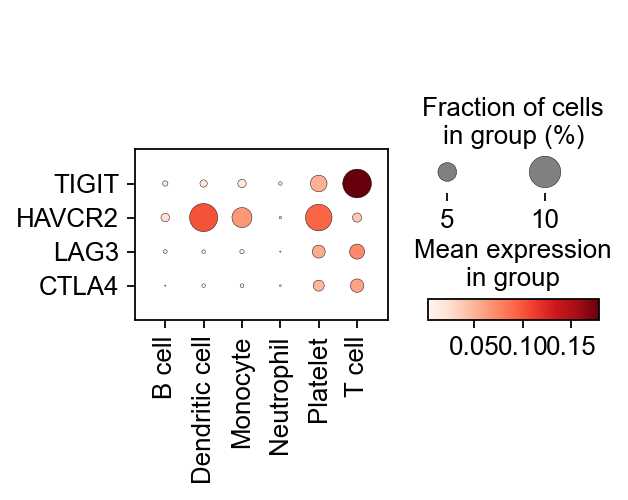

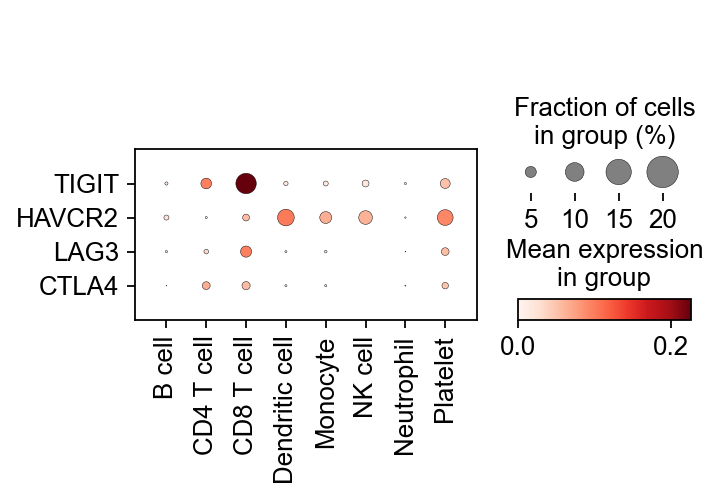

In [58]:
sc.pl.dotplot(adata, ['TIGIT','HAVCR2','LAG3','CTLA4'] , groupby='patient', swap_axes=True, save='_exhausted_T_markers_in_patient.pdf')
sc.pl.dotplot(adata, ['TIGIT','HAVCR2','LAG3','CTLA4'] , groupby='celltype', swap_axes=True, save='_exhausted_T_markers_in_crude_celltype.pdf')
sc.pl.dotplot(adata, ['TIGIT','HAVCR2','LAG3','CTLA4'] , groupby='celltype_detail', swap_axes=True, save='_exhausted_T_markers_in_celltype_detail.pdf')

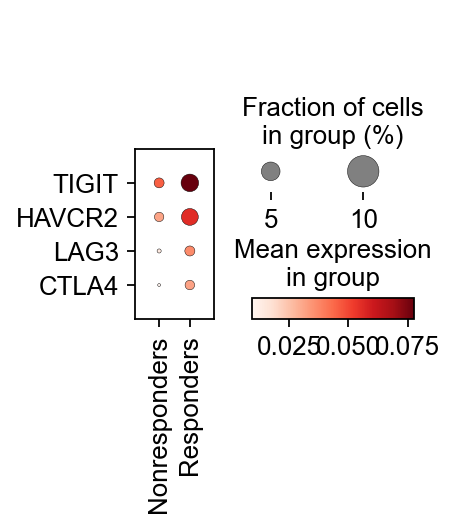

In [275]:
sc.pl.dotplot(adata, ['TIGIT','HAVCR2','LAG3','CTLA4'] , groupby='response', swap_axes=True, save='_exhausted_T_markers_in_response.pdf')

In [299]:
sc.settings.set_figure_params(dpi=80,dpi_save=300, facecolor='white', format='tif')

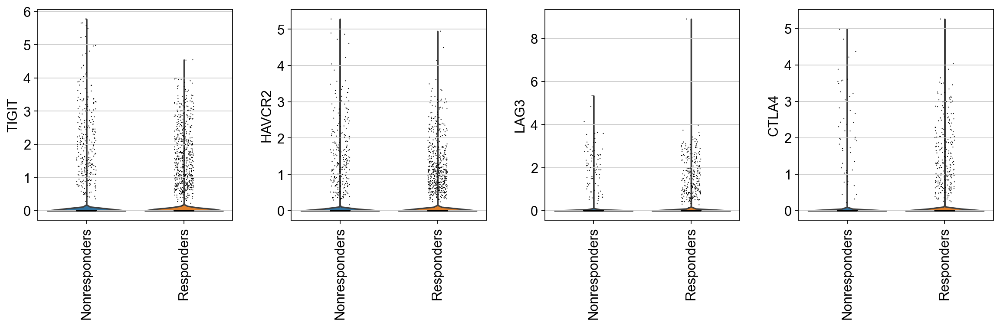

In [300]:
sc.pl.violin(adata, keys=['TIGIT','HAVCR2','LAG3','CTLA4'], groupby='response',
    rotation=90, save='_exhausted_T_markeres_in_all_cell_by_response.tif')

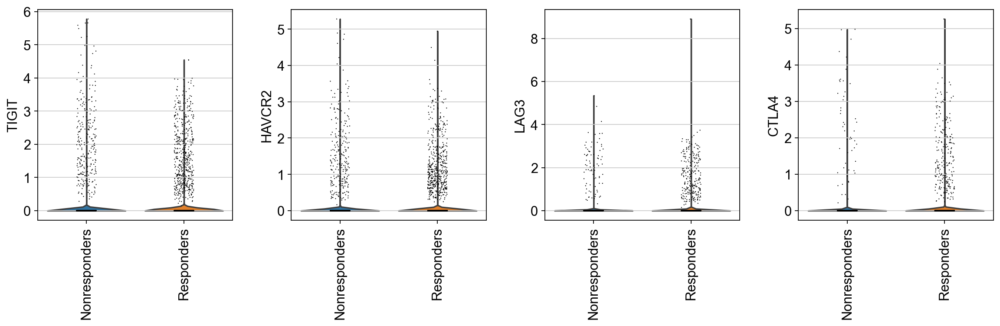

In [295]:
sc.pl.violin(adata, keys=['TIGIT','HAVCR2','LAG3','CTLA4'], groupby='response',
    rotation=90, save='_exhausted_T_markeres_in_all_cell_by_response.pdf')

In [296]:
sc.tl.rank_genes_groups(adata, 'response', method='t-test')

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:14)


In [297]:
result_2_3 = adata.uns['rank_genes_groups']
groups = result_2_3['names'].dtype.names
pval_table_2_3 = pd.DataFrame(
            {group + '_' + key[:2]: result_2_3[key][group]
            for group in groups for key in ['names','logfoldchanges', 'pvals_adj']})
pval_table_2_3

,Nonresponders_na,Nonresponders_lo,Nonresponders_pv,Responders_na,Responders_lo,Responders_pv
0,FCGR3B,1.902635,0.000000e+00,MT2A,3.738669,0.000000e+00
1,CSF3R,1.442203,4.378190e-290,MT1X,4.023088,0.000000e+00
2,CYP4F3,2.067952,9.532016e-211,MT1E,3.919707,0.000000e+00
3,KIAA1551,1.300329,6.110777e-210,BEST1,2.416867,0.000000e+00
4,CXCR2,1.392789,8.720280e-198,MT1G,4.294706,0.000000e+00
...,...,...,...,...,...,...
11404,MT1G,-4.294706,0.000000e+00,CXCR2,-1.392789,8.720280e-198
11405,BEST1,-2.416867,0.000000e+00,KIAA1551,-1.300329,6.110777e-210
11406,MT1E,-3.919707,0.000000e+00,CYP4F3,-2.067952,9.532016e-211
11407,MT1X,-4.023088,0.000000e+00,CSF3R,-1.442203,4.378190e-290


In [298]:
pval_table_2_3.loc[pval_table_2_3['Responders_na'].isin(['TIGIT','HAVCR2','LAG3','CTLA4'])]

,Nonresponders_na,Nonresponders_lo,Nonresponders_pv,Responders_na,Responders_lo,Responders_pv
2679,AC005726.1,-0.540440,0.173666,CTLA4,1.782600,1.168623e-14
3141,POLR1E,-0.450228,0.066755,LAG3,1.420065,3.023566e-12
3541,MYOF,-0.257340,0.024263,HAVCR2,0.851097,1.314562e-10
3628,DOT1L,-0.492001,0.018891,TIGIT,0.795450,2.658652e-10


In [264]:
adata.obs['celltype']

CTTGCCGTCGGA-0      T cell
CGAGTCACACAT-0    Monocyte
GAGCGACTGGCT-0    Monocyte
CCTTCACGATTC-0    Monocyte
TACATCATATTG-0    Monocyte
                    ...   
AAAGCTGCGCGC-5      B cell
GCTCACGGCAGG-5      T cell
GTAAATTAGCCA-5    Monocyte
TCCCCCGTAAAA-5    Monocyte
TTGCCTTCGAAT-5      T cell
Name: celltype, Length: 23513, dtype: category
Categories (6, object): ['B cell', 'Dendritic cell', 'Monocyte', 'Neutrophil', 'Platelet', 'T cell']

# T cell subgroup

In [40]:
adata_T = adata[adata.obs['celltype']=='T cell']
adata_T

View of AnnData object with n_obs × n_vars = 6394 × 11409
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'patient', 'file_name', 'leiden', 'batch', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'celltype', 'crude', 'celltype_detail', 'response'
    var: 'gene_ids', 'mt', 'n_cells-0', 'n_cells_by_counts-0', 'mean_counts-0', 'pct_dropout_by_counts-0', 'total_counts-0', 'n_cells-1', 'n_cells_by_counts-1', 'mean_counts-1', 'pct_dropout_by_counts-1', 'total_counts-1', 'n_cells-2', 'n_cells_by_counts-2', 'mean_counts-2', 'pct_dropout_by_counts-2', 'total_counts-2', 'n_cells-3', 'n_cells_by_counts-3', 'mean_counts-3', 'pct_dropout_by_counts-3', 'total_counts-3', 'n_cells-4', 'n_cells_by_counts-4', 'mean_counts-4', 'pct_dropout_by_counts-4', 'total_counts-4', 'n_cells-5', 'n_cells_by_counts-5', 'mean_counts-5', 'pct_dropout_by_counts-5', 'total_counts-5', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_b

In [266]:
pd.crosstab(adata_T.obs['response'], adata_T.obs['response'])

response,Nonresponders,Responders
response,,
Nonresponders,2557,0
Responders,0,3837


In [41]:
pd.crosstab(adata_T.obs['response'], adata_T.obs['celltype_detail'])

celltype_detail,CD4 T cell,CD8 T cell,NK cell
response,,,
Nonresponders,775,1752,30
Responders,1478,2313,46


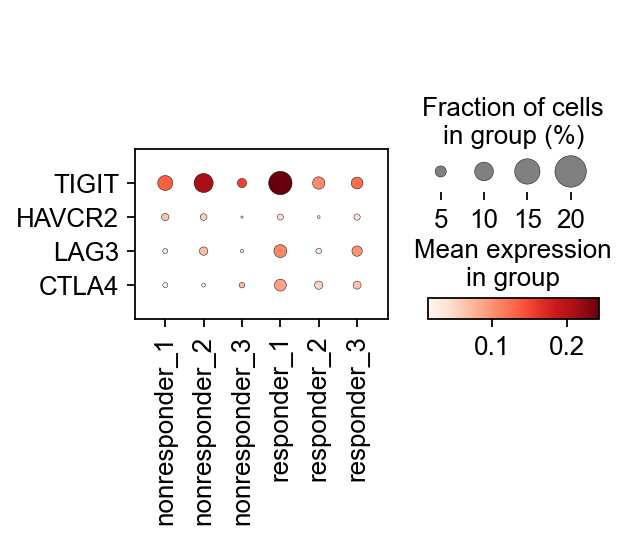

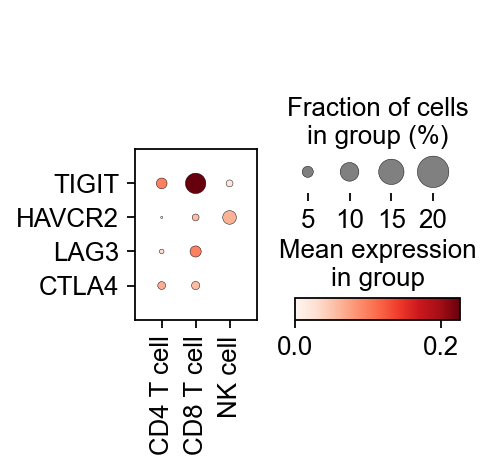

In [43]:
# edited
sc.pl.dotplot(adata_T, ['TIGIT','HAVCR2','LAG3','CTLA4'] , groupby='patient', swap_axes=True, save='_exhausted_T_markers_in_T_cell_by_patient.pdf')
sc.pl.dotplot(adata_T, ['TIGIT','HAVCR2','LAG3','CTLA4'] , groupby='celltype_detail', swap_axes=True, save='_exhausted_T_markers_in_T_cell_by_celltype_detail.pdf')

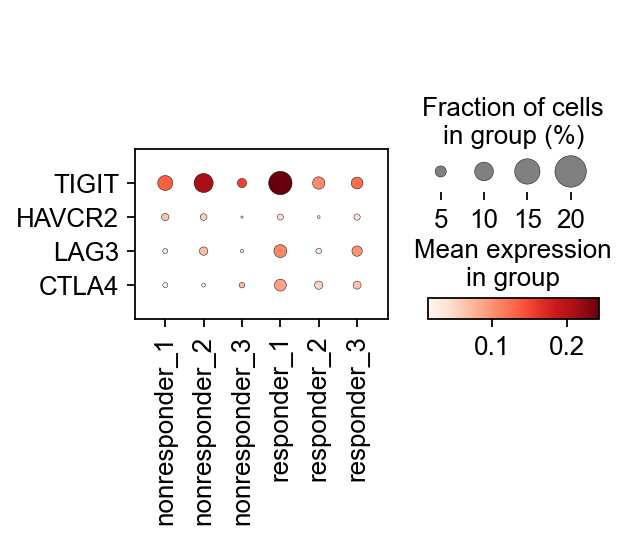

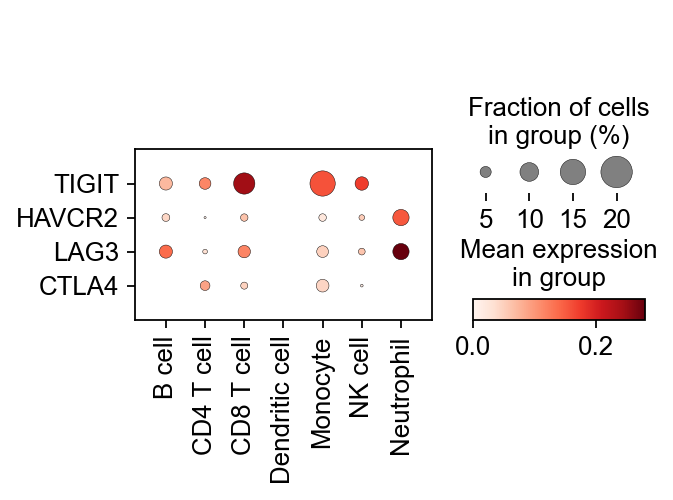

In [276]:
#sc.pl.dotplot(adata_T, ['TIGIT','HAVCR2','LAG3','CTLA4'] , groupby='patient', swap_axes=True, save='_exhausted_T_markers_in_T_cell_by_patient.pdf')
#sc.pl.dotplot(adata_T, ['TIGIT','HAVCR2','LAG3','CTLA4'] , groupby='celltype_detail', swap_axes=True, save='_exhausted_T_markers_in_T_cell_by_celltype_detail.pdf')

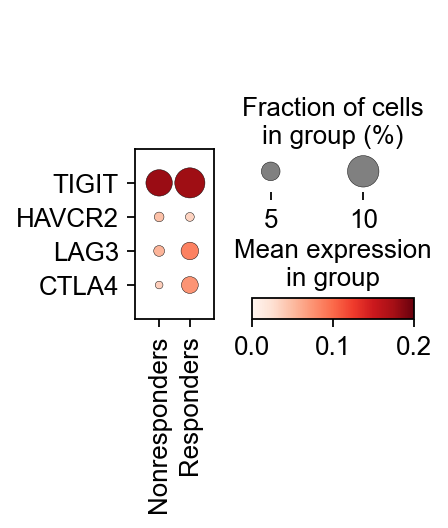

In [48]:
#edited
sc.pl.dotplot(adata_T, ['TIGIT','HAVCR2','LAG3','CTLA4'],vmin=0, vmax=0.2 , groupby='response', swap_axes=True, save='_exhausted_T_markers_in_T_cell_by_response.pdf')

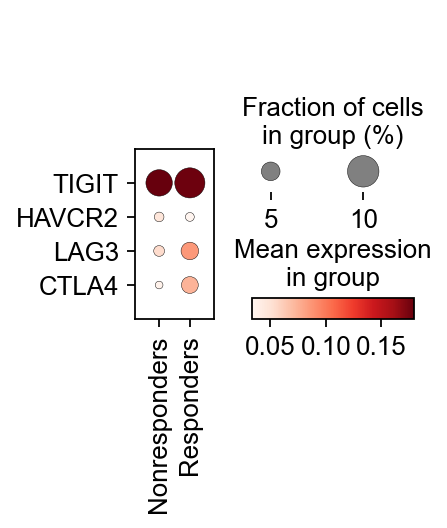

In [294]:
#sc.pl.dotplot(adata_T, ['TIGIT','HAVCR2','LAG3','CTLA4'] , groupby='response', swap_axes=True, save='_exhausted_T_markers_in_T_cell_by_response.pdf')

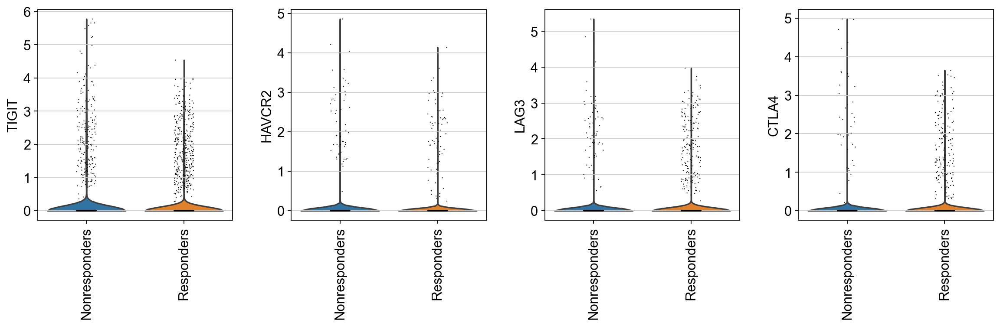

In [49]:
#edited
sc.pl.violin(adata_T, keys=['TIGIT','HAVCR2','LAG3','CTLA4'], groupby='response',
    rotation=90, save='_exhausted_T_markeres_in_T_cell_by_response.pdf')

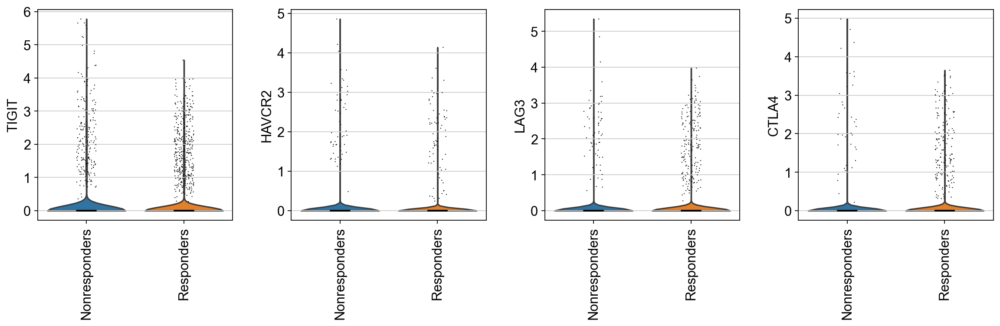

In [284]:
sc.pl.violin(adata_T, keys=['TIGIT','HAVCR2','LAG3','CTLA4'], groupby='response',
    rotation=90, save='_exhausted_T_markeres_in_T_cell_by_response.pdf')

In [50]:
sc.tl.rank_genes_groups(adata_T, 'response', method='t-test')

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:04)


In [51]:
result_2_4 = adata_T.uns['rank_genes_groups']
groups = result_2_4['names'].dtype.names
pval_table_2_4 = pd.DataFrame(
            {group + '_' + key[:2]: result_2_4[key][group]
            for group in groups for key in ['names','logfoldchanges', 'pvals_adj']})
pval_table_2_4

,Nonresponders_na,Nonresponders_lo,Nonresponders_pv,Responders_na,Responders_lo,Responders_pv
0,CSF3R,1.063198,3.099685e-39,MT2A,4.058000,0.000000e+00
1,FCGR3B,1.072119,1.868145e-36,MT1E,4.477432,0.000000e+00
2,KLRD1,1.167628,1.799981e-32,MT1X,4.149745,0.000000e+00
3,PRF1,1.127326,7.537910e-32,BEST1,2.993749,6.603879e-259
4,CYP4F3,1.931685,1.734568e-28,KRAS,2.653550,1.163384e-198
...,...,...,...,...,...,...
11404,KRAS,-2.653550,1.163384e-198,CYP4F3,-1.931685,1.734568e-28
11405,BEST1,-2.993749,6.603879e-259,PRF1,-1.127326,7.537910e-32
11406,MT1X,-4.149745,0.000000e+00,KLRD1,-1.167628,1.799981e-32
11407,MT1E,-4.477432,0.000000e+00,FCGR3B,-1.072119,1.868145e-36


In [52]:
pval_table_2_4.loc[pval_table_2_4['Responders_na'].isin(['TIGIT','HAVCR2','LAG3','CTLA4'])]

,Nonresponders_na,Nonresponders_lo,Nonresponders_pv,Responders_na,Responders_lo,Responders_pv
1659,FAM160A2,0.156793,7.297759e-01,CTLA4,1.025701,0.000327
2551,KIAA0232,-0.002016,9.926755e-01,LAG3,0.690882,0.007050
9117,SETD2,-0.374133,3.541171e-03,TIGIT,-0.019686,0.933344
10792,PKM,-0.742462,5.347243e-09,HAVCR2,-0.486592,0.205355


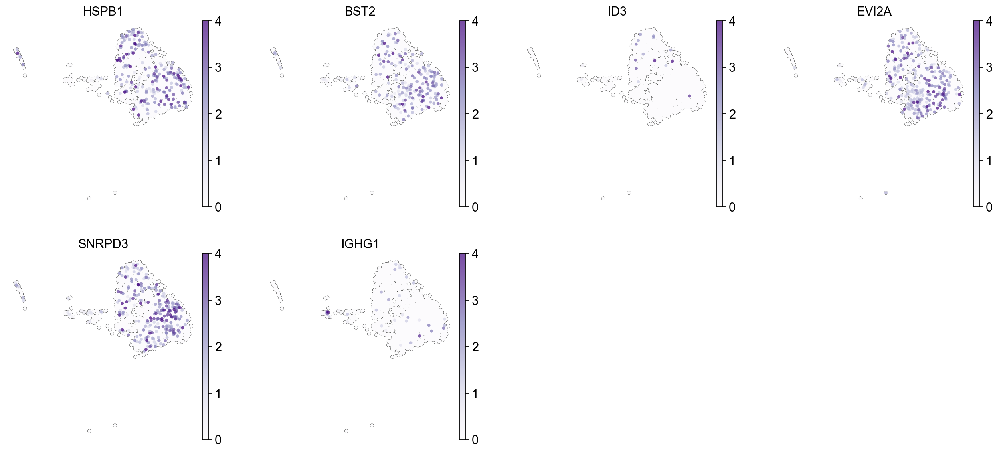

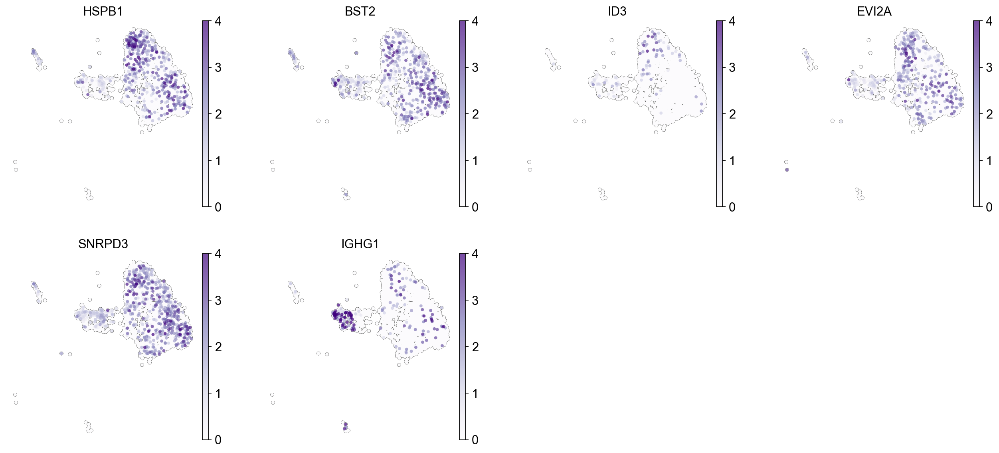

In [53]:
# T cell markers for MaT4 and MbT2
Marker_MaT4_MbT2 = ['HSPB1','BST2','ID3',#'HLAD-QA1',
                    'EVI2A',#'SNHG32',
                    'SNRPD3',#'IGLC1',
                    'IGHG1']
sc.pl.umap(adata_T[adata_T.obs['response']=='Nonresponders'], color=Marker_MaT4_MbT2, legend_loc='right margin', frameon=False, vmin=0,vmax=4,add_outline=True, outline_width=(0.05,0.05), size=50, use_raw=True, cmap='Purples')
sc.pl.umap(adata_T[adata_T.obs['response']=='Responders'], color=Marker_MaT4_MbT2, legend_loc='right margin', frameon=False, vmin=0,vmax=4,add_outline=True, outline_width=(0.05,0.05), size=50, use_raw=True, cmap='Purples')

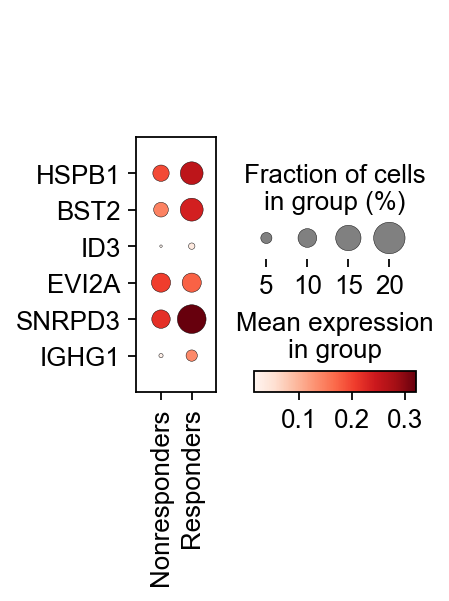

In [54]:
sc.pl.dotplot(adata[adata.obs['celltype']=='T cell'],Marker_MaT4_MbT2 , groupby='response', swap_axes=True)#, save='_exhausted_T_markers_in_response.pdf')

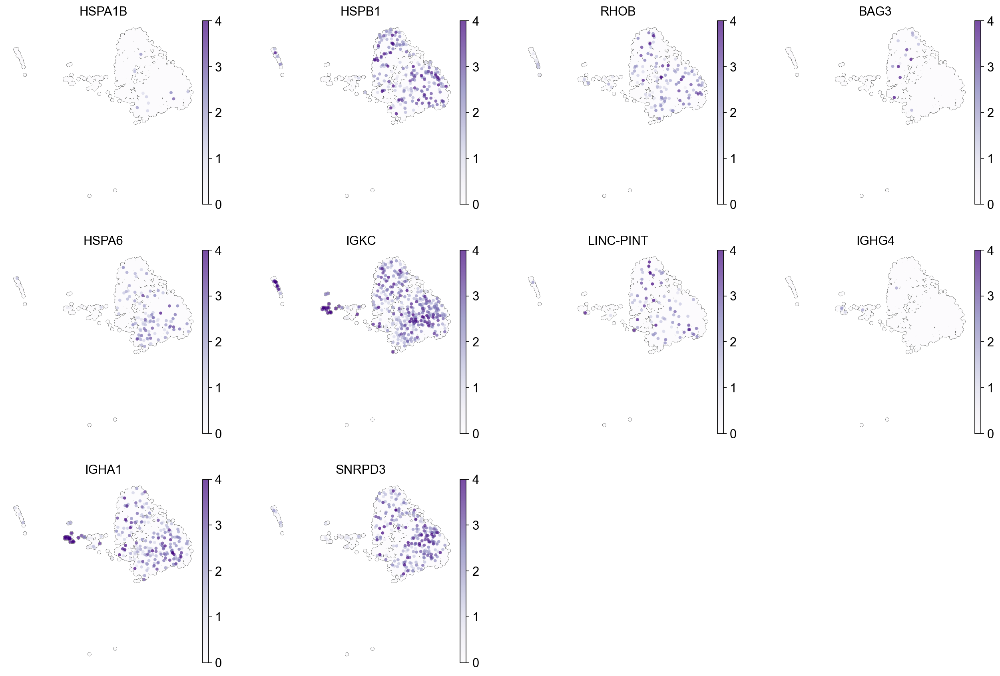

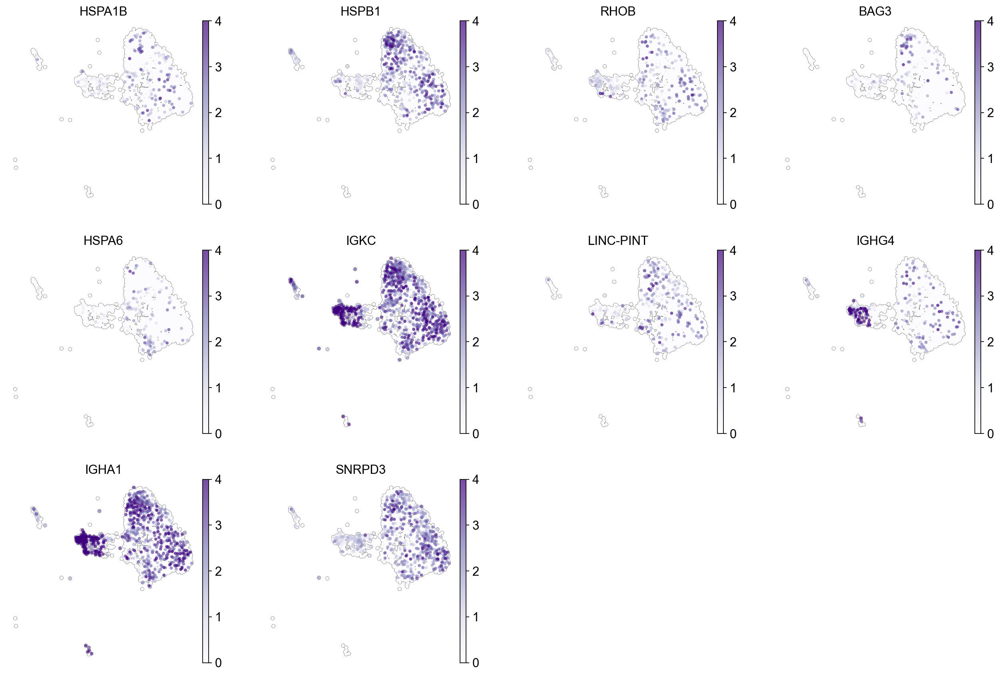

In [55]:
# T cell markers for F1T4 and F4T2
Marker_F1T4_F4T2 = ['HSPA1B','HSPB1','RHOB','BAG3','HSPA6',
                    'IGKC','LINC-PINT','IGHG4','IGHA1','SNRPD3']
sc.pl.umap(adata_T[adata_T.obs['response']=='Nonresponders'], color=Marker_F1T4_F4T2, legend_loc='right margin', frameon=False, vmin=0,vmax=4,add_outline=True, outline_width=(0.05,0.05), size=50, use_raw=True, cmap='Purples')
sc.pl.umap(adata_T[adata_T.obs['response']=='Responders'], color=Marker_F1T4_F4T2, legend_loc='right margin', frameon=False, vmin=0,vmax=4,add_outline=True, outline_width=(0.05,0.05), size=50, use_raw=True, cmap='Purples')

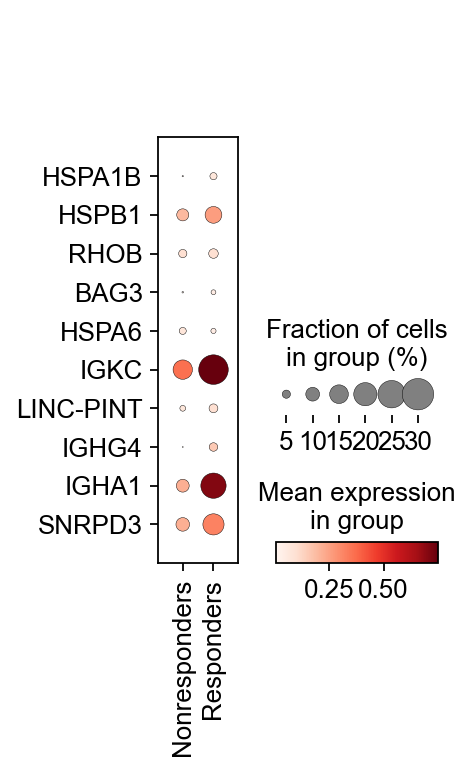

In [56]:
sc.pl.dotplot(adata[adata.obs['celltype']=='T cell'],Marker_F1T4_F4T2 , groupby='response', swap_axes=True)#, save='_exhausted_T_markers_in_response.pdf')

In [57]:
adata_T.write('T_cell_isolated.h5ad', compression='gzip')

# Start from here (05-07-23)

In [6]:
adata_T = sc.read('T_cell_isolated.h5ad')

In [8]:
adata_T.obs['response'].cat.reorder_categories(['Responders', 'Nonresponders'], inplace = True)

In [8]:
adata_T.obs

,n_genes,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,patient,file_name,leiden,batch,total_counts_ribo,pct_counts_ribo,total_counts_hb,pct_counts_hb,celltype,crude,celltype_detail,response
CTTGCCGTCGGA-0,3741,3635,1397.243774,19.050234,1.363415,nonresponder_1,PD1-D1,8,0,101.290787,7.249329,1.210672,0.086647,T cell,NaN,CD8 T cell,Nonresponders
CATTGATCCAGT-0,2703,2634,1402.153442,21.471428,1.531318,nonresponder_1,PD1-D1,8,0,116.315269,8.295473,1.858456,0.132543,T cell,NaN,CD8 T cell,Nonresponders
GGCGACACGTAC-0,2184,2142,1405.822388,27.640001,1.966109,nonresponder_1,PD1-D1,8,0,137.818497,9.803408,1.999074,0.142200,T cell,NaN,CD8 T cell,Nonresponders
TAGCTAATGAAC-0,1730,1695,1401.805054,21.381281,1.525268,nonresponder_1,PD1-D1,8,0,134.718109,9.610331,1.546091,0.110293,T cell,NaN,CD8 T cell,Nonresponders
CACCTTGTCTGC-0,2022,1981,1401.692505,24.470905,1.745811,nonresponder_1,PD1-D1,8,0,134.183838,9.572987,0.503956,0.035953,T cell,NaN,CD8 T cell,Nonresponders
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTAAGAGCGATG-5,573,568,2128.075684,78.165314,3.673051,responder_3,PD1-S3,3,5,219.067154,10.294143,4.239720,0.199228,T cell,NaN,CD8 T cell,Responders
AATGTTGCCAAG-5,594,582,2106.455566,69.969345,3.321662,responder_3,PD1-S3,3,5,261.601166,12.419022,8.668961,0.411543,T cell,NaN,CD8 T cell,Responders
ATTCACGCAGGA-5,601,593,2120.158691,56.815372,2.679770,responder_3,PD1-S3,3,5,240.439865,11.340654,8.646555,0.407826,T cell,NaN,CD8 T cell,Responders
GCTCACGGCAGG-5,560,541,2078.378662,57.489052,2.766053,responder_3,PD1-S3,3,5,346.141968,16.654423,8.568939,0.412290,T cell,NaN,CD8 T cell,Responders


In [12]:
HSF1_genes = ["HSPA1A", "HSPA1B", "DNAJB1", "HSPB1", "HSP90AA1",
                         "HSPA6", "HSPA8", "HSPH1",# "SERPINH1",
              "UBB", "FKBP4", "MRPL18", "DEDD2", "HSP90AB1", "PTGES3", "DNAJB6"]

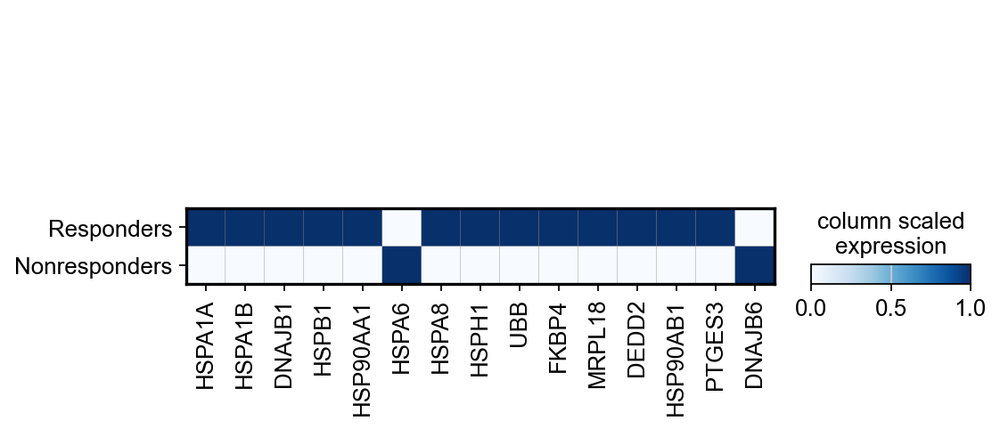

In [76]:
sc.pl.matrixplot(adata_T, HSF1_genes, 'response',  cmap='Blues', standard_scale='var', colorbar_title='column scaled\nexpression')

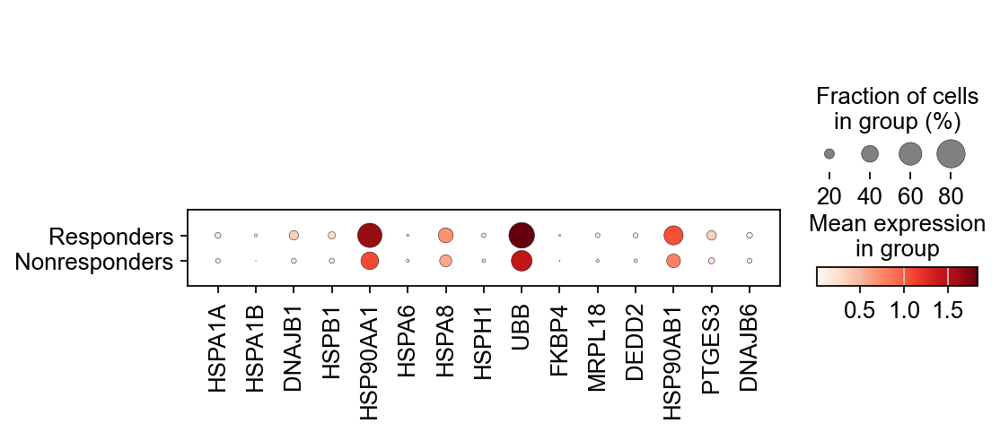

In [77]:
sc.pl.dotplot(adata_T, HSF1_genes, 'response')

In [78]:
# GOBP: M3T4 T cell + PBMC-R T cell shared
FGF_response= ['CCL5', #'CXCL13', 
               'ZFP36L2', 'GATA3', 'IQGAP1', 'FIBP', 'ITGB1BP1', 'ZFP36', 'CTNNB1', 'RUNX2', 'NR4A1', 'PTPN11',
               'SETX', 'RAB14']

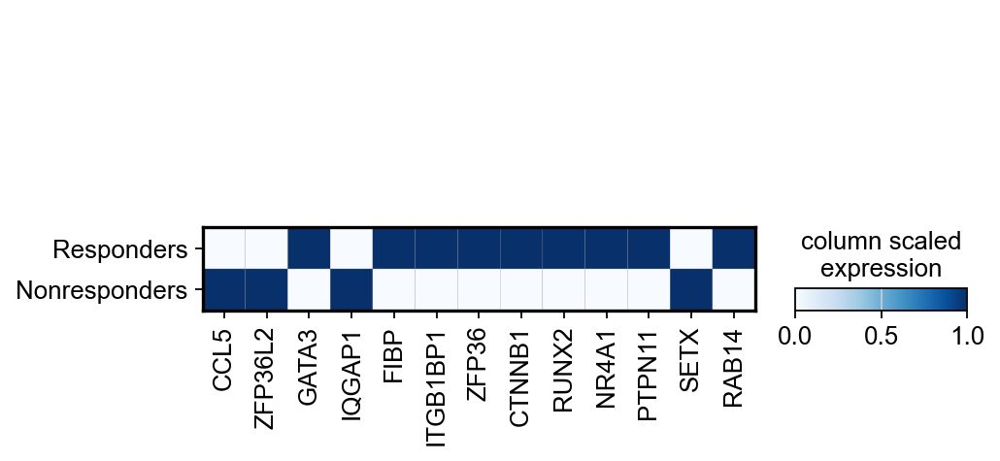

In [79]:
sc.pl.matrixplot(adata_T, FGF_response, 'response',  cmap='Blues', standard_scale='var', colorbar_title='column scaled\nexpression', save='_FGF_response_genes.pdf')

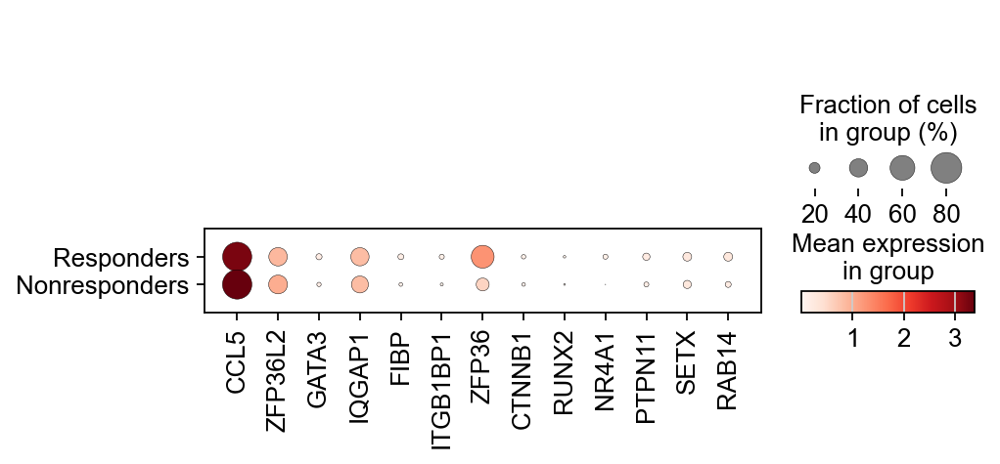

In [80]:
sc.pl.dotplot(adata_T, FGF_response, 'response', save='_FGF_response_genes.pdf')

In [81]:
# GOBP: M3T4 T cell + PBMC-R T cell shared
IFN_G_genes = ['HLA-DPA1', 
    'ISG15', 'HAVCR2', 'PTPN22', 'HLA-DRB1', 
    'GATA3', 'CD96', 'HLA-DPB1', 
    #'KLRK1', 
               'CRTAM', 'LGALS9',
               'PDE4D', #'SLC7A5', 'TNFSF4', 
               'ZC3H12A', 'CD3E', 'CD226', 'PYCARD', 'DDIT3', 'PDE4B', 'HMGB1', 'PRNP', 'BCL3',
               'BTN3A2', 'SLAMF6', 'XCL1']

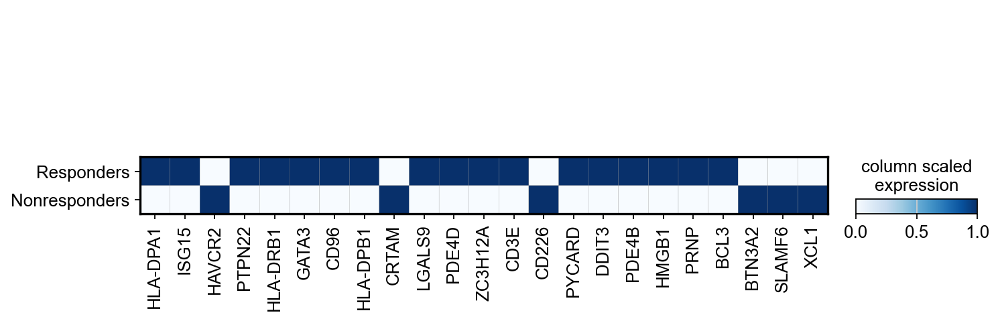

In [82]:
sc.pl.matrixplot(adata_T, IFN_G_genes, 'response',  cmap='Blues', standard_scale='var', colorbar_title='column scaled\nexpression',
                 save='_IFN-g_genes.pdf'
                )

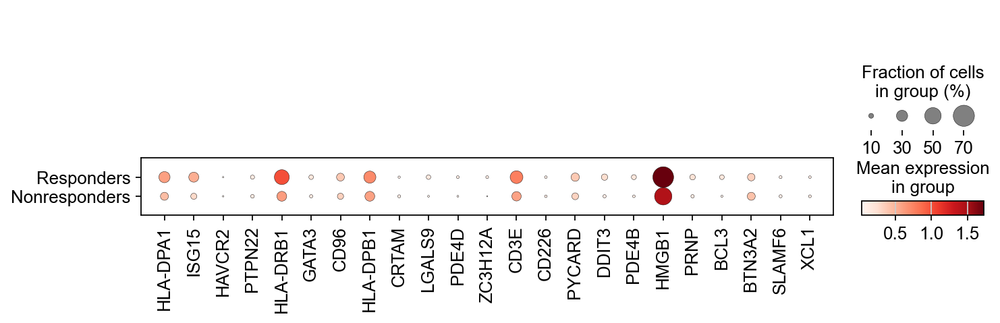

In [83]:
sc.pl.dotplot(adata_T, IFN_G_genes, 'response',
              save='_IFN-g_genes.pdf'
             )

In [84]:
# HSF1 : M1T4 specific
# FGF and IFN-gamma : M3T4 and Responders shared
sc.tl.score_genes(adata_T,HSF1_genes, score_name='HSF1_score')
sc.tl.score_genes(adata_T,FGF_response, score_name='FGF_score')
sc.tl.score_genes(adata_T,IFN_G_genes, score_name='IFN-gamma_score')

computing score 'HSF1_score'
    finished: added
    'HSF1_score', score of gene set (adata.obs).
    399 total control genes are used. (0:00:00)
computing score 'FGF_score'
    finished: added
    'FGF_score', score of gene set (adata.obs).
    459 total control genes are used. (0:00:00)
computing score 'IFN-gamma_score'
    finished: added
    'IFN-gamma_score', score of gene set (adata.obs).
    497 total control genes are used. (0:00:00)


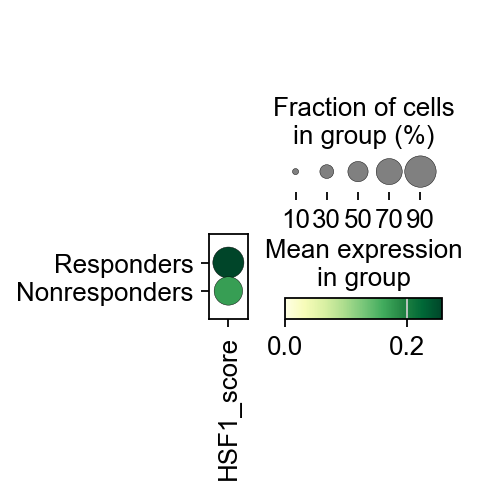

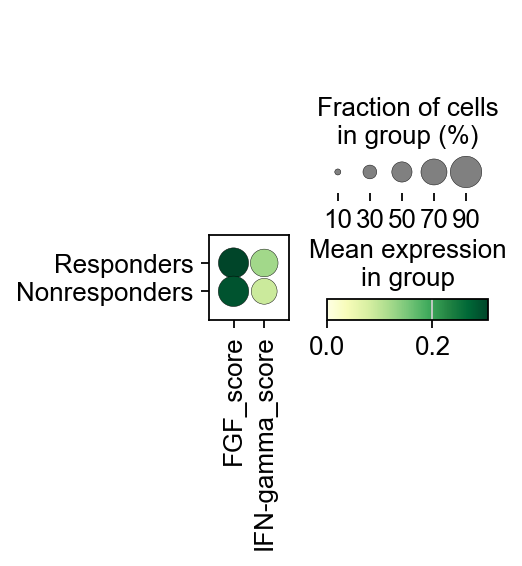

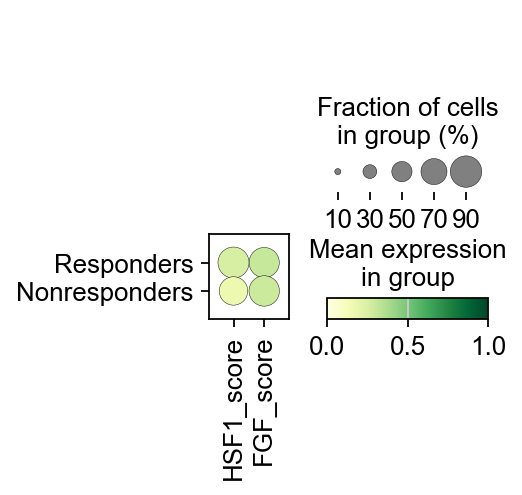

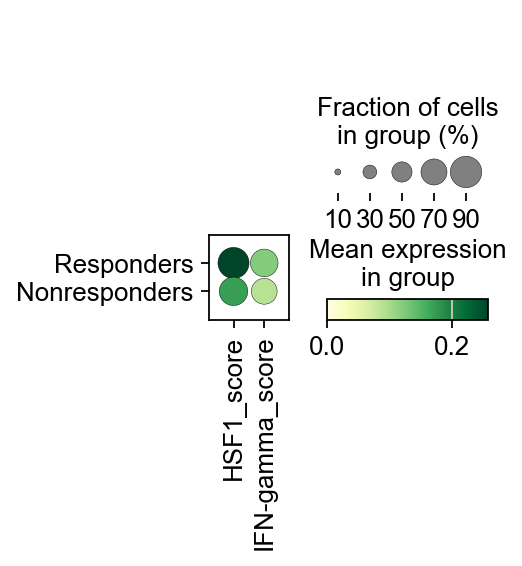

In [85]:
sc.pl.dotplot(adata_T, ['HSF1_score'],vmin=0.00,cmap='YlGn', groupby='response',
             save='_HSF1_score_in_PBMC_R_NR.pdf')
sc.pl.dotplot(adata_T, ['FGF_score','IFN-gamma_score'],vmin=0.00,cmap='YlGn', groupby='response',
             save='_FGF_IFN-gamma_score_in_PBMC_R_NR.pdf')

sc.pl.dotplot(adata_T, ['HSF1_score','FGF_score'],vmin=0.00,vmax=1,cmap='YlGn', groupby='response')
sc.pl.dotplot(adata_T, ['HSF1_score','IFN-gamma_score'],vmin=0.00,cmap='YlGn', groupby='response')

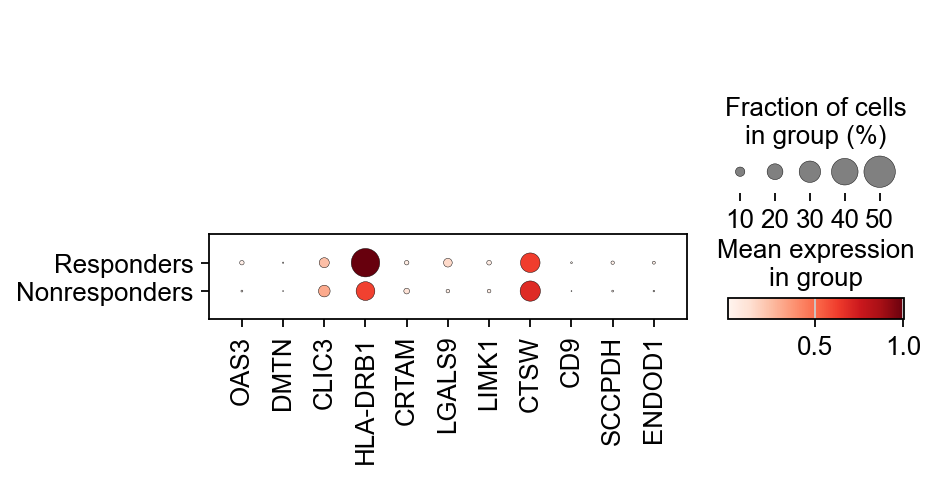

In [69]:
# assorted genes of m3t4 pathways
sc.pl.dotplot(adata_T, [#'CXCL13',
    'OAS3',#'DBN1',
    'DMTN','CLIC3','HLA-DRB1',
                         'CRTAM','LGALS9','LIMK1',
                         'CTSW','CD9','SCCPDH','ENDOD1',#'HECTD2'
], groupby='response')

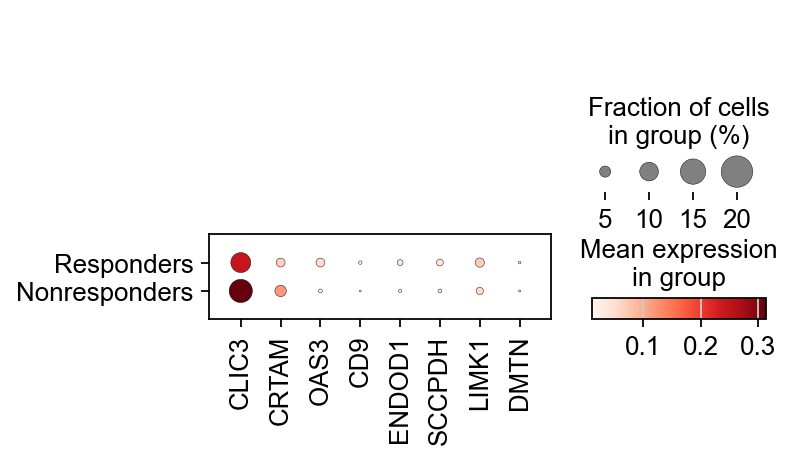

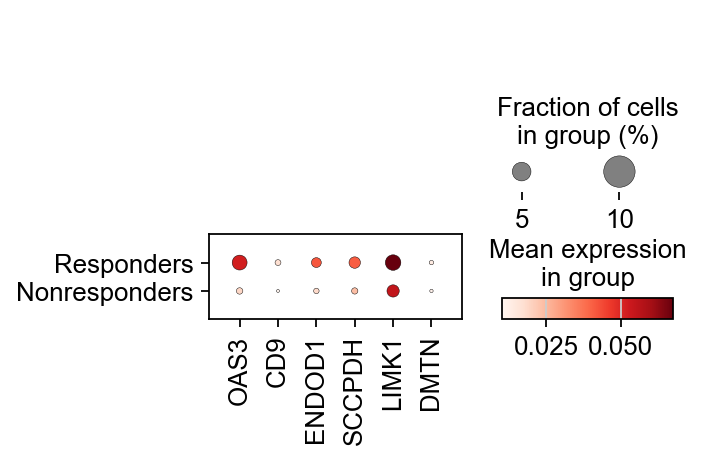

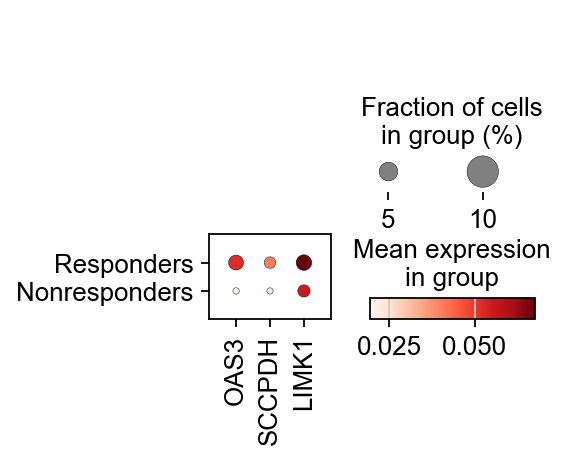

In [86]:
sc.pl.dotplot(adata_T, [
    'CLIC3','CRTAM','OAS3','CD9',#'DBN1',
    'ENDOD1','SCCPDH', 'LIMK1','DMTN',#'HECTD2'
                        #'CXCL13',#'HLA-DRB1',
                         #'CTSW','LGALS9',
    ], groupby='response')
sc.pl.dotplot(adata_T, [
    #'CLIC3','CRTAM',
    'OAS3','CD9',#'DBN1',
    'ENDOD1','SCCPDH', 'LIMK1','DMTN',#'HECTD2'
                        #'CXCL13',#'HLA-DRB1',
                         #'CTSW','LGALS9',
    ], groupby='response')
sc.pl.dotplot(adata_T, ['OAS3', 'SCCPDH', 'LIMK1',
    #'CLIC3','CRTAM',#'CD9',#'DBN1', #'ENDOD1', #'DMTN',#'HECTD2',#'CXCL13',#'HLA-DRB1', #'CTSW','LGALS9',
                       ], groupby='response', save='_OAS3,SCCPDH,LIMK1_PBMC-R,NR_Tcell.pdf')

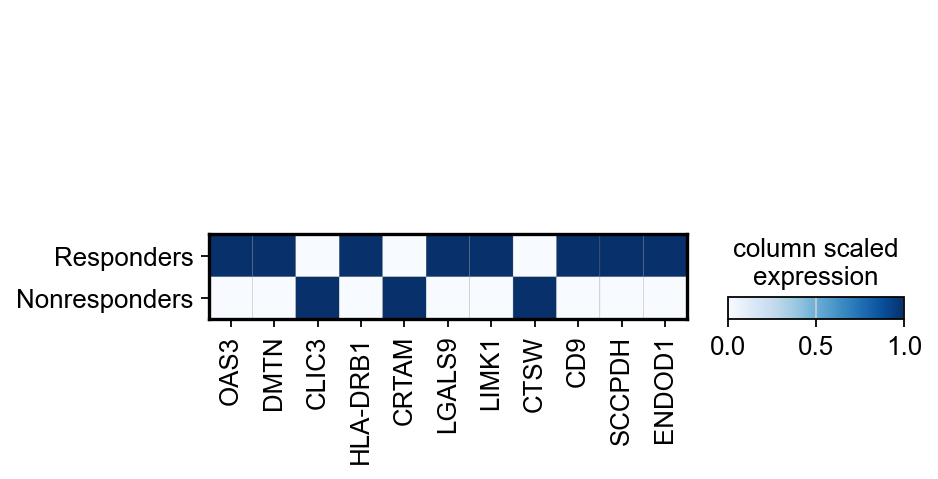

In [71]:
sc.pl.matrixplot(adata_T, [#'CXCL13',
    'OAS3',#'DBN1',
    'DMTN','CLIC3','HLA-DRB1',
                         'CRTAM','LGALS9','LIMK1',
                         'CTSW','CD9','SCCPDH','ENDOD1',#'HECTD2'
], 'response',  cmap='Blues', standard_scale='var', colorbar_title='column scaled\nexpression',
                 #save='__IFN-g_genes.pdf'
                )

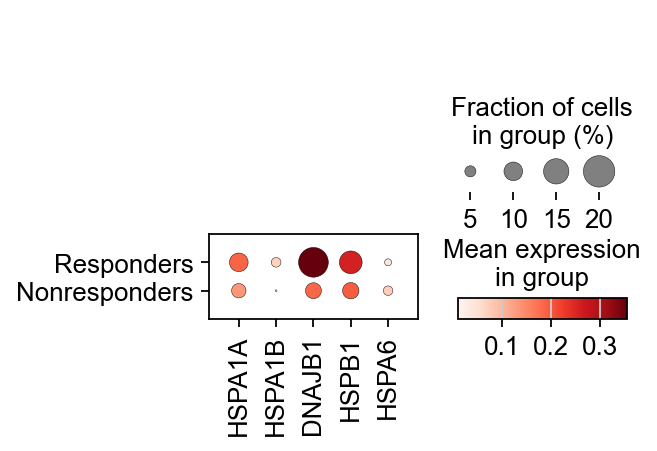

In [72]:
#HSF1 genes
sc.pl.dotplot(adata_T, ["HSPA1A", "HSPA1B", "DNAJB1", "HSPB1",
                         "HSPA6", #"SERPINH1"
                       ], 'response')

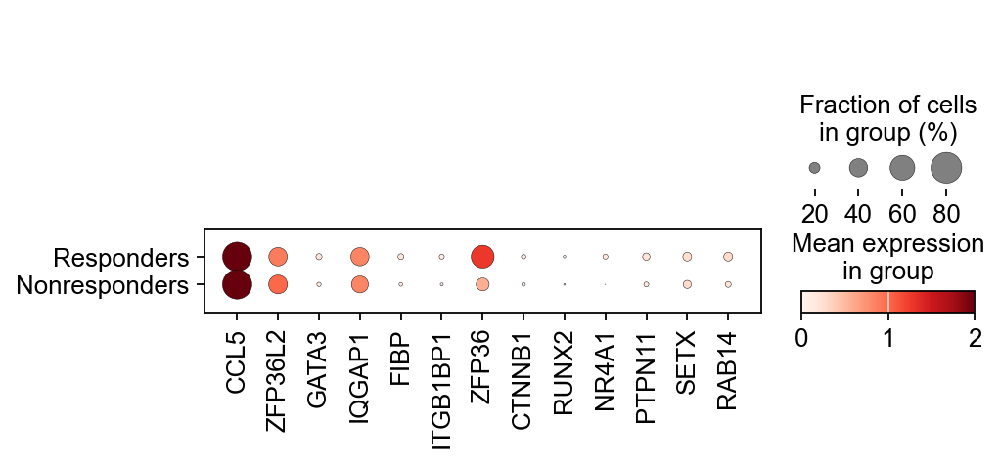

In [73]:
# FGF genes
sc.pl.dotplot(adata_T, FGF_response, 'response',vmin=0, vmax=2,
              # save='_FGF_response_genes.pdf', 
             )

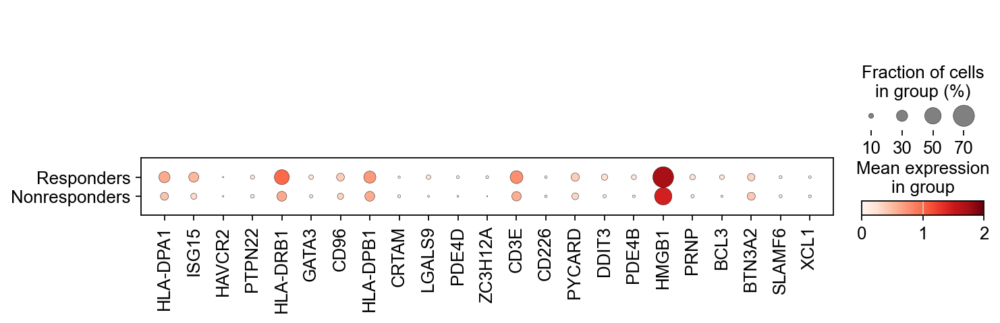

In [74]:
#IFN-g genes
sc.pl.dotplot(adata_T, IFN_G_genes, 'response', vmin=0, vmax=2
              #save='_IFN-g_genes.pdf'
             )

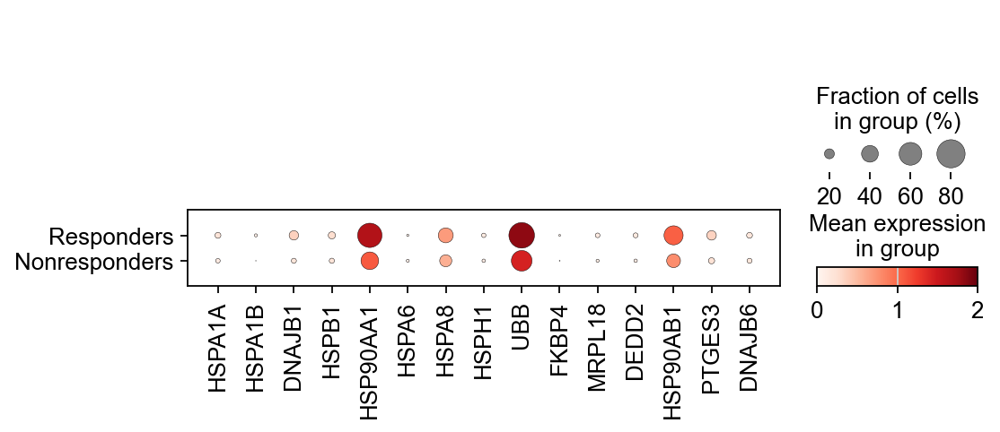

In [75]:
#HSF1 genes
sc.pl.dotplot(adata_T, HSF1_genes, 'response', vmin=0, vmax=2
             )

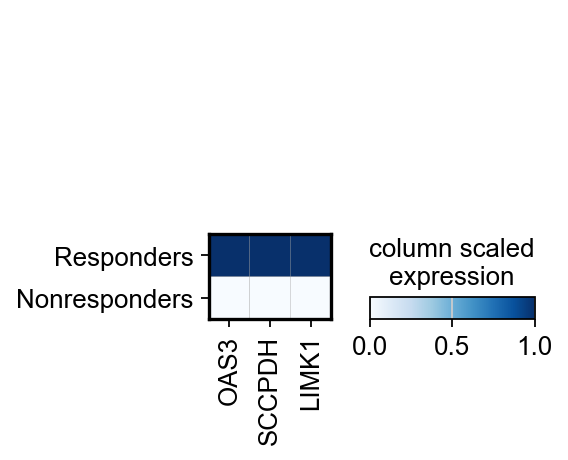

In [10]:
sc.pl.matrixplot(adata_T, ['OAS3', 'SCCPDH', 'LIMK1',
    #'CLIC3','CRTAM',#'CD9',#'DBN1', #'ENDOD1', #'DMTN',#'HECTD2',#'CXCL13',#'HLA-DRB1', #'CTSW','LGALS9',
    ], 'response',  cmap='Blues', standard_scale='var', colorbar_title='column scaled\nexpression', save='_OAS3,SCCPDH,LIMK1_in_Tcell_PBMC-R,NR.pdf')

In [11]:
sc.tl.rank_genes_groups(adata_T, 'response', method='t-test')

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:03)


In [12]:
result = adata_T.uns['rank_genes_groups']
groups = result['names'].dtype.names
pval_table = pd.DataFrame(
            {group + '_' + key[:2]: result[key][group]
            for group in groups for key in ['names', 'pvals_adj']})
pval_table

,Responders_na,Responders_pv,Nonresponders_na,Nonresponders_pv
0,MT2A,0.000000e+00,CSF3R,3.099685e-39
1,MT1E,0.000000e+00,FCGR3B,1.868145e-36
2,MT1X,0.000000e+00,KLRD1,1.799981e-32
3,BEST1,6.603879e-259,PRF1,7.537910e-32
4,KRAS,1.163384e-198,CYP4F3,1.734568e-28
...,...,...,...,...
11404,CYP4F3,1.734568e-28,KRAS,1.163384e-198
11405,PRF1,7.537910e-32,BEST1,6.603879e-259
11406,KLRD1,1.799981e-32,MT1X,0.000000e+00
11407,FCGR3B,1.868145e-36,MT1E,0.000000e+00


In [13]:
pval_table.loc[pval_table['Responders_na'].isin(['MS4A6A','SNRPD3','OAS3','SCCPDH','LIMK1'])]

,Responders_na,Responders_pv,Nonresponders_na,Nonresponders_pv
911,SNRPD3,0.000001,LINC00847,0.374273
978,OAS3,0.000003,KIF16B,0.409572
1172,MS4A6A,0.000016,EFHD2,0.508732
3572,SCCPDH,0.037272,CFAP44,0.747126
5844,LIMK1,0.307487,MAP3K4,0.251351


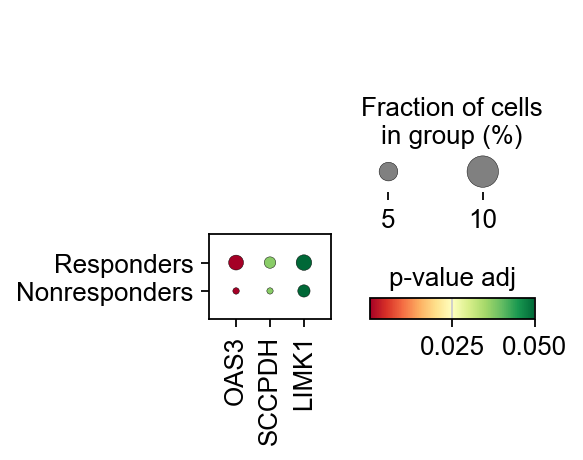

In [15]:
markers = ['OAS3','SCCPDH','LIMK1']
sc.pl.rank_genes_groups_dotplot(adata_T, var_names= markers, values_to_plot='pvals_adj', key='rank_genes_groups',vmax=0.05,
                                dendrogram=False,color_map='RdYlGn', save='_OAS3_SCCPDH_LIMK1_pval_in_Tcell_PBMC-R,NR.pdf')

In [16]:
sc.settings.set_figure_params(dpi=80,dpi_save=300, facecolor='white', format='tif')

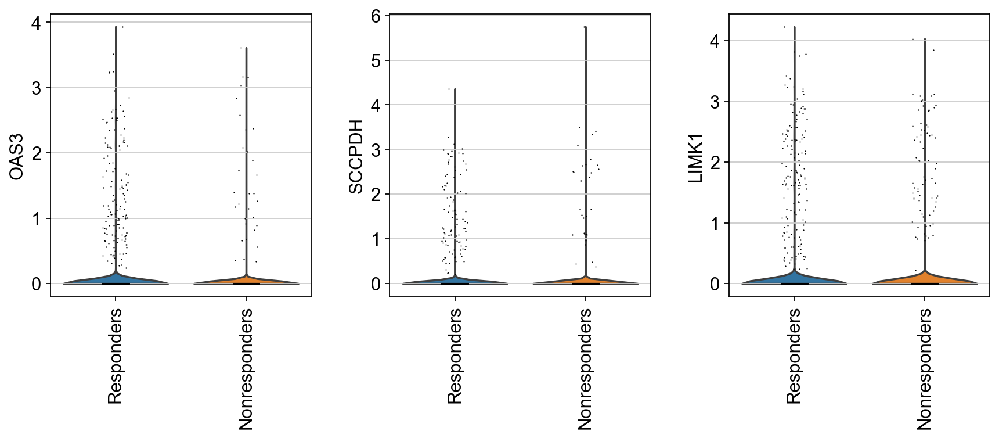

In [17]:
sc.pl.violin(adata_T, keys=['OAS3','SCCPDH','LIMK1'], groupby='response',
    rotation=90, save='_OAS3_SCCPDH_LIMK1_in_IM_Non-IM.tif')